In [102]:
%%HTML
<style>
    /* style for presentation only */
    .reveal .rendered_html table { font-size: 24px }
    /* centre images */
    .reveal .rendered_html img {
        display: table-cell;
        text-align: center;
        vertical-align: middle;
        horizontal-align: middle;
        margin-left: auto;
        margin-right: auto;
    }
</style> 

In [103]:
from IPython.display import Image, HTML

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 
warnings.filterwarnings("ignore", category=FutureWarning)

from matplotlib import pyplot as plt
plt.rcParams.update({'figure.max_open_warning': 0})
graph_figsize = (10,6)                    # I'm forgetful and lazy
plt.rcParams.update({'figure.figsize': graph_figsize})

%matplotlib nbagg
                                          # Jupyter Magics!
import geopandas as gp
import urllib.request
import zipfile
from pathlib import Path
import pandas as pd
import numpy as np
import seaborn as sns
from itertools import chain
from collections import defaultdict, Counter
            
import moviepy.editor as mpy
import moviepy.video as mpyv

import matplotlib.animation as animation
import plotly.plotly as py
from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import plotly.io as pio
import sys
pio.orca.config.executable=str(Path(sys.executable).parent/'orca')
from datetime import datetime
init_notebook_mode(connected=False)
import cufflinks
import colorlover as cl

from bs4 import BeautifulSoup
import requests
from tqdm import tqdm_notebook as tqdm

from ckanapi import RemoteCKAN # it's on pip

def build_odni_connection():
    """Be nice to OpenDataNI and tell them how old I am. (And that it's me)"""
    version_no = (pd.to_datetime('now') -
    pd.to_datetime('1988/05/17')).days/365
    ua = f'@Bolster/{version_no:.2f} (+http://bolster.online/)'
    return RemoteCKAN('https://www.opendatani.gov.uk/', user_agent=ua)

reference = pd.read_hdf('data.h5','reference')
available = pd.read_hdf('data.h5','available')
enrolment = pd.read_hdf('data.h5','enrolment')
fsm = pd.read_hdf('data.h5','fsm')

# Idiots Guide to (Open) Data Science

Andrew Bolster 
* [bolster.online](https://bolster.online)
* Tweets [@bolster](https://twitter.bolster.online)
* GitHubs at [andrewbolster](https://github.com/andrewbolster)
* Works at [AlertLogic](https://alertlogic.com) **We're hiring Threat/Exploit Researchers** (Placements also available)
* Plays at [Farset Labs](https://www.farsetlabs.org.uk)
* **[THIS NOTEBOOK IS AT present.bolster.online](http://present.bolster.online)**
* [Also available in source at presentgh.bolster.online](http://presentgh.bolster.online)

## What is Data Science?
* "Deriving actionable business and operational insights from multi-modal data sources"

* AKA: "Turning Numbers into Other Numbers, and occasionally pretty graphs"

![](img/decline.png)

## Data Science in Northern Ireland
![](img/dozens.gif)

### Vibrant Corporate Ecosystem

* [Analytics Engines](http://www.analyticsengines.com/)
* [AquaQ Analytics](https://www.aquaq.co.uk/)
* [**AlertLogic**😜](https://alertlogic.com)
* [Kainos](https://www.kainos.com/)
* [Flexera|BDNA](https://www.bdna.com/category/flexera/)
* [First Derivitives](https://www.firstderivatives.com/)
* [Neueda](http://www.neueda.com/)
* [Sensum](https://sensum.co/)
* [BrainwaveBank](https://www.brainwavebank.com/)
* Many Many _Many_ More

### Open Source / Meetup Ecosystem too
***Hint: If you really want to learn data science, go to/get involved in some of these***

* [IoT Belfast](https://www.meetup.com/IOTBelfast/)
* [IoT Alliance](https://www.meetup.com/Belfast-New-Technology-Meetup/)
* [PyBelfast](https://www.meetup.com/PyBelfast/)
* [Code Co-op NI](https://www.meetup.com/CodeCoop-NI/)
* [Data Art Belfast](https://www.meetup.com/Data-Art-Belfast/)
* [Big Data Belfast Breakout](https://www.meetup.com/Big-Data-Belfast-Breakout/)
* [Women Who Code Belfast](https://www.meetup.com/Women-Who-Code-Belfast/)
* [Docker Belfast](https://www.meetup.com/Docker-Belfast/)
* [DevOps Belfast](https://www.meetup.com/DevOps-Belfast/)
* [DevSecOps Belfast](https://www.meetup.com/devsecops-belfast/)


***Hint the Second: These are the _best_ ways to get a job in the field***

### Engaged local Government/ComVol support

* [OpenData NI](https://www.opendatani.gov.uk/)
* [DetailData](http://data.nicva.org/)
* [Code4Good](https://wedonthaveasiteyet.lol)
* [DoF Open Data Advisory Board]()


### NI Data Science on the world stage

* [Big Data Belfast Conference](http://www.bigdatabelfast.com/)
* [ODCamp](http://odcamp.co.uk/)
* [TIMON Hackathon](https://www.eventbrite.co.uk/e/timon-open-transport-hackathon-tickets-40149226417#)

# What is Open Data?

> Open data and content can be freely used, modified, and shared by anyone for any purpose - [The Open Definition](https://opendefinition.org/)

> Open data is the idea that some data should be freely available to everyone to use and republish as they wish, without restrictions from copyright, patents or other mechanisms of control. - [Wikipedia](https://en.wikipedia.org/wiki/Open_data)

> Open data is data that’s available to everyone to access, use and share. Yep, even your nan.- [The Open Data Institute](https://theodi.org/article/what-is-open-data-and-why-should-we-care/)

## Key Principles of Open Data

* Open
* Accessible
* Available
* Understandable
* Traceable

## What's the point?

(Following slides stolen shamelessly but with attribution from [The ODI](https://theodi.org/article/what-is-open-data-and-why-should-we-care/), because they're awesome

![](img/odi_perm.png)


### Open data should be easy to access. Especially for your nan.

> Open data is only useful if it’s shared in ways that people can actually understand. **It needs to be shared in a standardised format and easily traced back to where it came from.**

![](img/homer.webp)

### Open data isn’t the same as big data, but big data can be open data too

> When people talk about ‘big data’ they mean a lot of data. Obviously. But ‘big data’, like government statistics on health care, is often closed to the public (or expensive to access, like the terrifyingly-named TWITTER FIREHOSE). **Opening up big data lets people use it to spot trends, fill gaps and improve services.**

![](img/data.jpg)

### Oh, and it’s also not the same as ‘shared data’

> If you’re worried about big companies being fed all your private details, that’s got nothing to do with open data. Groups sharing information with each other is different from opening it up for all to access. **Your private data should only be open if you choose to share it.** (But if you want to know who’s accessing or sharing your data, open data can help.)

![](img/rugrats.gif)

### Open data is good for democracy

>If citizens know about their governments they can hold leaders to account, make more informed decisions and demand better services. **Open data can also help governments stay on their toes and make better policies for society, the economy and the environment.**

![](img/vote.webp)

### Open data can help fight crime
> It’s helped people in London to track [stolen bikes](https://www.nesta.org.uk/blog/check-that-bike-wins-crime-justice-open-data-challenge/) and police in [Vancouver](http://www.cbc.ca/bc/features/vancouver-property-crime-map/) to stay one step ahead of criminals.

![](img/superman.webp)

### Open data is good for your health

> With tools like [FoodTradeMenu](https://www.socialtech.org.uk/projects/food-trade-menu/) using it to help restaurants make sure they don’t serve you food you’re allergic to without realising.

![](img/sneeze.webp)

### Open data can save lives

> It helps groups to [coordinate aid delivery in humanitarian disasters](https://www.sciencedirect.com/science/article/pii/S0740624X13000737).

![](img/aid.jpg)

### Open data helps you get around your city, and saves you money

> Apps like [CityMapper](https://citymapper.com) use open data from groups like Transport for London to help you find the quickest and cheapest way to get from A to B. Even maps can be open, like OpenStreetMap, which powers map data for websites and humanitarian crises relief around the world.

![](img/dr.webp)

<center>__No, NI isn't on CityMapper, woooooooo__</center>

### Open data is actually really pretty

> [Look](https://nats.aero/blog/2014/03/europe-24-air-traffic-data-visualisation/) what happened when NATS used UK radar and European flight plan data to visualise air traffic on a typical summer’s day in 2013.

![https://nats.aero/blog/2014/03/europe-24-air-traffic-data-visualisation/](img/nats.jpg)

## Scales of Data Openness

This is a complex area, if you care, google for ["5 star data"](http://5stardata.info/en/)

TL;DR 
![](img/stars.png)

### And how shit is NI? Cus we're shit at everything right?

![https://index.okfn.org/place/nir/](img/nidata.png)


### NOTBAD.JPG

![](img/notbad.png)

# What is Data Driven Journalism?

> ‘Data journalism’ only differs from ‘words journalism’ in that we use a different kit. We all sniff out, report, and relate stories for a living. It’s like ‘photo journalism’; just swap the camera for a laptop. - Brian Boyer, Chicago Tribune

> [...] providing information and analysis to help inform us all about important issues of the day. - Aron Pilhofer, New York Times

> Using Open Data and Data Science principles to ask, analyse and answer complex or contentious questions or areas of inquiry using available evidence. - Bolster, Here

## What do you what to know?

This is usually the wrong question;

## What do you want to know *more about*?
![](img/google-niedu.png)

## What relevant data is available?
![](img/opendata-fp.png)

![](img/opendata-places.png)

![](img/opendata-pp.png)

## So what do we *think* we have at the moment?

* List of schools with at least council/constitutency locations and postcodes
* Enrolements per school for 2016/17
* Demographic comparisons (R/FSM/SEN 0+ or 5)
* A 'churn' rate (newcomers/movers/immigration)

## What else could we do with?

* More years, ideally same format
    * _What schools have fewer places per/k council pop?_
* Correlations to deprivation
* Correlations to monoculture/political alignment
* Correlations to population *change*
* Correlations to achievement/mobility
* Correlations to claiment count etc.

I *think* we can get most of these... but first things first

# Extraction, Transformation and Loading

* Get the data
* Clean the data
* Store the data

Gov Open Data is notoriously difficult to 'wander around'

## Extraction
When in doubt, bring in `pandas`
![](img/panda.png)

### Easy mode: `read_csv`

In [104]:
import pandas as pd
url_from_odni = "https://www.opendatani.gov.uk/dataset/6058be29-b2e1-4253-bab8-8a018568560a/resource/b4fcfed1-2dc1-4f61-8968-573535522d53/download/school-level-post-primary-reference-data.csv"
pd.read_csv(url_from_odni).head()

,De ref,school name,address 1,town,postcode,school type,management type,constituency,council,rural
0,1210014,Ashfield Girls' High School,397 HOLYWOOD ROAD,BELFAST,BT42LY,Secondary,Controlled,BELFAST EAST,BELFAST,Urban
1,1210015,Ashfield Boys' High School,395 HOLYWOOD ROAD,BELFAST,BT42LY,Secondary,Controlled,BELFAST EAST,BELFAST,Urban
2,1210021,Belfast Model School For Girls,35 DUNOWEN GARDENS,BELFAST,BT146NQ,Secondary,Controlled,BELFAST NORTH,BELFAST,Urban
3,1210022,Belfast Boys' Model School,BALLYSILLAN ROAD,BELFAST,BT146RB,Secondary,Controlled,BELFAST NORTH,BELFAST,Urban
4,1230026,"St Patrick's College, Belfast",619-629 ANTRIM ROAD,BELFAST,BT154DZ,Secondary,Catholic Maintained,BELFAST NORTH,BELFAST,Urban


### Hardmode: API's

In [105]:
from ckanapi import RemoteCKAN # it's on pip
def build_odni_connection():
    """Be nice to OpenDataNI and tell them how old I am. (And that it's me)"""
    version_no = (pd.to_datetime('now') -
    pd.to_datetime('1988/05/17')).days/365
    ua = f'@Bolster/{version_no:.2f} (+http://bolster.online/)'
    return RemoteCKAN('https://www.opendatani.gov.uk/', user_agent=ua)


In [106]:
odni = build_odni_connection()

odni.action.package_list()

['2011-census-microdata-sample-of-anonymised-records-teaching-file',
 'a26-dualling-lidar',
 'a6-lidar',
 'active-places-ni-sports-facilities-database',
 'activity-centre-ccgbc',
 'adult-bmi-health-survey-northern-ireland',
 'adult-magistrates-defendants-dealt-with',
 'advice-centres',
 'air-quality-monitoring-stations',
 'analysis-of-the-trees-of-belfast',
 'anbc-car-parking',
 'anbc-local-nature-reserves',
 'annual-survey-of-hours-and-earnings',
 'anti-social-behaviour-incidents-recorded-by-the-police-in-northern-ireland',
 'antrim-and-newtownabbey-borough-council-bring-bank-locations',
 'antrim-and-newtownabbey-councillors',
 'antrim-newtownabbey-borough-council-assets',
 'applications-by-position-applied-for-2015-16',
 'applications-by-type-town-and-country',
 'approved-venues-for-civil-ceremonies-in-causeway-coast-and-glens-borough-council-2016',
 'ards-and-north-down-borough-council-car-parks',
 'ards-and-north-down-councillors',
 'areas-of-archaeological-potential',
 'areas-of-o

In [107]:
resource =  'school-census-post-primary'

dfs = {}
for dataset in odni.action.package_show(id=resource)['resources']:
    df  = pd.read_csv(dataset['url'], index_col=False)
    dfs[dataset['name']] = df
print(list(dfs.keys()))

['School Census - post primary - Reference data', 'School Census - post primary - enrolments', 'School Census - post primary - Free School Meal entitlement', 'School Census - post primary - SEN', 'School Census - post Primary - Religion', 'School Census - post - Primary - newcomers']


### Those who ignore history...
There's a problem; We want to know about change over time.

![](img/doe_data_list.png)

[Dept of Ed have this data 2009-18 on their website in Excel format](https://www.education-ni.gov.uk/articles/school-enrolments-school-level-data)

OpenDataNI *do not* 😭

### We must deeeeel weeeth eet

![](img/fine.jpg)

In [108]:
test_data = "https://www.education-ni.gov.uk/sites/default/files/publications/education/School%20level%20-%20post%20primary%20schools%20data%20supp%201718.xls"
pd.read_excel(test_data).head()

,Data are collected annually through the School census exercise.,Unnamed: 1
0,"This takes place in early October, when each s...",NaN
1,"In 2017/18, the school census date was 6th Oct...",NaN
2,Among the information collected are details on...,NaN
3,Statistics produced from the school census exe...,NaN
4,NaN,NaN


![](img/excel_bs.png)

### Common Data Extraction Hellscapes

* Inconsistent naming conventions
* Inconsistent format conventions
* Inconsistent schema conventions
* Inconsistent lexical conventions
* Inconsistent *policy changes*
* Shifting *definitions/classifications*
* Lack of meta-linkage during all of the above changes

### Spot the difference...

* `School%20level%20-%20post%20primary%20schools%20data%20supp%201718.xls`
* `School%20level%20-%20post%20primary%20schools%20data%201617%20supp_0.XLS`

* order of fields (`supp 1718` vs `201617 supp_0`)
* extra junk (`supp` vs `supp_0`)
* inconstent extensions (`xls` vs `XLS`)

### Web Crawling to the rescue!

![](img/doe_data_list.png)

In [109]:
# See ETL.ipynb for this 
def get_year_files_for_enrolement_data(dest_base_dir):
    base_url = "https://www.education-ni.gov.uk"
    year_files = defaultdict(list)
    listing_path = "/articles/school-enrolments-school-level-data"
    soup = BeautifulSoup(requests.get(base_url+listing_path).text, 'lxml')
    for link in tqdm(soup.find_all('a'),
                     desc='years',
                     leave=False
                    ):
        if 'School enrolments - school level data 20' in ' '.join(map(str, link.contents)):
            year = link.get('href')[-6:-2]
            # Follow year and get all the relevant files
            year_soup = BeautifulSoup(
                requests.get(base_url+link.get('href')).text,
                'lxml'
            )
            for link in tqdm(year_soup.find_all('a'), 
                             desc=f'files in {year}',
                             leave=False
                            ):
                year_dir = dest_base_dir.joinpath(str(year))
                year_dir.mkdir(parents=True, exist_ok=True)
                href = link.get('href', "")
                filename = href.split('/')[-1]
                contents = ' '.join(map(str, link.contents))
                if 'xls' in href.split('.')[-1].lower():
                    # See this requirement right 👆
                    # Mix of xls, XLSX, xlsx and XLS
                    dest_file = year_dir/filename
                    if not dest_file.exists():
                        urllib.request.urlretrieve(
                            href, dest_file
                        )
                    year_files[year].append(filename)

    return year_files

dest = Path('./data/education-ni/')
year_files = get_year_files_for_enrolement_data(dest)
year_files

defaultdict(list,
            {'2017': ['School%20level%20-%20nursery%20schools%20data%201718%20supp.xlsx',
              'School%20level%20-%20post%20primary%20schools%20data%20supp%201718.xls',
              'School%20level%20-%20primary%20schools%20data%20supp%201718.xlsx',
              'School%20level%20-%20pre%20school%20data%201718%20supp.xlsx',
              'available%20places%20-%20primary%201718%20supp.xlsx',
              'available%20places%20-%20post-primary%201718%20supp.xlsx',
              'available%20places%20-%20nursery%201718%20supp.xlsx',
              'School%20level%20-%20special%20school%20data%202017-18_0.xlsx'],
             '2016': ['School%20level%20-%20nursery%20schools%20data%201617%20supp.XLS',
              'School%20level%20-%20post%20primary%20schools%20data%201617%20supp_0.XLS',
              'School%20level%20-%20primary%20schools%20data%201617%20supp.XLSX',
              'School%20level%20-%20pre%20school%20data%201617%20supp.XLSX',
              '

![](img/yey_laura.webp)

## Transformation

We've technically 'Extracted' the data we wanted from the source,

Clean and twist the data until it's useful

This is the most frustrating part of being a data scientist/engineer...

![](img/frustrated.webp)

### Quick inspection of filename 'conventions'

In [110]:
for year, filenames in year_files.items():
    for file in filenames:
        print(f"{year}:/{file}")

2017:/School%20level%20-%20nursery%20schools%20data%201718%20supp.xlsx
2017:/School%20level%20-%20post%20primary%20schools%20data%20supp%201718.xls
2017:/School%20level%20-%20primary%20schools%20data%20supp%201718.xlsx
2017:/School%20level%20-%20pre%20school%20data%201718%20supp.xlsx
2017:/available%20places%20-%20primary%201718%20supp.xlsx
2017:/available%20places%20-%20post-primary%201718%20supp.xlsx
2017:/available%20places%20-%20nursery%201718%20supp.xlsx
2017:/School%20level%20-%20special%20school%20data%202017-18_0.xlsx
2016:/School%20level%20-%20nursery%20schools%20data%201617%20supp.XLS
2016:/School%20level%20-%20post%20primary%20schools%20data%201617%20supp_0.XLS
2016:/School%20level%20-%20primary%20schools%20data%201617%20supp.XLSX
2016:/School%20level%20-%20pre%20school%20data%201617%20supp.XLSX
2016:/School%20level%20-%20special_school_data%201617%20supp_0.XLSX
2016:/available%20places%20-%20primary%201617%20supp.XLSX
2016:/available%20places%20-%20post-primary%201617%20sup

### Zero in on just post-primary data

In [111]:
for year, filenames in year_files.items():
    for file in filenames:
        if 'post' in file:
            print(f"{year}:/{file}")

2017:/School%20level%20-%20post%20primary%20schools%20data%20supp%201718.xls
2017:/available%20places%20-%20post-primary%201718%20supp.xlsx
2016:/School%20level%20-%20post%20primary%20schools%20data%201617%20supp_0.XLS
2016:/available%20places%20-%20post-primary%201617%20supp.XLSX
2015:/School-level-post-primary-schools-data-1516_1.XLS
2014:/post-primary-schools-data-1415-supp-with-unfilled-places.xlsx
2013:/post-primary-schools-data-13-14-supp-inc-unfilled-places.xlsx
2012:/post-primary-schools-data-2012-13-supp-inc-unfilled-places.xlsx
2011:/post-primary-schools-data-11-12-supp-inc-unfilled-2.xlsx
2010:/post-primary-schools-data-10-11-supp-inc-unfilled.xlsx
2009:/post-primary-schools-data-0910-supp-2.xlsx


### Don't try and tackle it all at once

Right, lets limit our scope to look at places available to get a better understanding of the data

In [112]:
for year, filenames in year_files.items():
    print(f"Year: {year}")
    for file in filenames:
        if file.lower().startswith('available'):   
            print(file)

Year: 2017
available%20places%20-%20primary%201718%20supp.xlsx
available%20places%20-%20post-primary%201718%20supp.xlsx
available%20places%20-%20nursery%201718%20supp.xlsx
Year: 2016
available%20places%20-%20primary%201617%20supp.XLSX
available%20places%20-%20post-primary%201617%20supp.XLSX
available%20places%20-%20nursery%201617%20supp%20final.XLSX
Year: 2015
Year: 2014
Year: 2013
Year: 2012
Year: 2011
Year: 2010
Year: 2009


![](img/available_2016.png)

![](img/available_2015.png)

### Try and identify subclasses of datasets that may be tackled automagically

Ok, what about actually parsing the excel sheets? 

Will *they* be consistent?

In [113]:
sheets = defaultdict(list)
for year, files in year_files.items():
    for file in files:
        if 'post' in file:
            xls = pd.ExcelFile(f'data/education-ni/{year}/{file}')
            sheets[year].extend(xls.sheet_names)
dict(sheets)

{'2017': ['meta data',
  'reference data',
  'enrolments',
  'free school meals',
  'SEN',
  'religion',
  'newcomers',
  'School level data',
  'Overall'],
 '2016': ['meta data',
  'reference data',
  'enrolments',
  'free school meals',
  'SEN',
  'religion',
  'newcomers',
  'School level data',
  'Overall'],
 '2015': ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'religion',
  'newcomers',
  'unfilled places'],
 '2014': ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'religion',
  'newcomers',
  'unfilled places'],
 '2013': ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'unfilled places'],
 '2012': ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'unfilled places'],
 '2011': ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'unfilled places'],
 '2

In [114]:
all_sheet_names = Counter([_ for d in sheets.values() for _ in d])
df = pd.DataFrame.from_dict({
    year: [sn in sheet_names for sn in all_sheet_names] 
    for year, sheet_names in sheets.items()
}, orient='index')
df.columns=all_sheet_names.keys()
df.T

,2017,2016,2015,2014,2013,2012,2011,2010,2009
meta data,True,True,True,True,True,True,True,True,True
reference data,True,True,True,True,True,True,True,True,True
enrolments,True,True,True,True,True,True,True,True,True
free school meals,True,True,True,True,True,True,True,True,True
SEN,True,True,True,True,True,True,True,True,True
religion,True,True,True,True,False,False,False,False,False
newcomers,True,True,True,True,False,False,False,False,False
School level data,True,True,False,False,False,False,False,False,False
Overall,True,True,False,False,False,False,False,False,False
gender,False,False,True,True,True,True,True,True,True


### Visualisation isn't just for output data...
Use visualisation tools to validate your transformation assumptions...

All. The. Time.

<IPython.core.display.Javascript object>


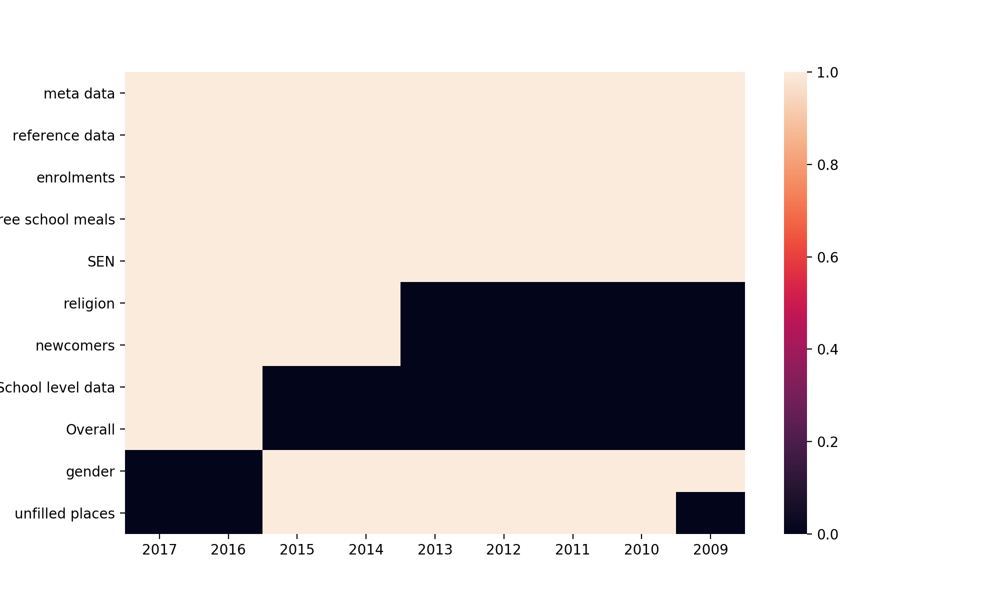

In [115]:
import seaborn as sns
f,ax = plt.subplots(figsize=graph_figsize)
sns.heatmap(df.T, ax=ax)

![](img/ahhfuck.webp)

![](img/2000.png)

## A few highlights from the hellscape
### Best thing about standards is how many there are to choose from...
 
![](img/reference_year.png)

### Sometimes understanding the data is more painful (and ugly) than expected
This was the only document that seemed to explain what 'supernumerary' actually means
![](img/comic_sans.png)

It means 'extra'...

### Using multiple tools simultanously can be problematic...
Excel on Mac helpfully puts down a lock-entry on open excel files which prevent it from being opened by other things. 

Pandas occasionally has unhelpful error messages in this regard

![](img/geethanks.png)

### Sometimes you have to give up on stuff because it's too dangerous an area to walk in to.

Special Educational Needs classification policy is >>100pg policy that appears to change every year.

I am not an expert on education policy so I'm not sticking my foot in that one without being sure I understand the implications.

It's your responsibility as a Data Science to be able to make that call, and know your limits.

### "Machine Readable"

![](img/machinereadable.jpg)

![](img/starman.png)

<img src="img/hashs.png", width="90%"/>

<img src="img/multirow.png" width="70%"/>

![](img/footer.png)

In [116]:
def parse_reference_table(xls):
    """
    From an ExcelFile, clean up:
    * School Mgmt Type disaster
    * Inconsistent header depth
    * Multi-row header names
    * inconsistent headers (ref_key_map)
    * inconsistent col order
    * inconsistent caps/spacing (strip|lower)
    """
    cols= [
        'de ref',
        'school name',
        'school type',
        'address 1',
        'postcode',
        'urban_rural',
        'school management type',
        'district council',
        'parliamentary constituency',
        'town'
    ]
    
    categories = [
        'school type',
        'urban_rural',
        'school management type',
        'district council',
        'parliamentary constituency',
        'town'
    ]

    ref_key_map={
        'denino':'de ref',
        'urban/ rural': 'urban_rural',
        'schoolname': 'school name'
    }
    
    reference_value_rename = {
        'school management type':{
             'gmi':'integrated',
             'controlled integrated':'integrated',
             'roman catholic maintained':'rc maintained',
             'grant maintained integrated':'integrated',
             'voluntary - other managed':'voluntary',
             'voluntary - rc managed':'voluntary',
             'catholic maintained':'rc maintained'
        }
    }
    join_n_strip_n_lower = lambda l: ' '.join(l).strip().lower()
    
    if 'reference data' in xls.sheet_names:
        df = pd.read_excel(xls, 'reference data', header=None)
        h_range = 2 if isinstance(df.ix[3,0], int) else 3
        try:
            df.columns=df.ix[1:h_range].fillna('').apply(join_n_strip_n_lower, axis=0).values
            df.rename(columns=ref_key_map, inplace=True)
            df = df.drop(df.index[0:h_range+1]).reset_index(drop=True)
            df = df[cols]
            df['de ref'] = df['de ref'].astype(int)
            df.set_index('de ref', inplace=True)
            for c in df:
                 df[c]=df[c].str.lower().str.strip()            
            df.replace(reference_value_rename, inplace=True)
            for c in categories:
                df[c].fillna('NA', inplace=True)
                df[c] = df[c].astype('category')
        except TypeError as e:
            print(e)
    else:
        df=None
    return df

def parse_enrolments_table(xls):
    """From an ExcelFile, clean up:
    * Inconsistent header depth
    * fucked up nans/nulls all over the place
    * inconsistent *footer* depth...
    * Set de ref as join index and drop pointless fields
    """
    def join_n_strip_n_lower(l): return ' '.join(l).strip().lower()

    def strip_n_lower(s): return s.strip().lower()

    def unyearify(s): return int(s.replace('year ', ''))

    if 'enrolments' in xls.sheet_names:
        df = pd.read_excel(xls, 'enrolments', header=None, skip_footer=5)
        h_range = 2 if isinstance(df.ix[3, 0], int) else 3
        try:
            df.columns = df.ix[3].fillna('').apply(strip_n_lower).values
            df = df.drop(df.index[0:h_range+1]).reset_index(drop=True)
            df.dropna(how='all', inplace=True, axis=0)
            df['de ref'] = df['de ref'].astype(int)
            df.drop('schoolname', axis=1, inplace=True)
            df.drop('total pupils', axis=1, inplace=True)
            df.set_index('de ref', inplace=True)
            df.rename(columns=unyearify, inplace=True)
            df = df.astype(float)
        except TypeError as e:
            print(e)
    else:
        df = None
    return df

def parse_fsm_table(xls):
    """From an ExcelFile, clean up:
    * Inconsistent header depth
    * fucked up nans/nulls all over the place
    * inconsistent *footer* depth...
    * Set de ref as join index and drop pointless fields
    """
    join_n_strip_n_lower = lambda l: ' '.join(l).strip().lower()
    strip_n_lower = lambda s: s.strip().lower()
    unyearify = lambda s: int(s.replace('year ',''))
    
    if 'free school meals' in xls.sheet_names:
        df = pd.read_excel(xls, 'free school meals', header=None, skip_footer=5)
        h_range = 2 if isinstance(df.ix[3,0], int) else 3
        try:
            df.columns=df.ix[3].fillna('').apply(strip_n_lower).values
            df = df.drop(df.index[0:h_range+1]).reset_index(drop=True)
            df.dropna(how='all', inplace=True, axis=0)
            df['de ref'] = df['de ref'].astype(int)
            df.drop('schoolname',axis=1, inplace=True)
            df.drop('free school meals', axis=1, inplace=True)
            df.set_index('de ref', inplace=True)
            df.replace('#',pd.np.nan, inplace=True) # # = Undisclosed
            df.replace('*',2.0, inplace=True) # * == < 5
            df.replace('!',1, inplace=True) # ! avoid identification, so it's prob one or two
            
            df=df.astype(float)
        except TypeError as e:
            print(e)
    else:
        df=None
    return df

def parse_available_table(xls):
    """From an ExcelFile, clean up:
    * Inconsistent header depth
    * fucked up nans/nulls all over the place
    * inconsistent *footer* depth...
    * Set de ref as join index and drop pointless fields
    * Totally different schemas between years
    * Inconsistent metric naming
    * non numerical data flags (*/!)
    """
    ref_key_map={
        'schoolname': 'school name',
        'total unfilled places': 'available places',
        'unfilled places': 'available places',
        'total approved enrolment number': 'approved enrolments'
    }
    
    join_n_strip_n_lower = lambda l: ' '.join(l).strip().lower()
    
    if 'School level data' in xls.sheet_names:
        df = pd.read_excel(xls, 'School level data', header=None)
        h_range = 2 if isinstance(df.ix[3,0], int) else 3
    elif 'unfilled places' in xls.sheet_names:
        df = pd.read_excel(xls, 'unfilled places', header=None)
        h_range = 2 if isinstance(df.ix[3,0], int) else 3
    else:
        df=None
        
    if df is not None:
        try:
            df.columns=df.ix[1:h_range].fillna('').apply(join_n_strip_n_lower, axis=0).values
            df.rename(columns=ref_key_map, inplace=True)
            df = df.drop(df.index[0:h_range+1]).reset_index(drop=True)
            df=df.applymap(lambda x: np.nan if isinstance(x, str) and x.isspace() else x)
            df.dropna(how='all', axis=1, inplace=True)
            df.dropna(how='any', axis=0, inplace=True)
            if df.shape[1] == 6: # recent doesn't have fecking headers
                cols = list(df.columns)
                cols[0] = 'de ref'
                cols[1] = 'school name'
                df.columns=cols
            df.drop('school name', axis=1, inplace=True)
            df['de ref'] = df['de ref'].astype(int)
            df.set_index('de ref', inplace=True)
            df.replace('*',2.0, inplace=True) # * == < 5
            df.replace('!',1, inplace=True) # ! avoid identification, so it's prob one or two
            df.dropna(how='all', inplace=True, axis=1)
            df.astype(int, inplace=True)
            

            
        except TypeError as e:
            print(e)

    return df

In [117]:
reference = pd.read_hdf('data.h5','reference')
available = pd.read_hdf('data.h5','available')
enrolment = pd.read_hdf('data.h5','enrolment')
fsm = pd.read_hdf('data.h5','fsm')

# Bring it all together
Panels are 3D Dataframes, i.e. [Year x School x Metric]

* Reference: School name, address, denomination, type, etc.
* Available: Allocated places information
* Enrolment: Actual student numbers
* FSM: Free School Meals: Laziest possible deprivation measure, probably doesn't need to be a panel

# Show me the data

## Line graphs & boxplots & pie charts, Oh My

![](img/ohmy.gif)

In [118]:
enrolment.sum()

year,2009,2010,2011,2012,2013,2014,2015,2016,2017
yeargroup,,,,,,,,,
8,23116.0,23113.0,21770.0,21322.0,21418.0,21367.0,21792.0,22571.0,22817.0
9,23859.0,23403.0,22925.0,21928.0,21425.0,21481.0,21422.0,22284.0,22650.0
10,22954.0,24155.0,23245.0,23101.0,21971.0,21527.0,21443.0,21864.0,22381.0
11,23521.0,23277.0,24094.0,23524.0,23299.0,22092.0,21601.0,22118.0,22102.0
12,23808.0,23656.0,22967.0,24027.0,23353.0,23166.0,21864.0,22091.0,22099.0
13,14912.0,15652.0,15421.0,15892.0,16567.0,16208.0,15912.0,15667.0,15347.0
14,12607.0,13097.0,13274.0,13482.0,13554.0,14174.0,13922.0,13818.0,13149.0
15,100.0,154.0,154.0,196.0,201.0,275.0,365.0,0.0,0.0


In [119]:
enrolment.sum().sum().iplot()

In [120]:
# Stacked Bar Charts are Evil and I hate them. 
enrolment.sum().T.iplot(kind='bar',barmode='stack')

In [121]:
enrolment.axes

[Index(['2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017'], dtype='object', name='year'),
 Int64Index([1210014, 1210015, 1210021, 1210022, 1210266, 1230026, 1230053,
             1230089, 1230104, 1230130,
             ...
             5420059, 5420060, 5420062, 5420073, 5420076, 5420260, 5420263,
             5420268, 5420304, 5420314],
            dtype='int64', name='de ref', length=232),
 Int64Index([8, 9, 10, 11, 12, 13, 14, 15], dtype='int64', name='yeargroup')]

In [122]:
# What is wrong with this "sum" table?
enrolment.sum(axis=2).head()

year,2009,2010,2011,2012,2013,2014,2015,2016,2017
de ref,,,,,,,,,
1210014,672.0,688.0,703.0,708.0,704.0,697.0,704.0,696.0,691.0
1210015,647.0,650.0,649.0,666.0,709.0,737.0,744.0,728.0,740.0
1210021,963.0,929.0,899.0,930.0,916.0,884.0,910.0,954.0,946.0
1210022,907.0,932.0,913.0,930.0,943.0,969.0,968.0,991.0,997.0
1210266,297.0,290.0,264.0,247.0,88.0,0.0,0.0,0.0,0.0


### Skippable aside: Danger Zone
![](img/danger.gif)

__When is a zero not nothing?__

In [123]:
[10]+[np.nan]*9

[10, nan, nan, nan, nan, nan, nan, nan, nan, nan]

In [124]:
sum([10]+[np.nan]*9)

nan

In [125]:
pd.Series([10]+[np.nan]*9).sum()

10.0

In [126]:
pd.Series([10]+[np.nan]*9).mean()

10.0

In [127]:
pd.Series([10]+[0.0]*9).mean()

1.0

In [128]:
pd.Series([np.nan]*10).sum()

0.0

In [129]:
pd.Series([0.0]*10).sum()

0.0

In [130]:
# These 0's are actually sum([np.nan])
# The school was closed in 2014
enrolment.sum(axis=2).head()

year,2009,2010,2011,2012,2013,2014,2015,2016,2017
de ref,,,,,,,,,
1210014,672.0,688.0,703.0,708.0,704.0,697.0,704.0,696.0,691.0
1210015,647.0,650.0,649.0,666.0,709.0,737.0,744.0,728.0,740.0
1210021,963.0,929.0,899.0,930.0,916.0,884.0,910.0,954.0,946.0
1210022,907.0,932.0,913.0,930.0,943.0,969.0,968.0,991.0,997.0
1210266,297.0,290.0,264.0,247.0,88.0,0.0,0.0,0.0,0.0


In [131]:
reference['2013'].loc[1210266]

metric
school name                   orangefield high school
school type                                 secondary
address 1                            cameronian drive
postcode                                       bt56aw
urban_rural                                     urban
school management type                     controlled
district council                              belfast
parliamentary constituency               belfast east
town                                          belfast
Name: 1210266, dtype: object

In [132]:
reference['2014'].loc[1210266]

metric
school name                   NaN
school type                   NaN
address 1                     NaN
postcode                      NaN
urban_rural                   NaN
school management type        NaN
district council              NaN
parliamentary constituency    NaN
town                          NaN
Name: 1210266, dtype: object

In [133]:
# It *should* look like this
enrolment.sum(axis=2).head().replace(0.0, np.nan)

year,2009,2010,2011,2012,2013,2014,2015,2016,2017
de ref,,,,,,,,,
1210014,672.0,688.0,703.0,708.0,704.0,697.0,704.0,696.0,691.0
1210015,647.0,650.0,649.0,666.0,709.0,737.0,744.0,728.0,740.0
1210021,963.0,929.0,899.0,930.0,916.0,884.0,910.0,954.0,946.0
1210022,907.0,932.0,913.0,930.0,943.0,969.0,968.0,991.0,997.0
1210266,297.0,290.0,264.0,247.0,88.0,NaN,NaN,NaN,NaN


## AUDIENCE PARTICIPATION

Which of the below is the correct answer to:
    "What is the average number of pupils per school in Northern Ireland from 2009 to 2017?"

In [134]:
#A Sum of years, swap 0 for nan, mean over schools, mean over classes
enrolment.sum(axis=1).replace(0.0, np.nan).mean(axis=1).mean()

17784.386904761905

In [135]:
#B Sum over classes, mean over schools, swap 0 for nan, mean over years
enrolment.sum(axis=2).mean().replace(0.0,np.nan).mean()

613.0569923371647

In [136]:
#C Sum over classes, swap 0.0 for nan, mean over schools, mean over years
enrolment.sum(axis=2).replace(0.0, np.nan).mean().mean()

684.117276952679

## C: Sum over classes, swap 0.0 for nan, mean over schools, mean over years!

But why not B, it's doing the same thing right?

In [137]:
enrolment.sum(axis=2).head()

year,2009,2010,2011,2012,2013,2014,2015,2016,2017
de ref,,,,,,,,,
1210014,672.0,688.0,703.0,708.0,704.0,697.0,704.0,696.0,691.0
1210015,647.0,650.0,649.0,666.0,709.0,737.0,744.0,728.0,740.0
1210021,963.0,929.0,899.0,930.0,916.0,884.0,910.0,954.0,946.0
1210022,907.0,932.0,913.0,930.0,943.0,969.0,968.0,991.0,997.0
1210266,297.0,290.0,264.0,247.0,88.0,0.0,0.0,0.0,0.0


In [138]:
enrolment.sum(axis=2).head().mean().to_frame().T

year,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,697.2,697.8,685.6,696.2,672.0,657.4,665.2,673.8,674.8


In [139]:
enrolment.sum(axis=2).replace(0.0,np.nan).head()

year,2009,2010,2011,2012,2013,2014,2015,2016,2017
de ref,,,,,,,,,
1210014,672.0,688.0,703.0,708.0,704.0,697.0,704.0,696.0,691.0
1210015,647.0,650.0,649.0,666.0,709.0,737.0,744.0,728.0,740.0
1210021,963.0,929.0,899.0,930.0,916.0,884.0,910.0,954.0,946.0
1210022,907.0,932.0,913.0,930.0,943.0,969.0,968.0,991.0,997.0
1210266,297.0,290.0,264.0,247.0,88.0,NaN,NaN,NaN,NaN


In [140]:
enrolment.sum(axis=2).replace(0.0,np.nan).mean().to_frame().T

year,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,670.726852,678.273148,675.352113,673.577465,681.673077,681.019417,691.605,698.572139,706.256281


It's your responsibility as a Data Scientist to understand what questions your algorithms are *really* answering, and make sure that the people who may be answering those question are *crystal clear* about what your data means.

Data Science is as much about comprehension and communication as it is about statistics and programming.

### Return of regular schedule - What happened to average cohort sizes in 2015?

In [141]:
enrolment.mean(axis=2).mean().iplot(title='Annual Average Cohort (school/class/year)')

In [142]:
enrolment.mean(axis=2).T.iplot(title='Annual Average Cohort (school/class/year) per school', legend=False)

In [143]:
annual_school_enrolment = enrolment.sum(axis=2).T
annual_school_enrolment.head()

de ref,1210014,1210015,1210021,1210022,1210266,1230026,1230053,1230089,1230104,1230130,...,5420059,5420060,5420062,5420073,5420076,5420260,5420263,5420268,5420304,5420314
year,,,,,,,,,,,,,,,,,,,,,
2009,672.0,647.0,963.0,907.0,297.0,784.0,1547.0,691.0,438.0,468.0,...,880.0,861.0,919.0,527.0,836.0,646.0,0.0,0.0,0.0,0.0
2010,688.0,650.0,929.0,932.0,290.0,785.0,1530.0,687.0,429.0,440.0,...,887.0,861.0,940.0,555.0,846.0,658.0,682.0,803.0,0.0,0.0
2011,703.0,649.0,899.0,913.0,264.0,764.0,1530.0,690.0,384.0,406.0,...,894.0,864.0,942.0,579.0,845.0,665.0,0.0,0.0,0.0,0.0
2012,708.0,666.0,930.0,930.0,247.0,765.0,1521.0,692.0,367.0,388.0,...,907.0,861.0,920.0,604.0,849.0,652.0,706.0,0.0,0.0,0.0
2013,704.0,709.0,916.0,943.0,88.0,705.0,1516.0,684.0,423.0,352.0,...,900.0,858.0,900.0,635.0,855.0,653.0,712.0,0.0,0.0,0.0


In [144]:
annual_school_enrolment.iplot(legend=False, title="Annual Enroled Students per school")

In [145]:
first = annual_school_enrolment.replace(0.0,np.nan)\
    .apply(pd.Series.first_valid_index).astype(int).replace(2009,np.nan)
last = annual_school_enrolment.replace(0.0,np.nan)\
    .apply(pd.Series.last_valid_index).astype(int).replace(2017,np.nan)

close_vec=pd.DataFrame({
    'opened':first.groupby(first).size(),
    'closed':last.groupby(last).size()}
)
close_vec

,opened,closed
2009.0,NaN,3.0
2010.0,3.0,2.0
2011.0,1.0,1.0
2012.0,NaN,6.0
2013.0,1.0,3.0
2014.0,1.0,11.0
2015.0,4.0,2.0
2016.0,3.0,5.0
2017.0,3.0,NaN


In [146]:
close_vec.cumsum().fillna(method='ffill').iplot(title="Cumulative number of schools opened/closed since 2009")

## But what does it all mean?

Gather data from other sources to put things in context; 

How many people are in each region?

![](img/pop_cons.png)

In [147]:
# Generated in ETL.ipynb
cons_pop = pd.read_csv('data/cons_pop.csv')
cons_pop['Mid_Year_Ending'] = cons_pop.Mid_Year_Ending.astype(int)
cons_pop['Population_Estimate'] = cons_pop.Population_Estimate.astype(float)
cons_pop['Age'] = cons_pop.Age.astype(int)
cons_pop.rename(columns={'Geo_Name':'constituency'}, inplace=True)
cons_pop['constituency']= cons_pop.constituency.str.strip().str.lower()

cons_pop[
    (cons_pop.Gender == 'All Persons') 
    & (cons_pop.Mid_Year_Ending == 2016)
].head()

,constituency,Geo_Code,Mid_Year_Ending,Gender,Age,Population_Estimate
73710,belfast east,N06000001,2016,All Persons,0,1190.0
73711,belfast east,N06000001,2016,All Persons,1,1206.0
73712,belfast east,N06000001,2016,All Persons,2,1221.0
73713,belfast east,N06000001,2016,All Persons,3,1182.0
73714,belfast east,N06000001,2016,All Persons,4,1227.0


### What's the distribution of ages in NI?

And can anyone tell me what's strange about this graph?

In [148]:
cons_pop[(cons_pop.Gender == 'All Persons') & (cons_pop.Mid_Year_Ending == 2016)]\
    .groupby('Age')['Population_Estimate'].sum().iplot(
        title='Population Distribution (2016)', 
        xTitle="Age", yTitle="Population")

### Constituency breakdown
Stacked bar charts are evil....

In [149]:
cons_pop[(cons_pop.Gender == 'All Persons') & (cons_pop.Mid_Year_Ending == 2016)]\
    .groupby(['Age','constituency'])['Population_Estimate'].sum().unstack().iplot(
        title='Constituency Population Distribution (2016)', 
        xTitle="Age", yTitle="Population", kind='bar', barmode='stack',
        legend=False
    )

### That's not a great way of summarising age distributions....

In [150]:
pop_cumsum = cons_pop[(cons_pop.Gender == 'All Persons') & (cons_pop.Mid_Year_Ending == 2016)]\
    .groupby('Age')['Population_Estimate'].sum().cumsum()
pop_cumsum.iplot(title='Cumulative Population Distribution (2016)',
                     xTitle='Age', yTitle='Population'
                )

In [151]:
cons_pop[(cons_pop.Gender == 'All Persons')].groupby(
    ['Age','Mid_Year_Ending']
)['Population_Estimate'].sum().unstack().cumsum().iplot(
    title='Annual Cumulative Population Distribution',
    xTitle='Age', yTitle='Population'
)

In [152]:
import colorlover as cl
u_years = sorted(cons_pop['Mid_Year_Ending'].unique())
crange=cl.interp(cl.scales['6']['div']['RdYlGn'], len(u_years))
cmap = dict(zip(u_years,crange))
HTML(cl.to_html(crange))

In [153]:
cons_pop[(cons_pop.Gender == 'All Persons')].groupby(
    ['Age','Mid_Year_Ending']
)['Population_Estimate'].sum().unstack().cumsum().iplot(
    color=cmap, title='Annual Cumulative Population Distribution',
    xTitle='Age', yTitle='Population',
)

In [154]:
def constituency_age_profile(constituency):
    cons_pop[(cons_pop.Gender == 'All Persons') & (cons_pop.constituency == constituency)].groupby(
        ['Age','Mid_Year_Ending']
    )['Population_Estimate'].sum().unstack().cumsum().iplot(
        color=cmap, xTitle='Age', yTitle='Population',
        title=f'Annual Cumulative Population Distribution: {constituency.title()}'
    )

### South Belfast: Kinky Constituency

In [155]:
constituency_age_profile('belfast south')

### Newry and Armagh: Middle Age Mourneing

In [156]:
constituency_age_profile('newry and armagh')

### Foyled Again: Cross-generational Brain Drain

In [157]:
constituency_age_profile('foyle')

### North Antrim: 40 is the new 30

In [158]:
constituency_age_profile('north antrim')

### Growing Up in the (Lagan) Valley

In [159]:
constituency_age_profile('lagan valley')

### Fast times at Belfast Unis/Colleges

In [160]:
df = cons_pop[(cons_pop.Gender == 'All Persons') \
                      & (cons_pop.Mid_Year_Ending == 2016)]\
.groupby(['Age','constituency'])['Population_Estimate'].sum().unstack()
df.iplot(legend=False, title='Population Distribution per Constituency')

In [161]:
df.iplot(kind='heatmap', colorscale='-YlOrRd', 
         margin=(200,0,0,30),orientation='h', title='Population per age per consitituency')

In [162]:
def colnorm(df):
    return (df-df.min())/(df.max()-df.min())
colnorm(df).iplot(title='Scaled Population Distribution per Constituency', legend=False)

In [163]:
colnorm(df).iplot(kind='heatmap', colorscale='-YlOrRd',
         margin=(200,0,0,30),orientation='h', title='Scaled Population per age per consitituency')

In [164]:
def flatten_ages(s):
    return np.asarray(
        list(chain.from_iterable(
            ([age]*int(n) for age,n in s.iteritems())
        ))
    )

def get_age_quantiles(df, q=[0.25,0.5,0.75]):
    pop_sum=df.groupby('Age')['Population_Estimate'].sum()
    age_quartiles = np.quantile(flatten_ages(pop_sum),q)
    return pd.Series(dict(zip(q,age_quartiles)))

In [165]:
annual_cons_quartiles = cons_pop[(cons_pop.Gender == "All Persons")].groupby(["Mid_Year_Ending","constituency"]).apply(get_age_quantiles)
annual_quartiles = cons_pop[(cons_pop.Gender == "All Persons")].groupby("Mid_Year_Ending").apply(get_age_quantiles)

# How has the average age changed over time?
No Major outliers here. 

In [166]:
annual_cons_quartiles[0.5].unstack("constituency").iplot()

# Which age quartile is the most populous?
Use the province wide quartiles to see if a constituency is weighted older/younger

In [167]:
annual_quartiles.loc[2006].values

array([18., 36., 54.])

In [168]:
def get_winning_quartile(df, age_quartiles):
    age_counts = df.groupby("Age")['Population_Estimate'].sum()
    quartile_counts = pd.Series({
        f"{lower}-{upper}":age_counts.loc[lower:upper].sum()
        for lower,upper in zip([0]+list(age_quartiles), list(age_quartiles)+[99])
    })
    return quartile_counts.idxmax()

annual_top_quartiles = cons_pop[(cons_pop.Gender == "All Persons") & (cons_pop.Mid_Year_Ending==2016)]\
    .groupby("constituency").apply(get_winning_quartile, age_quartiles=annual_quartiles.loc[2006].values) 
annual_top_quartiles

constituency
belfast east                    54.0-99
belfast north                   54.0-99
belfast south                 18.0-36.0
belfast west                     0-18.0
east antrim                     54.0-99
east londonderry                54.0-99
fermanagh and south tyrone      54.0-99
foyle                            0-18.0
lagan valley                    54.0-99
mid ulster                       0-18.0
newry and armagh                 0-18.0
north antrim                    54.0-99
north down                      54.0-99
south antrim                    54.0-99
south down                      54.0-99
strangford                      54.0-99
upper bann                      54.0-99
west tyrone                     54.0-99
dtype: object

## Mapping

This is all very interesting, but not very engaging for non-norn-irons...

In [169]:
cons_gdf_shp = "OSNI_Open_Data_Largescale_Boundaries__Parliamentary_Constituencies_2008.shp"
cons_gdf=gp.GeoDataFrame.from_file('data/'+cons_gdf_shp)
cons_gdf.rename(columns={'PC_NAME':'constituency'}, inplace=True)
cons_gdf.drop(['OBJECTID','PC_ID'], axis=1, inplace=True)
cons_gdf['constituency'] = cons_gdf['constituency'].str.lower().str.strip()
cons_gdf.set_index('constituency', inplace=True)

<IPython.core.display.Javascript object>


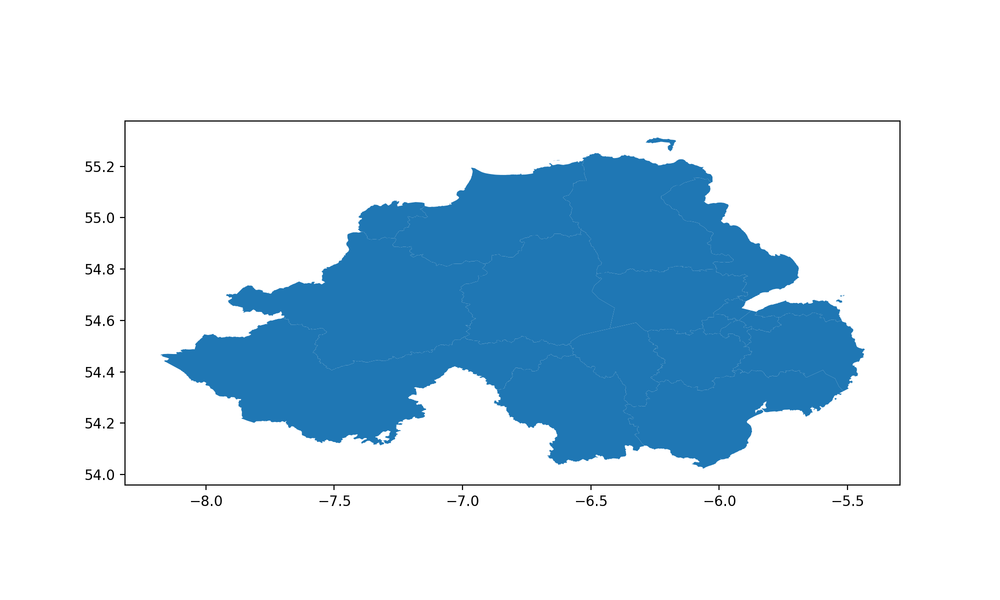

In [170]:
cons_gdf.plot()

In [171]:
def annotate_cons(x, ax, column=None):
    if column is not None:
        if isinstance(x[column], float):
            annotation_text = f"{x.name}\n{x[column]:0.2f}"
        else:
            annotation_text = f"{x.name}\n{x[column]}"
    else:
        annotation_text = x.name
    ax.annotate(annotation_text, 
                 xy=x.geometry.centroid.coords[0], 
                 ha='center', 
                 color='#dddddd',
                 fontsize= max(0.05,min(x.geometry.area,0.1))*100
                )
    ax.axis('off')

<IPython.core.display.Javascript object>


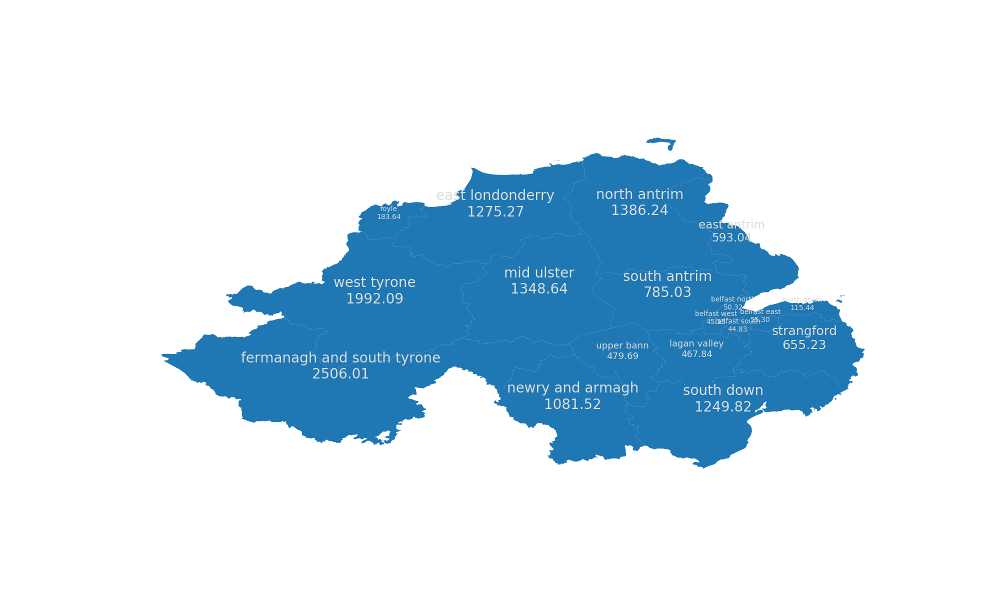

In [172]:
f,ax = plt.subplots(figsize=graph_figsize)
cons_gdf.plot(ax=ax)
cons_gdf.apply(annotate_cons, ax=ax, axis=1, column='Area_sqkm');

In [173]:
def plotmap(gdf,column=None, *args, outfile=None, title=None, **kwargs):
    f,ax = plt.subplots(figsize=graph_figsize)
    if title is not None:
        ax.set_title(title)
    gdf.plot(column=column, legend=True, ax=ax, **kwargs)
    gdf.apply(annotate_cons, ax=ax, axis=1, column=column);
    f.tight_layout()
    ax.axis('off')
    if outfile is not None:
        f.savefig(outfile)
        plt.close(f)

<IPython.core.display.Javascript object>


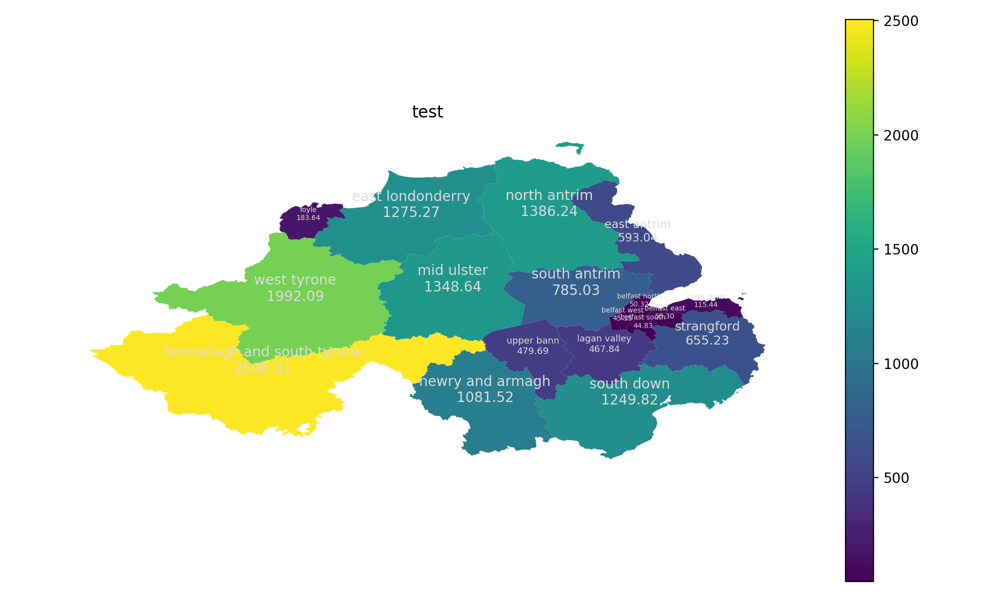

In [174]:
plotmap(cons_gdf, 'Area_sqkm', title='test')

In [175]:
cons_gdf.head()

,Area_sqkm,geometry
constituency,,
north down,115.440659,(POLYGON ((-5.535202262588358 54.6429094127538...
upper bann,479.692420,POLYGON ((-6.272362541809057 54.53315266491968...
east antrim,593.040484,(POLYGON ((-5.821518715277645 54.8754462316150...
north antrim,1386.235791,(POLYGON ((-6.429871651099131 55.2386720274860...
south down,1249.820808,(POLYGON ((-6.079447038790904 54.0473674415929...


## Horribly encoded statistics!
'{metric}\_{year}\_{stat}'

In [176]:
# Using the reference table as a selector
con='belfast east'
reference.major_axis[(reference.minor_xs('parliamentary constituency')==con).any(axis=1)]

Int64Index([1210014, 1210015, 1210266, 1410079, 1410315, 1420018, 1420020,
            1420089, 4210086, 4210262, 4260255, 4420259],
           dtype='int64', name='de ref')

In [177]:
cons = set(reference.minor_xs('parliamentary constituency').dropna().values.ravel('k'))

In [178]:
# Enrolment sum of year group for all schools in constituencey per consitituency
en_df= pd.DataFrame.from_dict({
    con:
    enrolment[:,reference.major_axis[(reference.minor_xs('parliamentary constituency')==con).any(axis=1)],:].sum().sum()
    for con in cons
}).T

# Available places sum of year group for all schools in constituencey per consitituency
av_df= pd.DataFrame.from_dict({
    con:
    available[:,reference.major_axis[(reference.minor_xs('parliamentary constituency')==con).any(axis=1)],'available places'].sum()
    for con in cons
}).T

# Free School Meals
fsm_df= pd.DataFrame.from_dict({
    con:
    fsm[:,reference.major_axis[(reference.minor_xs('parliamentary constituency')==con).any(axis=1)],'fsme'].sum()
    for con in cons
}).T

In [179]:
for c in av_df:
    cons_gdf[f"av_{c}"] = av_df[c]
    cons_gdf[f"av_{c}_rat"] = (av_df[c]/en_df[c])
for c in en_df:
    cons_gdf[f"en_{c}"] = en_df[c]
    cons_gdf[f"en_{c}_pk"] = en_df[c]/cons_gdf["Area_sqkm"]
for c in fsm_df:
    cons_gdf[f"fsm_{c}"] = fsm_df[c]
    cons_gdf[f"fsm_{c}_rat"] = (fsm_df[c]/en_df[c])
cons_gdf.head()

,Area_sqkm,geometry,av_2010,av_2010_rat,av_2011,av_2011_rat,av_2012,av_2012_rat,av_2013,av_2013_rat,...,fsm_2013,fsm_2013_rat,fsm_2014,fsm_2014_rat,fsm_2015,fsm_2015_rat,fsm_2016,fsm_2016_rat,fsm_2017,fsm_2017_rat
constituency,,,,,,,,,,,,,,,,,,,,,
north down,115.440659,(POLYGON ((-5.535202262588358 54.6429094127538...,76.0,0.013831,70.0,0.012572,83.0,0.014877,49.0,0.008807,...,615.0,0.110532,950.0,0.169582,1099.0,0.193656,1203.0,0.210942,1237.0,0.214794
upper bann,479.692420,POLYGON ((-6.272362541809057 54.53315266491968...,1837.0,0.180772,2129.0,0.211967,2308.0,0.232967,2457.0,0.252466,...,1584.0,0.162762,2192.0,0.228595,1990.0,0.244262,2071.0,0.215684,2444.0,0.249184
east antrim,593.040484,(POLYGON ((-5.821518715277645 54.8754462316150...,664.0,0.101158,739.0,0.113762,855.0,0.133406,999.0,0.160844,...,895.0,0.144099,1217.0,0.198176,1471.0,0.236609,1553.0,0.248679,1605.0,0.255045
north antrim,1386.235791,(POLYGON ((-6.429871651099131 55.2386720274860...,994.0,0.105163,1094.0,0.116321,1217.0,0.129097,1263.0,0.135399,...,1383.0,0.148263,1890.0,0.202942,2080.0,0.227000,2167.0,0.237090,2123.0,0.232632
south down,1249.820808,(POLYGON ((-6.079447038790904 54.0473674415929...,1378.0,0.120803,1577.0,0.140841,1693.0,0.151989,1857.0,0.169095,...,1830.0,0.166636,2551.0,0.236598,2741.0,0.256552,2711.0,0.257724,2649.0,0.252190


In [180]:
pop_years = set(cons_pop.Mid_Year_Ending.unique())
for c in tqdm(reference.axes[0].astype(int), desc="Year"):
    # Preserve edu data and use closest population year
    if c not in pop_years:
        yr = pop_years[np.abs(pop_years-c).argmin()]
    else:
        yr=c
        
    age_quartiles=annual_quartiles.loc[yr].astype(int)
        
    _cons_pop = cons_pop[(cons_pop.Gender != 'All Persons') \
                       & (cons_pop.Mid_Year_Ending == yr) \
                      ].groupby(['constituency', 'Gender'])['Population_Estimate'].sum()\
                        .unstack().rename(columns=lambda c: c.lower())
    _cons_pop['total'] = _cons_pop.sum(axis=1)
    _cons_pop['m_per_f'] = _cons_pop['males']/_cons_pop['females']
    
    cons_gdf[f"pop_{c}"] = _cons_pop['total']
    cons_gdf[f"pop_{c}_males"] = _cons_pop['males']
    cons_gdf[f"pop_{c}_females"] = _cons_pop['females']
    cons_gdf[f"pop_{c}_m_per_f"] = _cons_pop['m_per_f']
    
    

    cons_gdf[f"topqt_{c}"]=cons_pop[
        (cons_pop.Gender != 'All Persons') & (cons_pop.Mid_Year_Ending == yr)
    ].groupby('constituency').apply(get_winning_quartile, age_quartiles=annual_quartiles.loc[yr].values) 
    
    cons_gdf[f"en_{c}_pc"]=cons_gdf[f"en_{c}"]/cons_gdf[f"pop_{c}"]
    cons_gdf[f"fsm_{c}_pc"]=cons_gdf[f"fsm_{c}"]/cons_gdf[f"pop_{c}"]
    
    cons_pop_mean=cons_pop[(cons_pop.Gender.isin(["All Persons"])) & (cons_pop.Mid_Year_Ending == yr)]
    cons_pop_mean['popprod'] = cons_pop_mean[['Age','Population_Estimate']].product(axis=1)
    cons_pop_mean=cons_pop_mean.groupby('constituency')[['popprod','Population_Estimate']].sum(axis=0)
    cons_gdf[f'age_{c}_avg'] = cons_pop_mean['popprod']/cons_pop_mean['Population_Estimate']
    try:
        cons_gdf[f"av_{c}_pc"]=cons_gdf[f"av_{c}"]/cons_gdf[f"pop_{c}"]
    except:
        print(f"No data for av in {c}")

No data for av in 2009



### Average Age

<IPython.core.display.Javascript object>


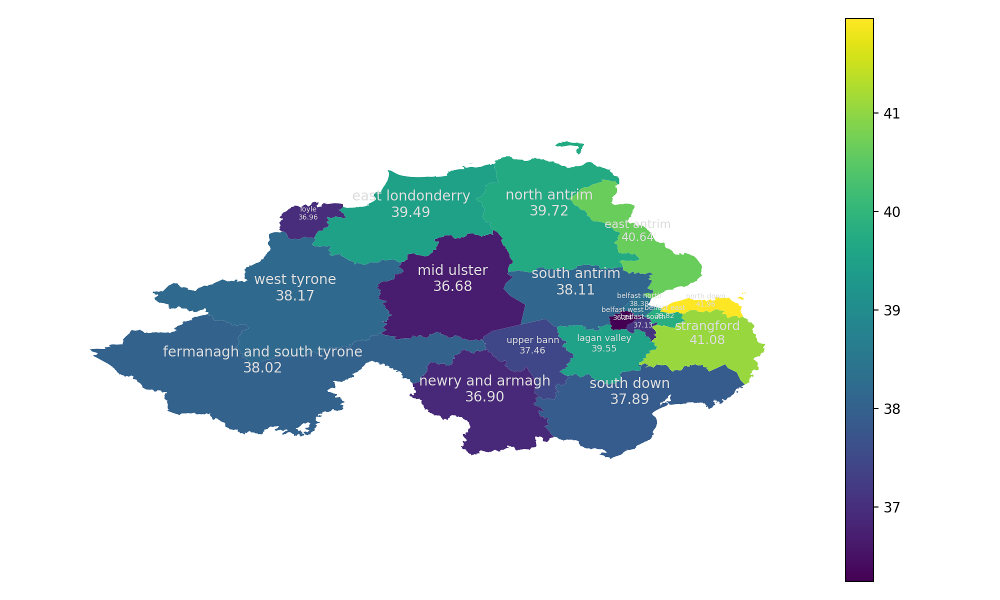

In [181]:
plotmap(cons_gdf,'age_2016_avg')

### Top Quartile

Who rules the roost

<IPython.core.display.Javascript object>


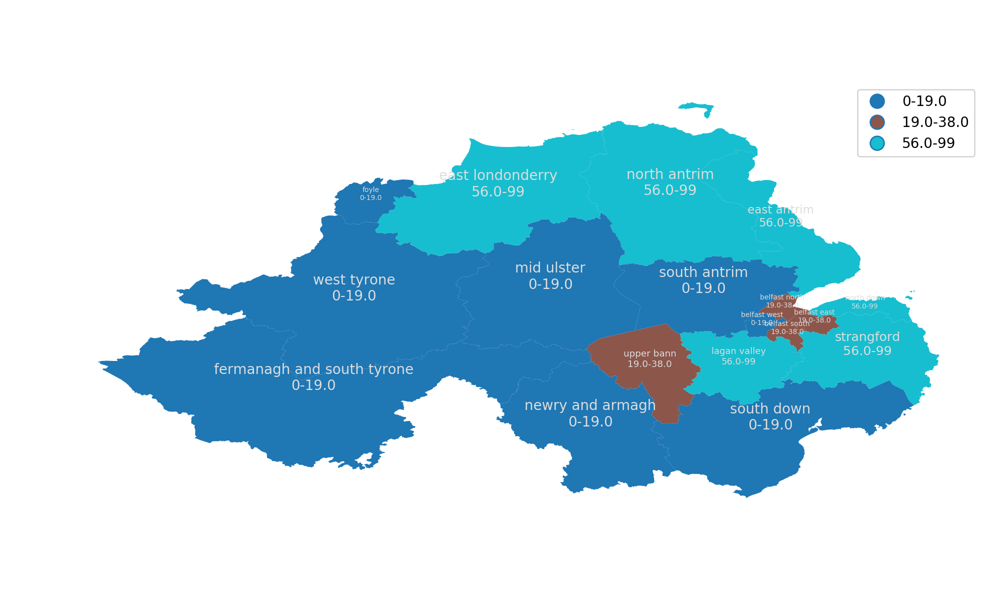

In [182]:
plotmap(cons_gdf,'topqt_2016', categorical=True)

### Mars and Venus

<IPython.core.display.Javascript object>


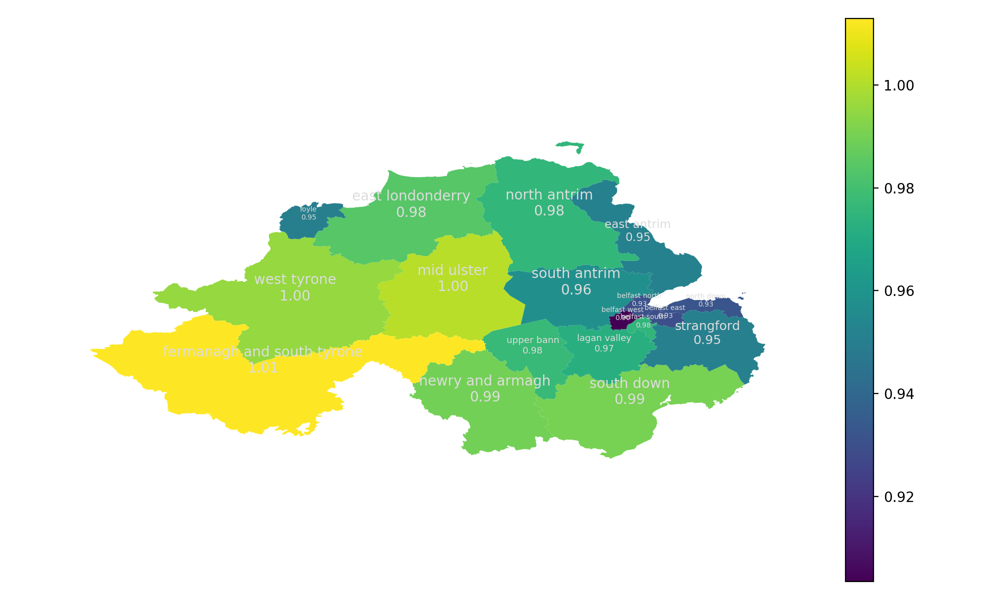

In [183]:
plotmap(cons_gdf,'pop_2016_m_per_f')

In [184]:
cons_gdf['pop_2016_m_per_f'].sort_values()

constituency
belfast west                  0.903481
belfast east                  0.929944
belfast north                 0.930790
north down                    0.931868
foyle                         0.950093
strangford                    0.950820
east antrim                   0.951355
south antrim                  0.957837
lagan valley                  0.972696
belfast south                 0.975203
north antrim                  0.975436
upper bann                    0.977205
east londonderry              0.984003
newry and armagh              0.989632
south down                    0.990544
west tyrone                   0.995602
mid ulster                    1.000991
fermanagh and south tyrone    1.012911
Name: pop_2016_m_per_f, dtype: float64

### Enroled Pupils per Capita
Lagan Valley and South Antrim popping up again!

<IPython.core.display.Javascript object>


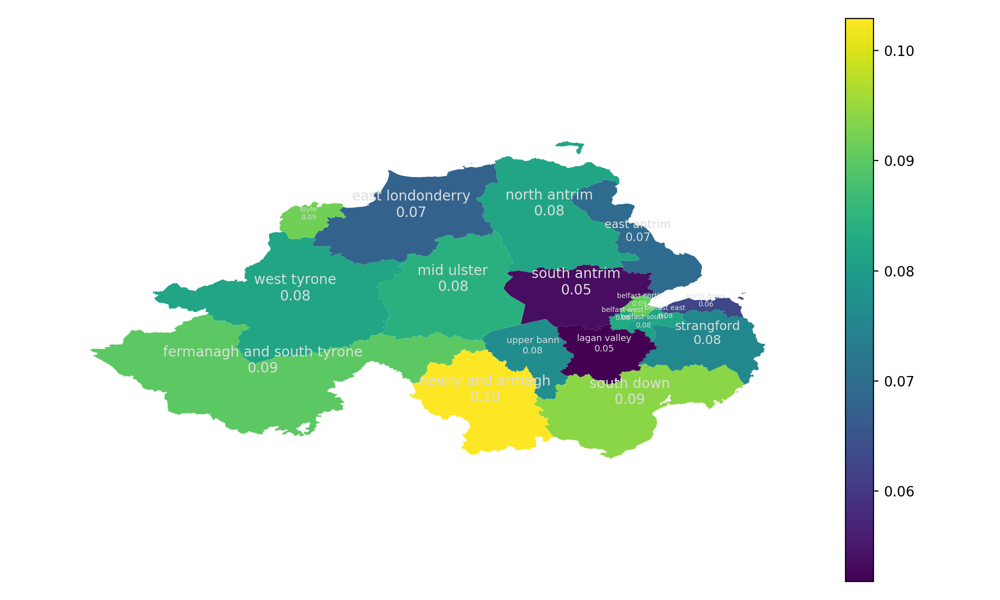

In [185]:
plotmap(cons_gdf,'en_2016_pc')

### Available Places per Capita

<IPython.core.display.Javascript object>


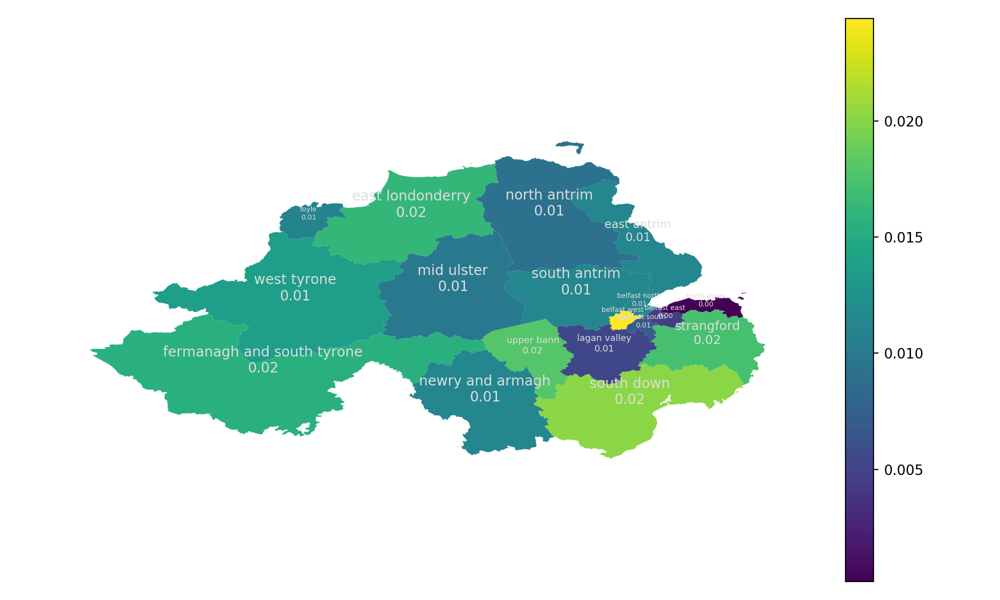

In [186]:
plotmap(cons_gdf,'av_2016_pc')

# Available Places Per $km^2$

<IPython.core.display.Javascript object>


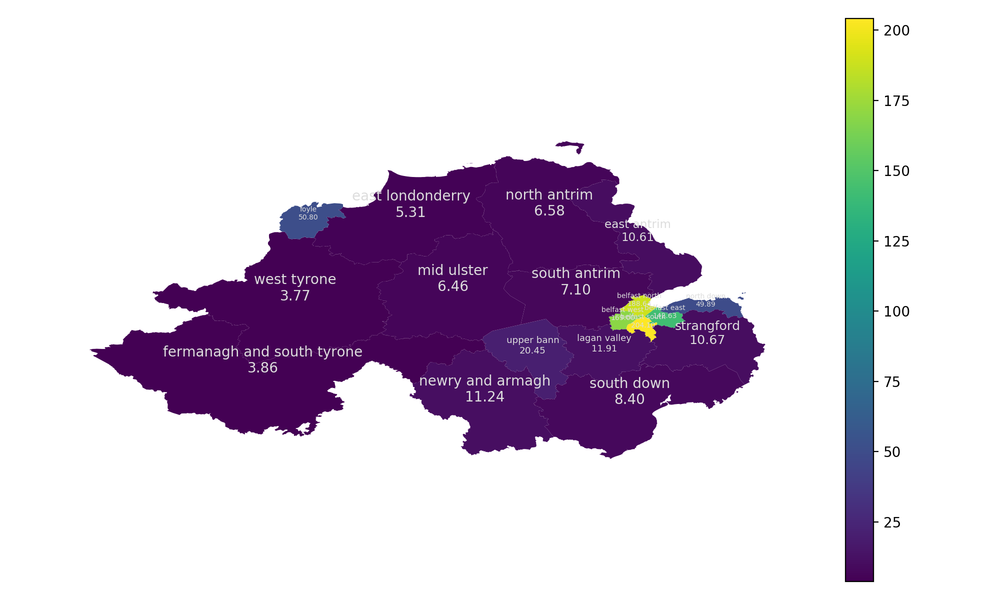

In [187]:
plotmap(cons_gdf, 'en_2017_pk')

In [188]:
cons_gdf['en_2017_pk'].sort_values()

constituency
west tyrone                     3.768899
fermanagh and south tyrone      3.857524
east londonderry                5.307115
mid ulster                      6.462817
north antrim                    6.583296
south antrim                    7.097824
south down                      8.404405
east antrim                    10.611417
strangford                     10.671039
newry and armagh               11.243427
lagan valley                   11.912162
upper bann                     20.446435
north down                     49.887102
foyle                          50.799751
belfast east                  142.627717
belfast west                  168.999917
belfast north                 188.638143
belfast south                 204.103113
Name: en_2017_pk, dtype: float64

### Free School Meals

<IPython.core.display.Javascript object>


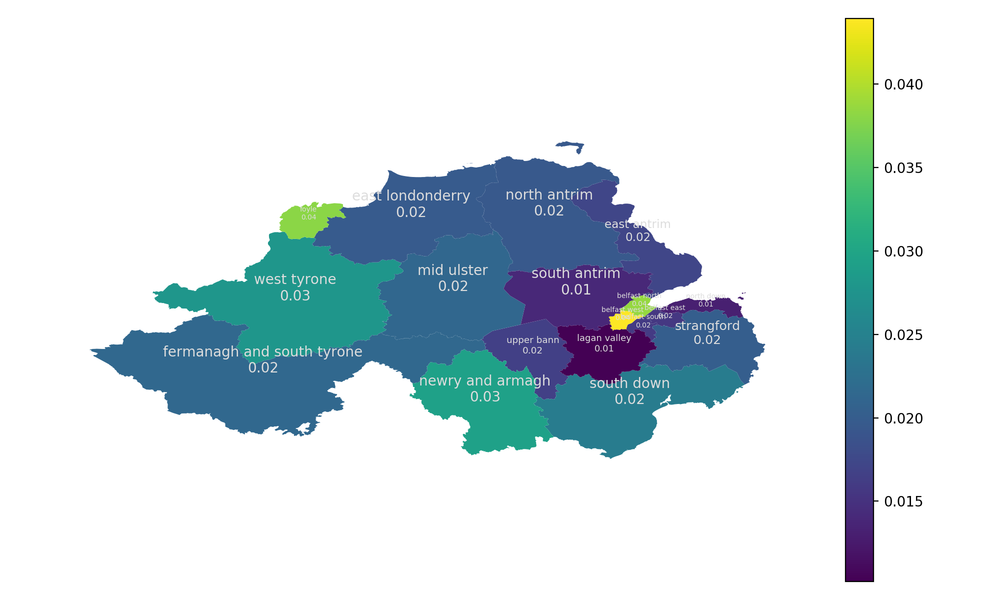

In [189]:
plotmap(cons_gdf,'fsm_2016_pc')

### FSM / Enrolled

<IPython.core.display.Javascript object>


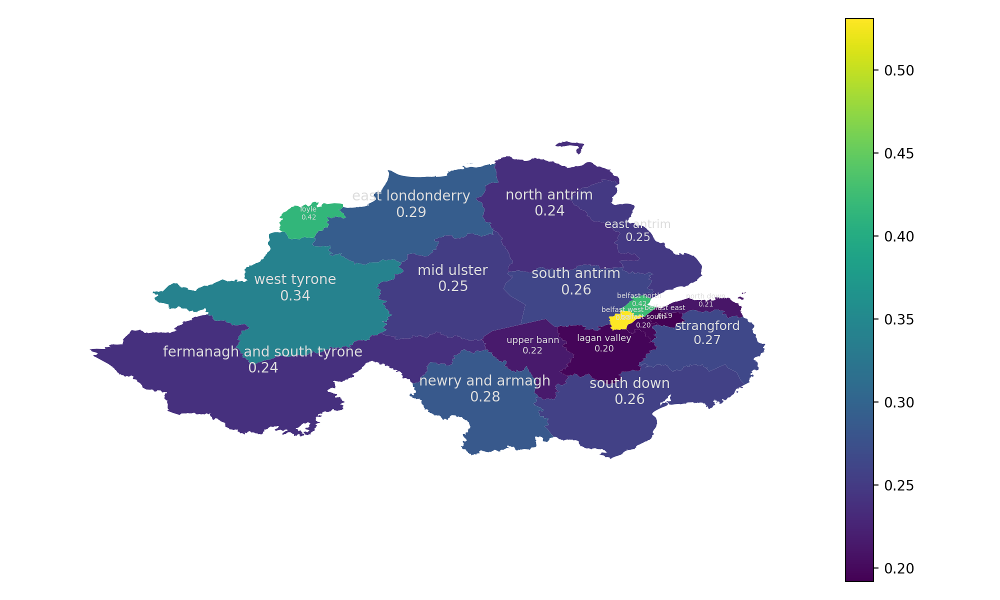

In [190]:
plotmap(cons_gdf,'fsm_2016_rat')

### "I'm bored, make a GIF!"

In [191]:
unyearify = lambda c:'_'.join([c.split('_')[0]]+c.split('_')[2:])
years = list(range(2009,2017))
explanations={
    'age_avg': "Average Age",
    'av_pc': "Available School Places per capita",
    'av_rat': "Ratio of Available Places to Actualised Enrolment",
    'av': "Available School Places",
    'en_pc': "Enrolled Pupils per capita",
    'en_pk': "Enrolled Pupils per $km^2$",
    'en': "Enrolled Pupils",
    'fsm_rat': "Ratio of FSM pupils to total pupils",
    'fsm': "FSM pupils",
    'pop': "Population",
    'pop_females': "Population (F)",
    'pop_males': "Population (M)",
    'pop_m_per_f': "Ratio of Males to Females",
    'topqt': "Most populous age quartile (Age or younger)"
}

<IPython.core.display.Javascript object>


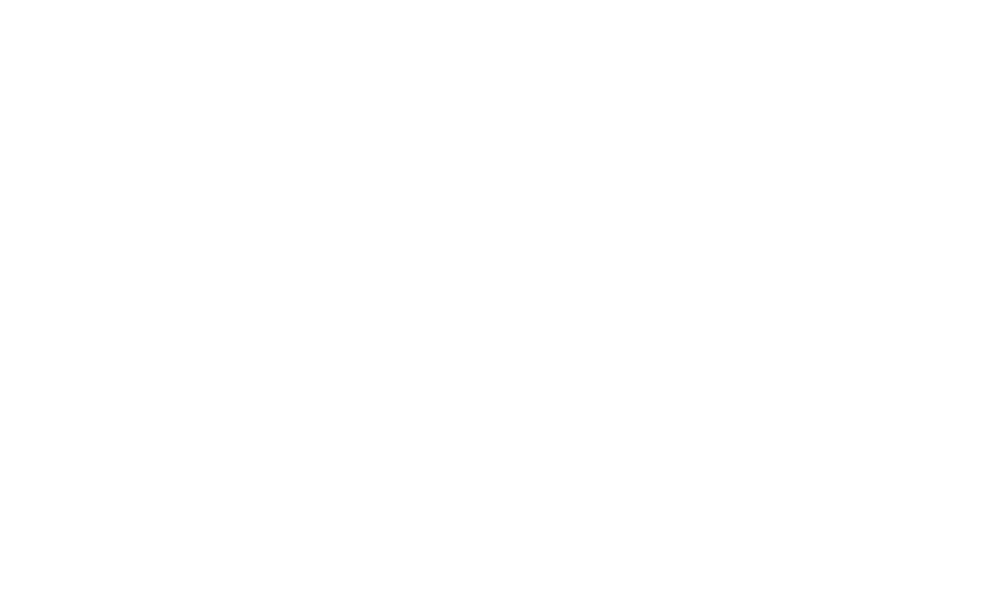

<IPython.core.display.Javascript object>


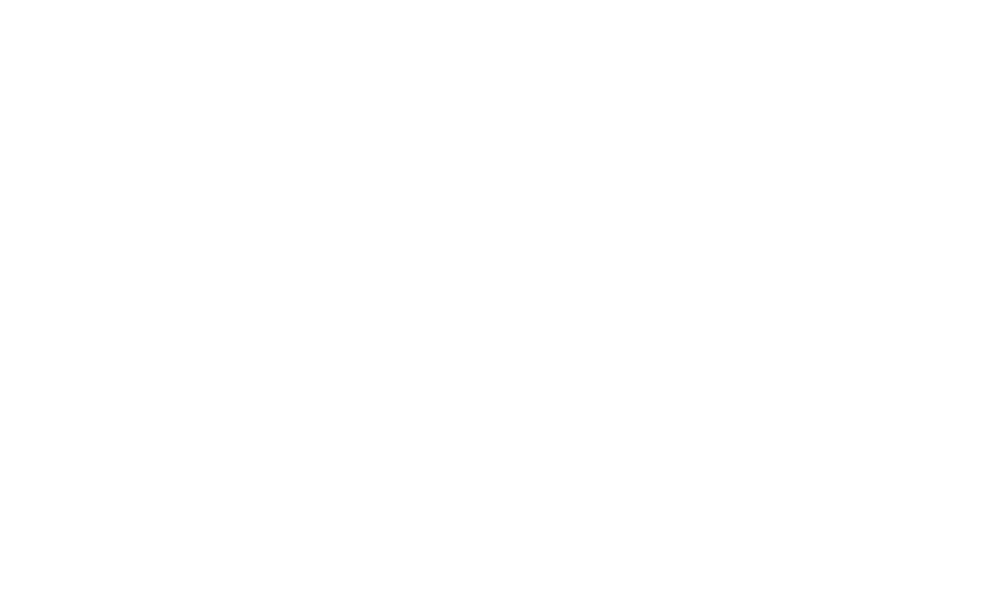

<IPython.core.display.Javascript object>


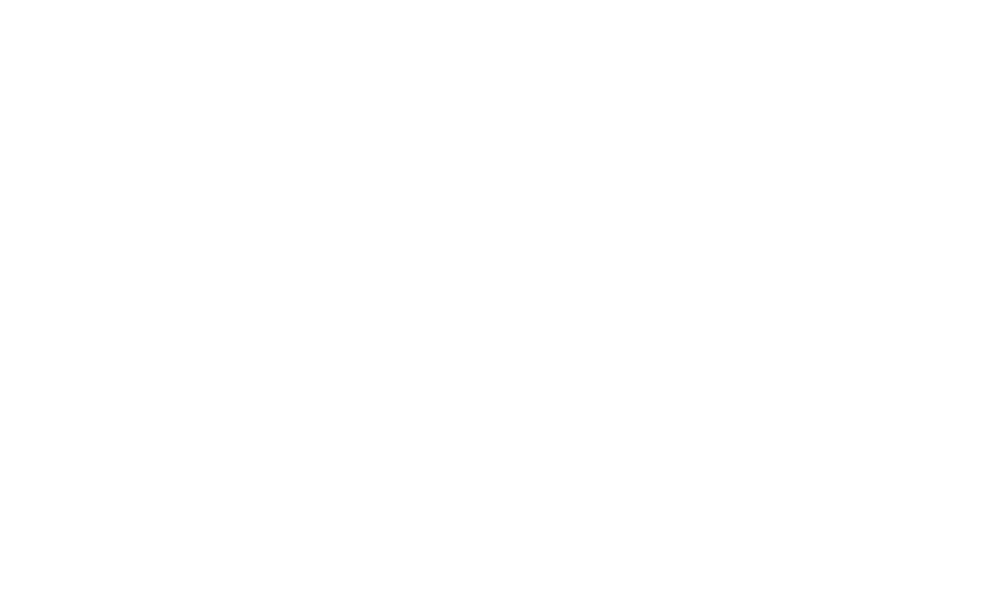

<IPython.core.display.Javascript object>


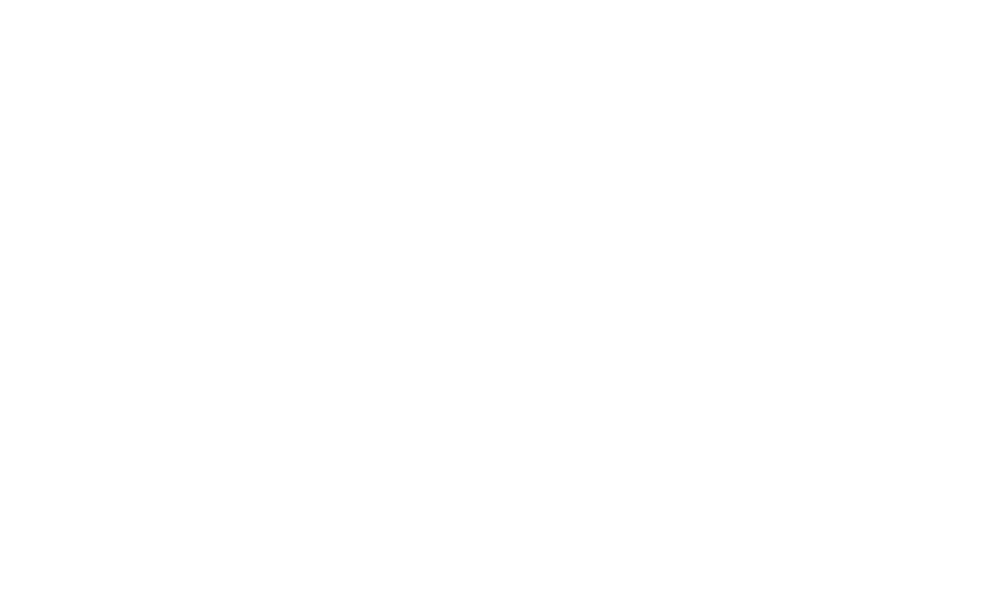

<IPython.core.display.Javascript object>


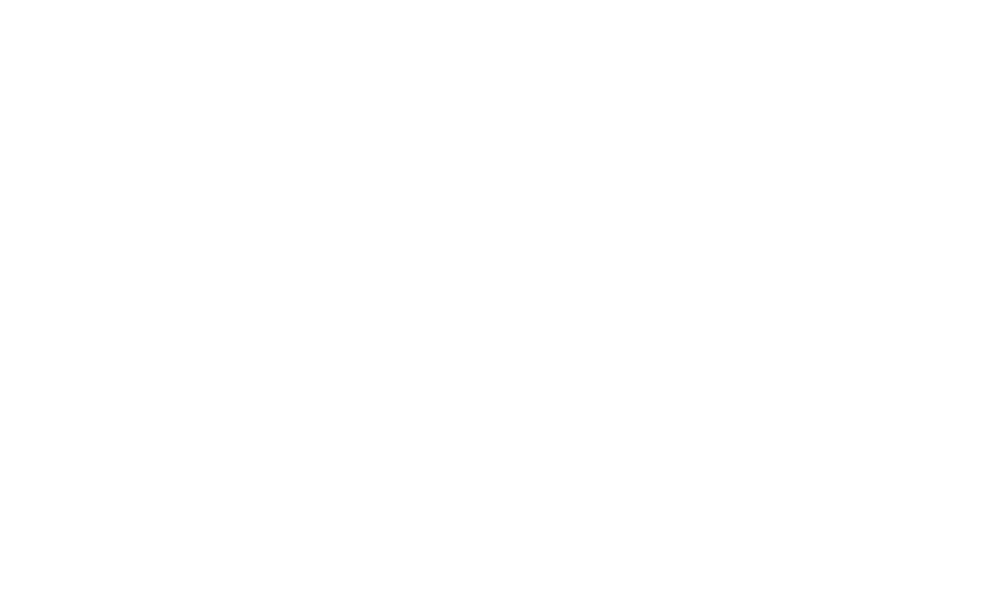

<IPython.core.display.Javascript object>


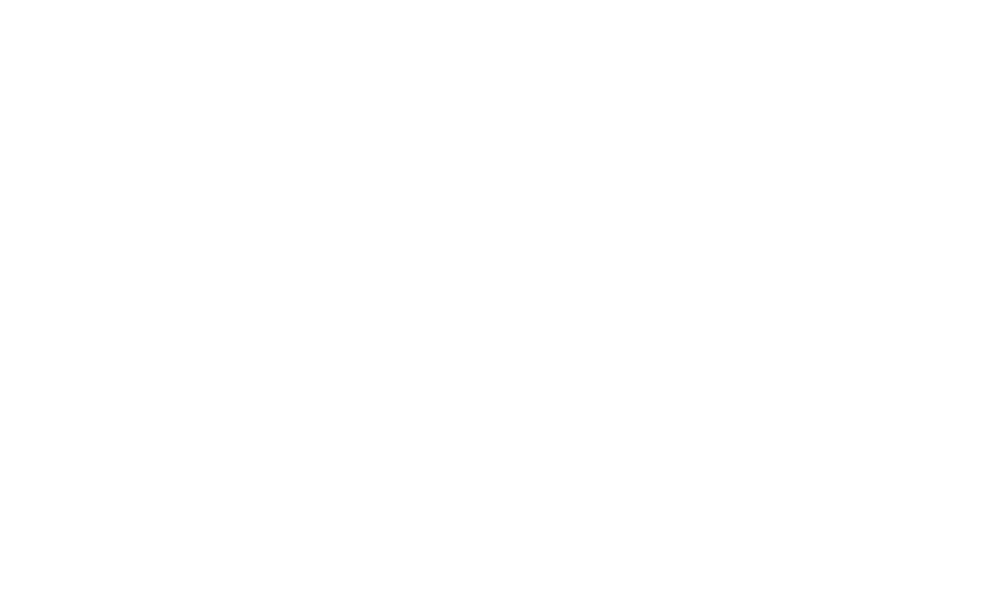

<IPython.core.display.Javascript object>


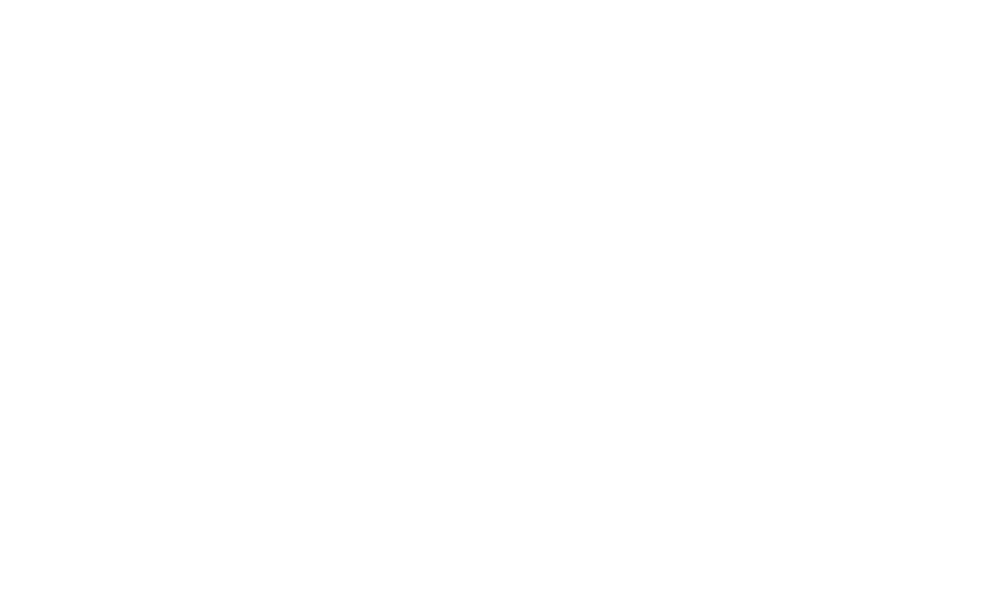

<IPython.core.display.Javascript object>


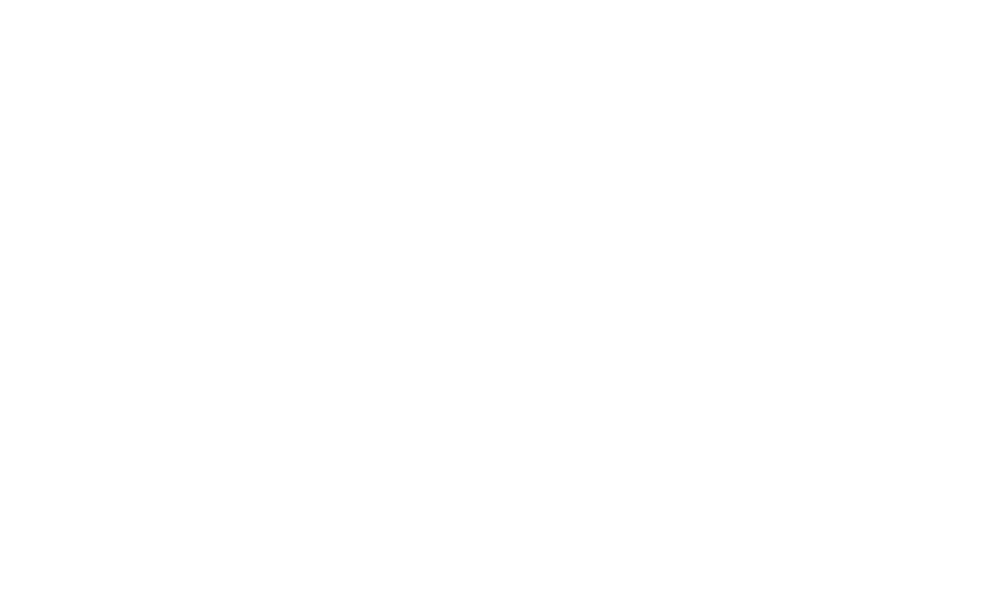

<IPython.core.display.Javascript object>


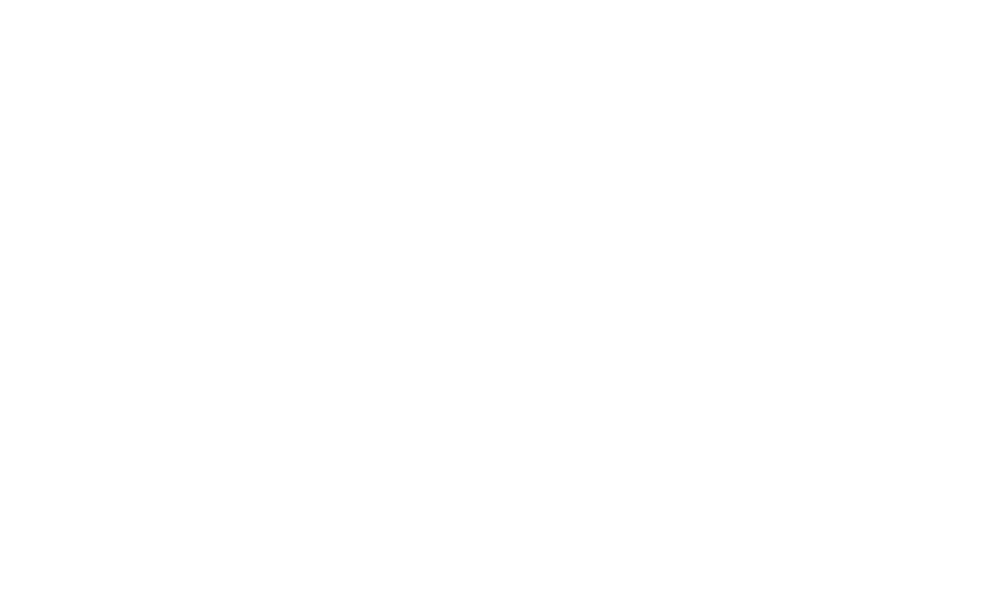

<IPython.core.display.Javascript object>


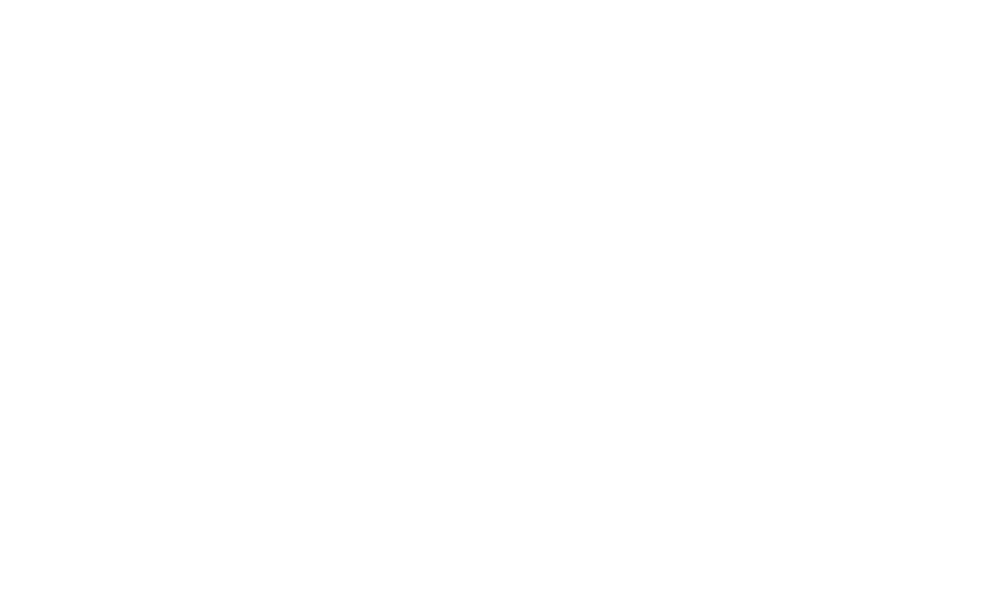

<IPython.core.display.Javascript object>


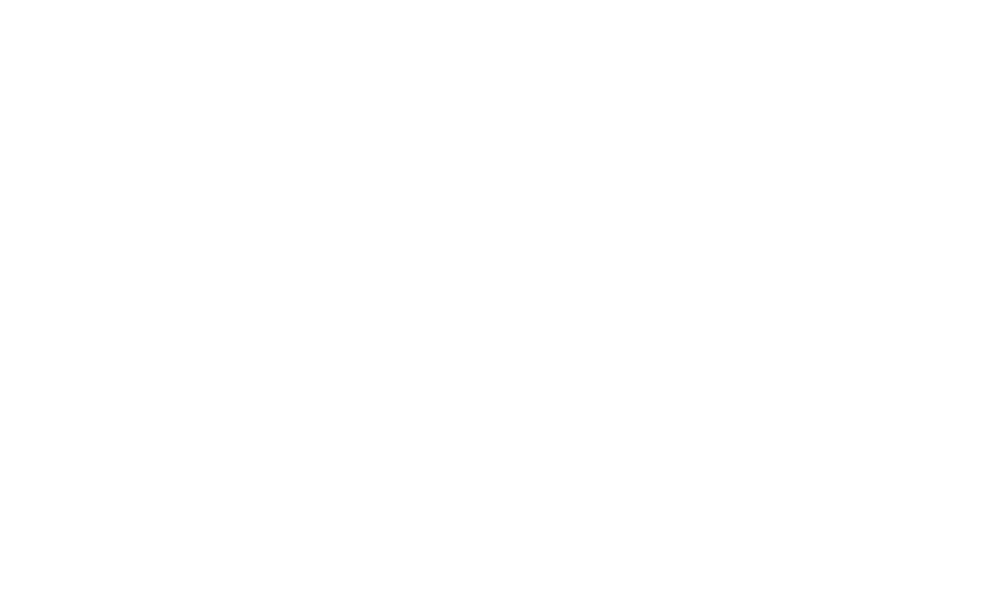

<IPython.core.display.Javascript object>


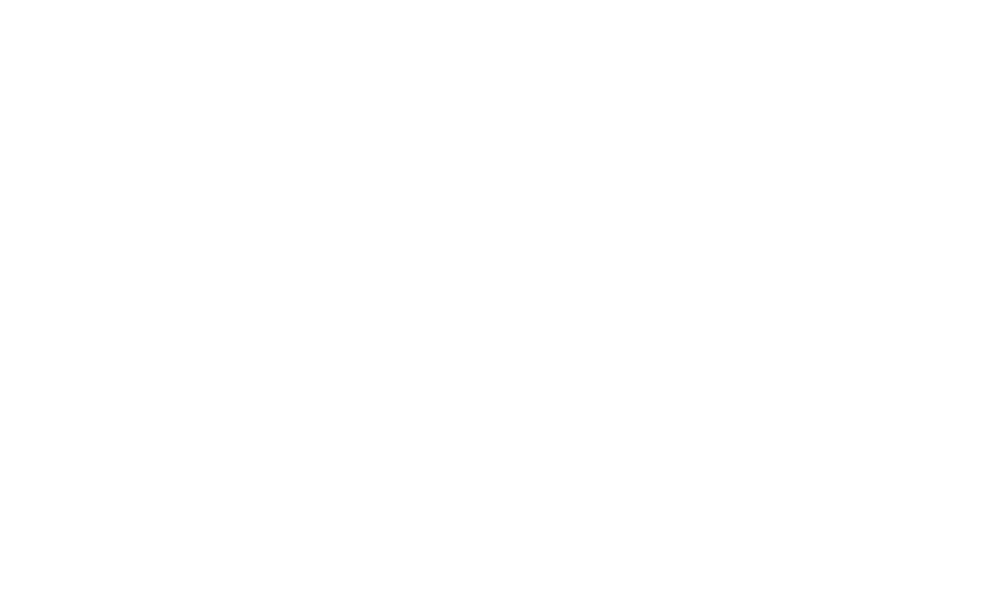

<IPython.core.display.Javascript object>


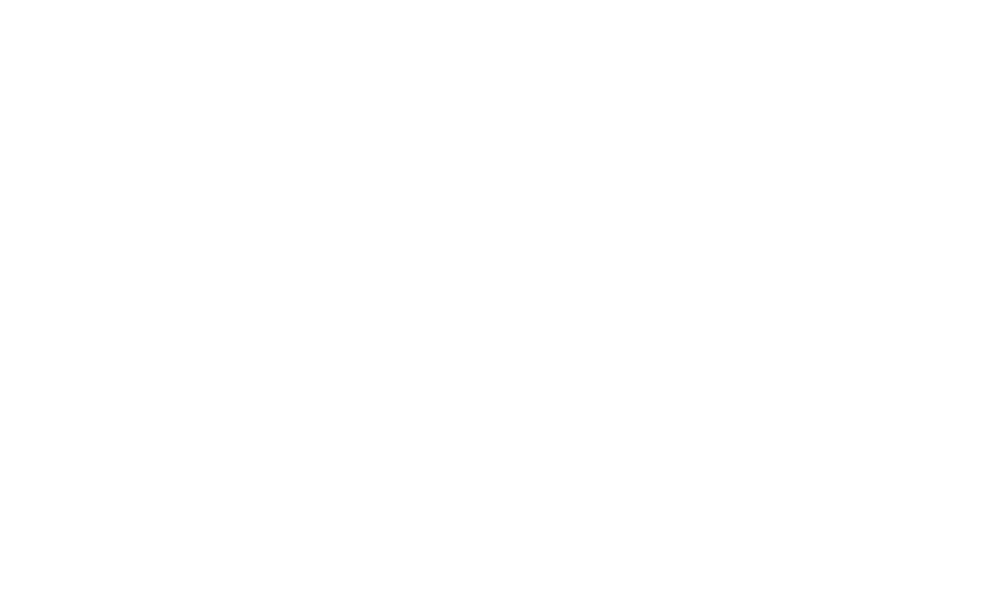

<IPython.core.display.Javascript object>


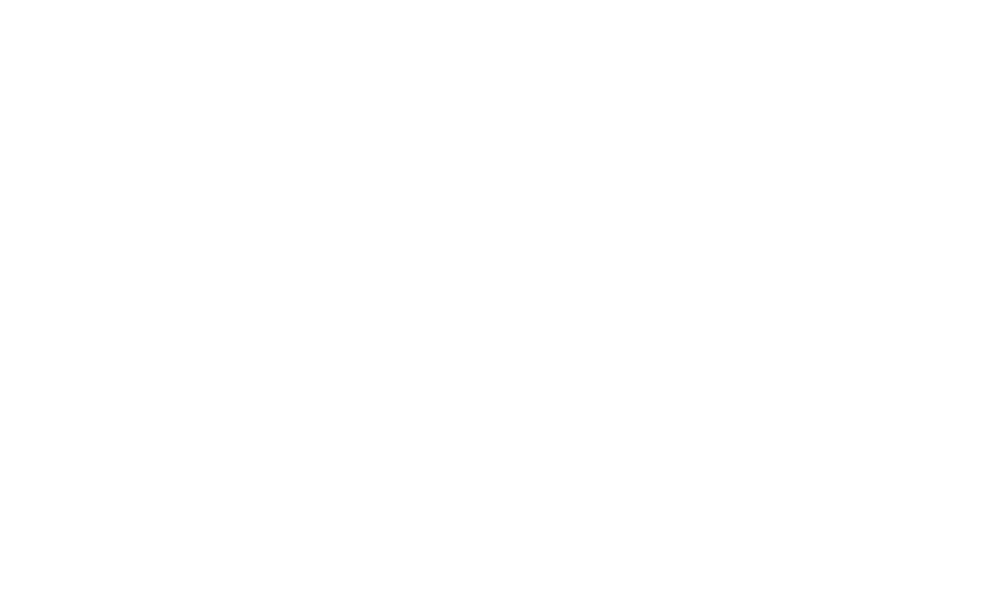

<IPython.core.display.Javascript object>


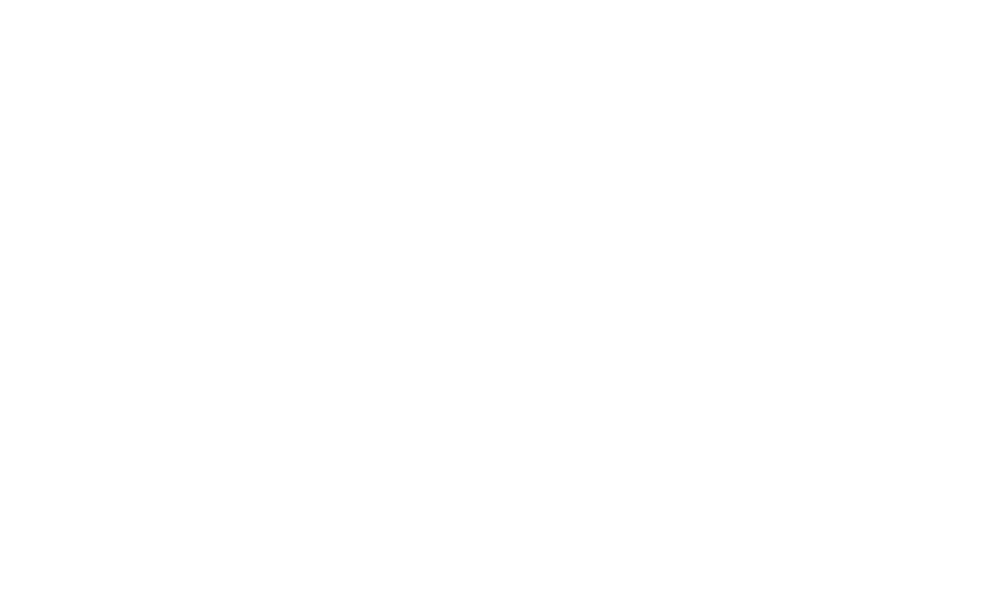

<IPython.core.display.Javascript object>


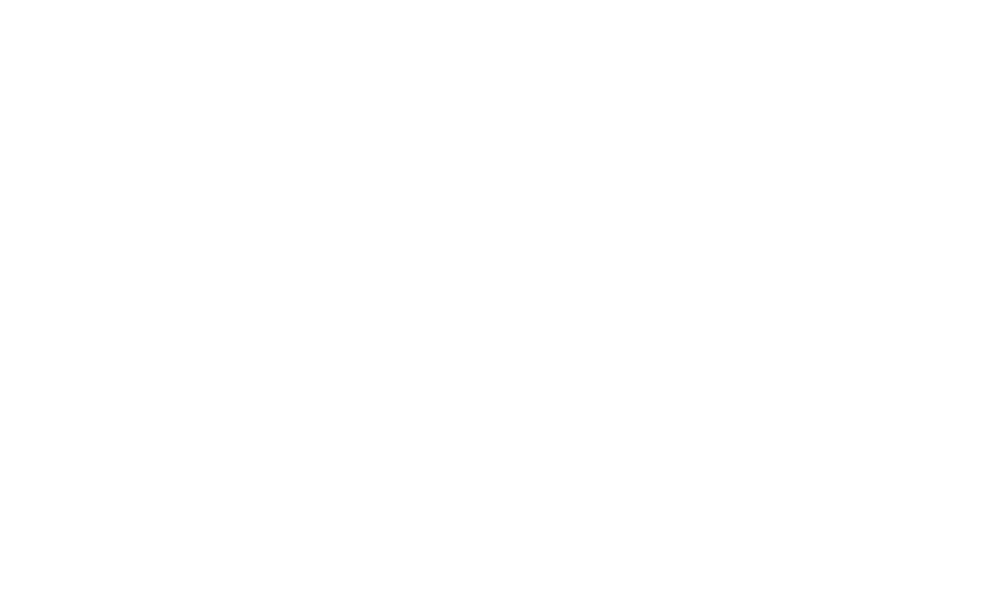

<IPython.core.display.Javascript object>


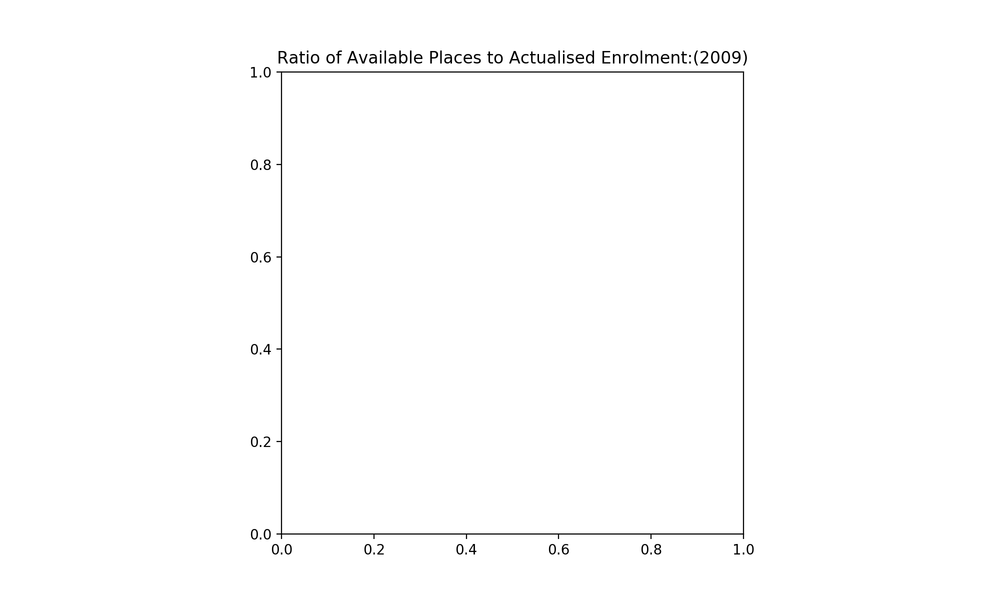

av_rat:2009 has no data


<IPython.core.display.Javascript object>


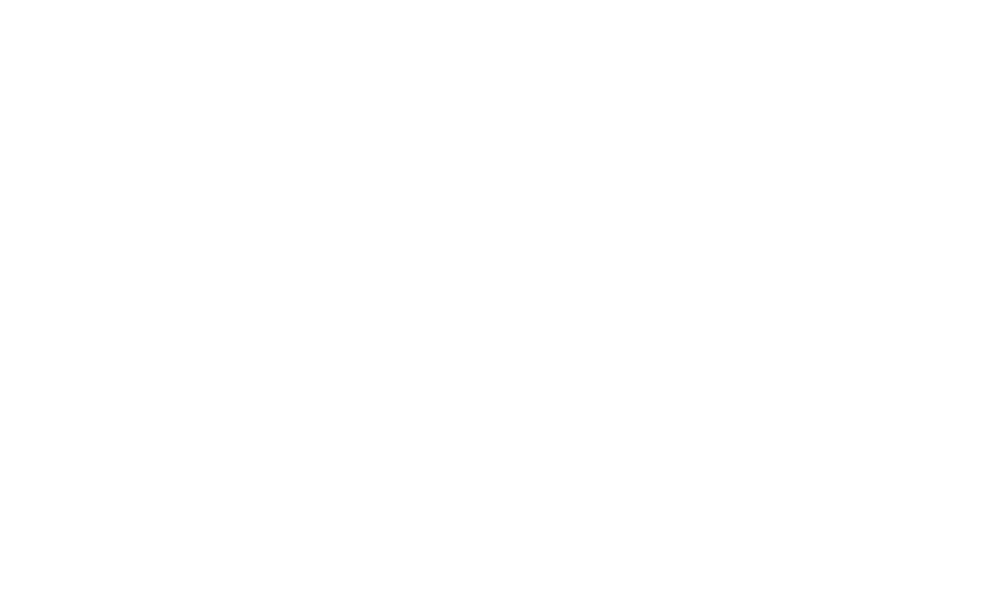

<IPython.core.display.Javascript object>


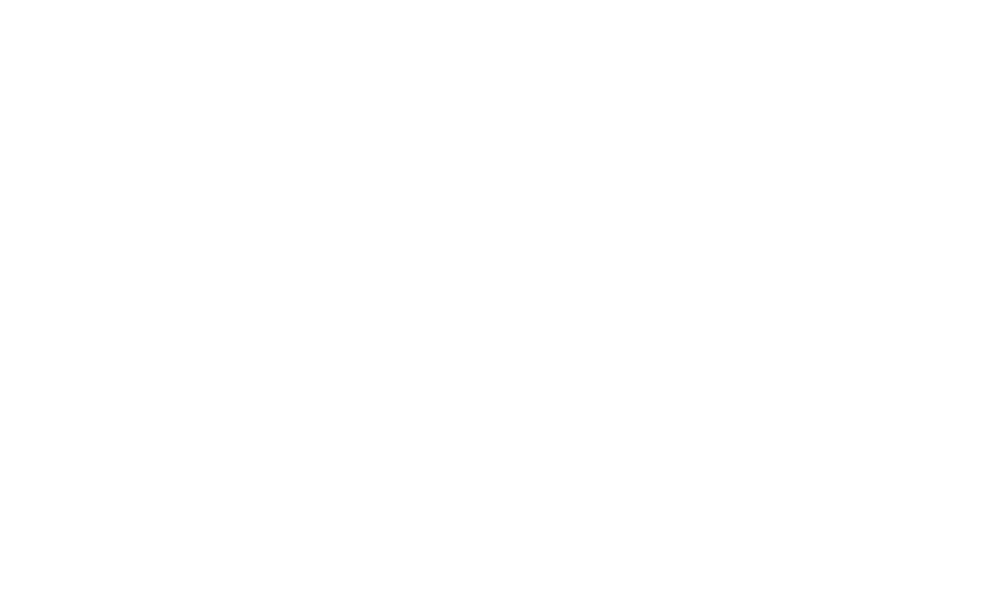

<IPython.core.display.Javascript object>


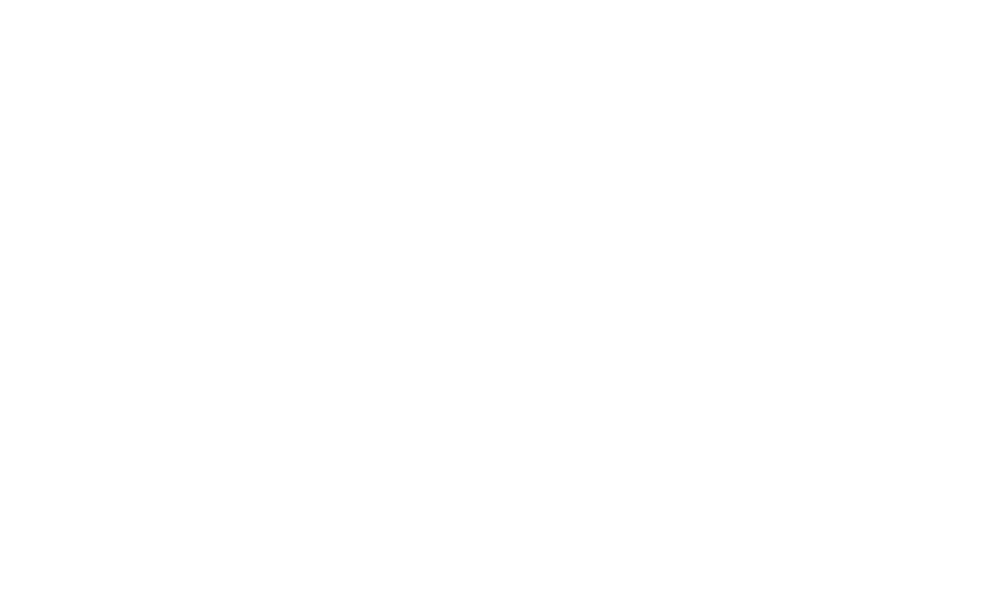

<IPython.core.display.Javascript object>


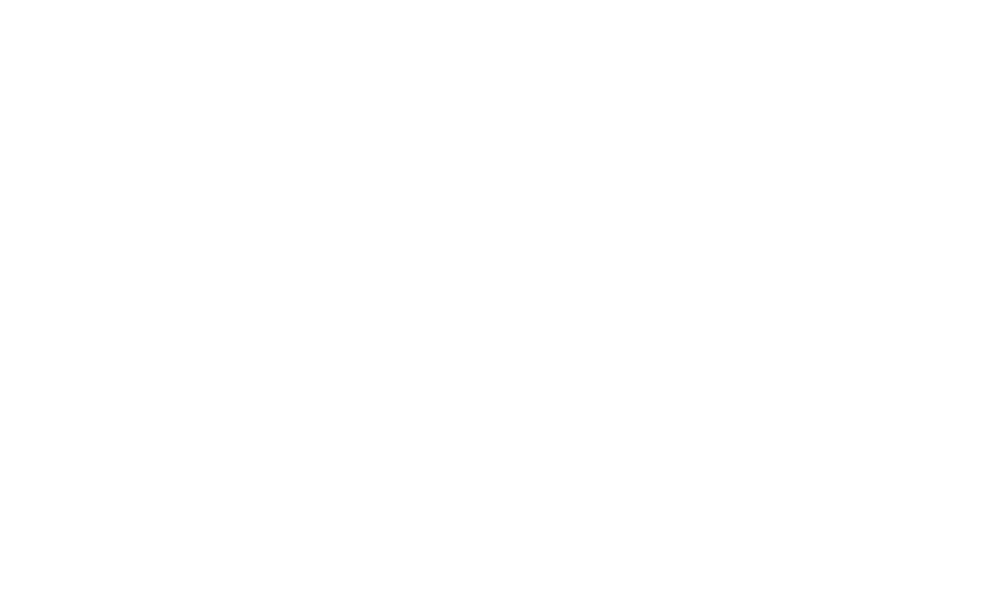

<IPython.core.display.Javascript object>


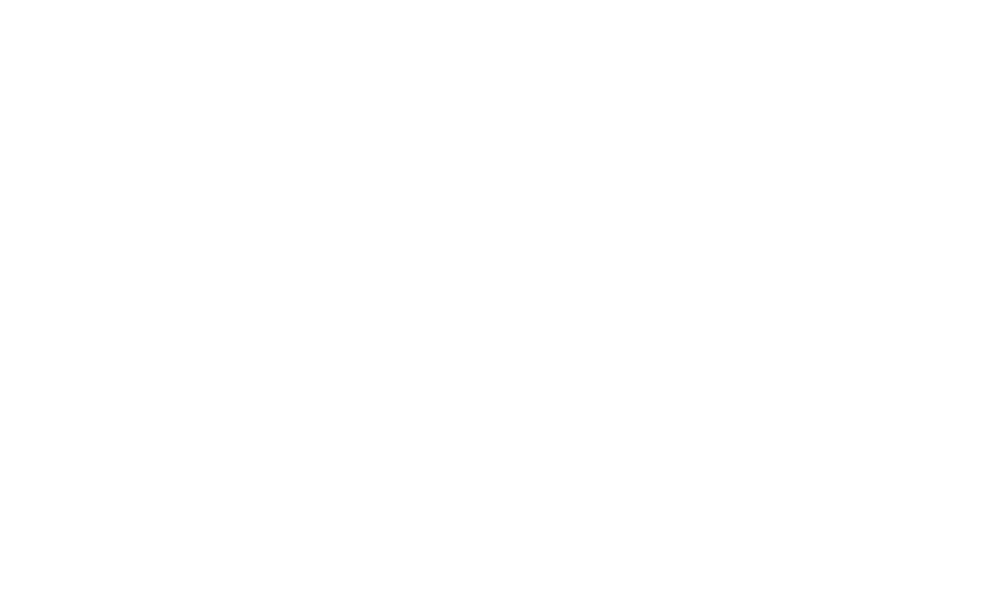

<IPython.core.display.Javascript object>


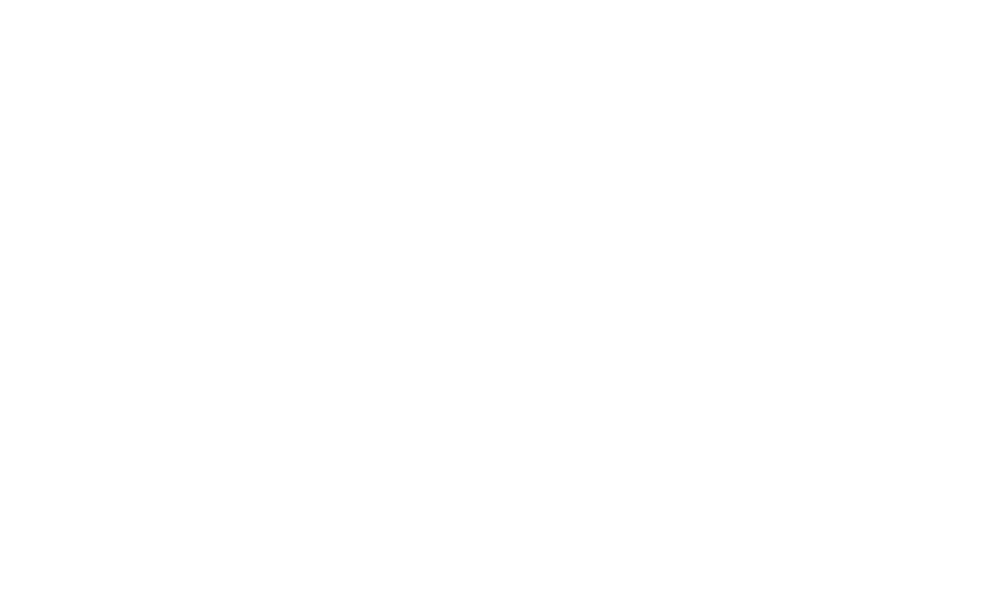

<IPython.core.display.Javascript object>


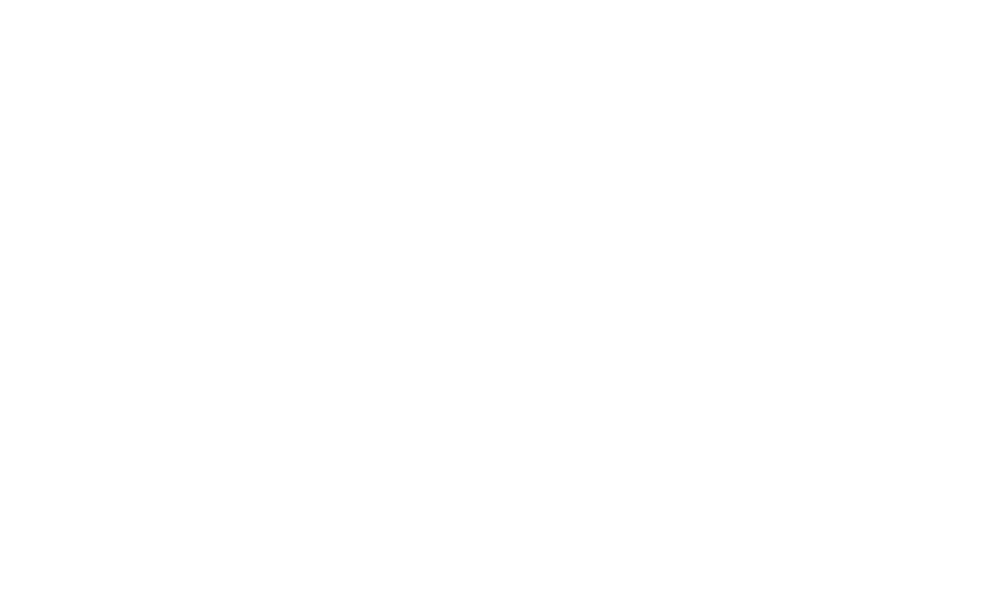

<IPython.core.display.Javascript object>


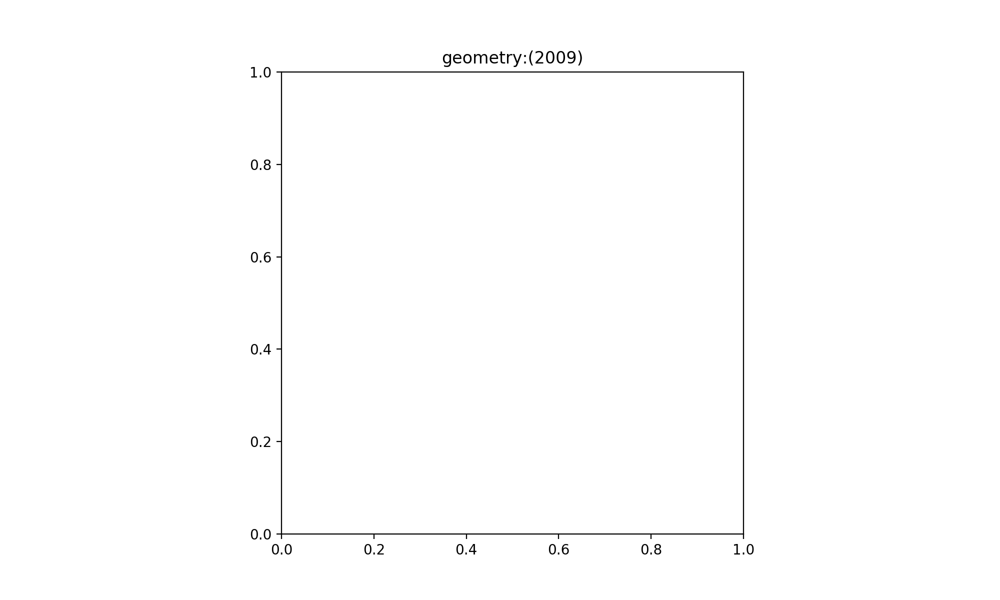

geometry:2009 has no data


<IPython.core.display.Javascript object>


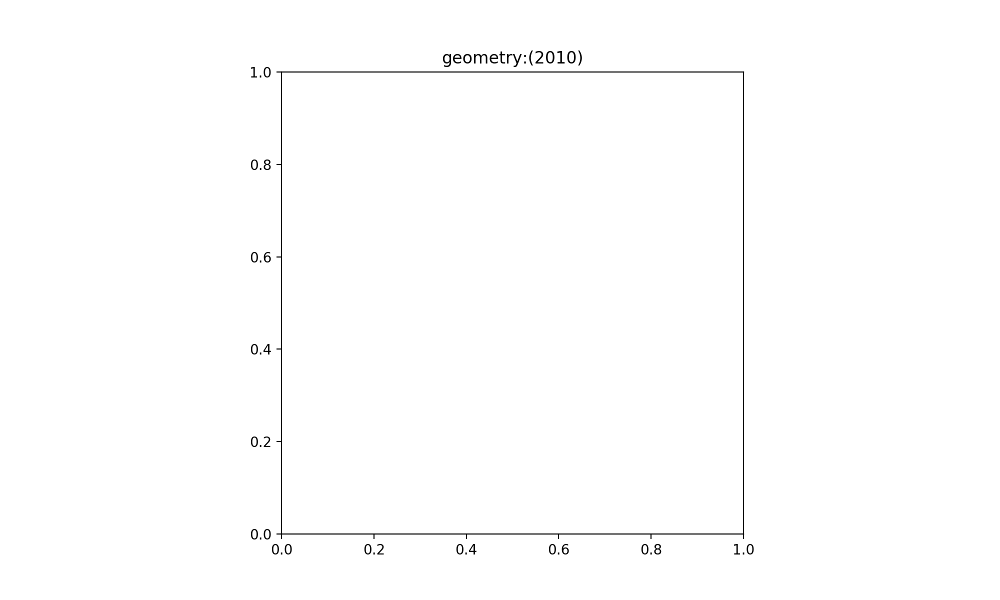

geometry:2010 has no data


<IPython.core.display.Javascript object>


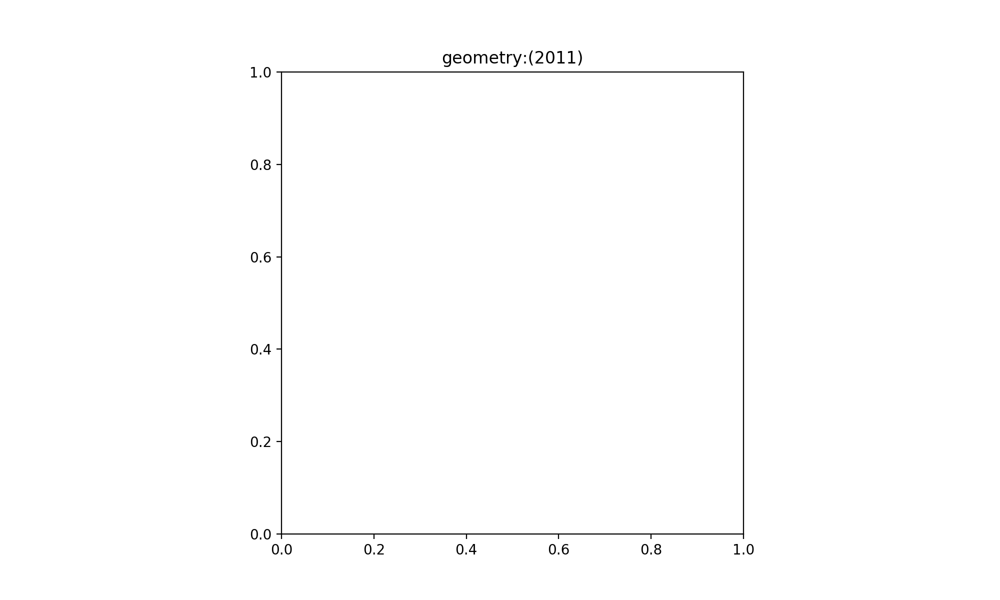

geometry:2011 has no data


<IPython.core.display.Javascript object>


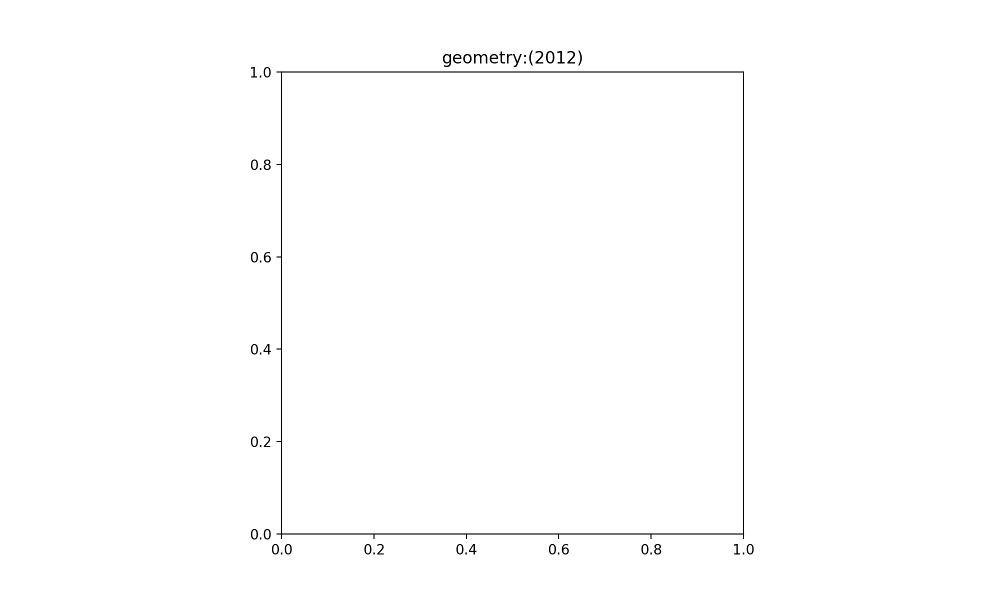

geometry:2012 has no data


<IPython.core.display.Javascript object>


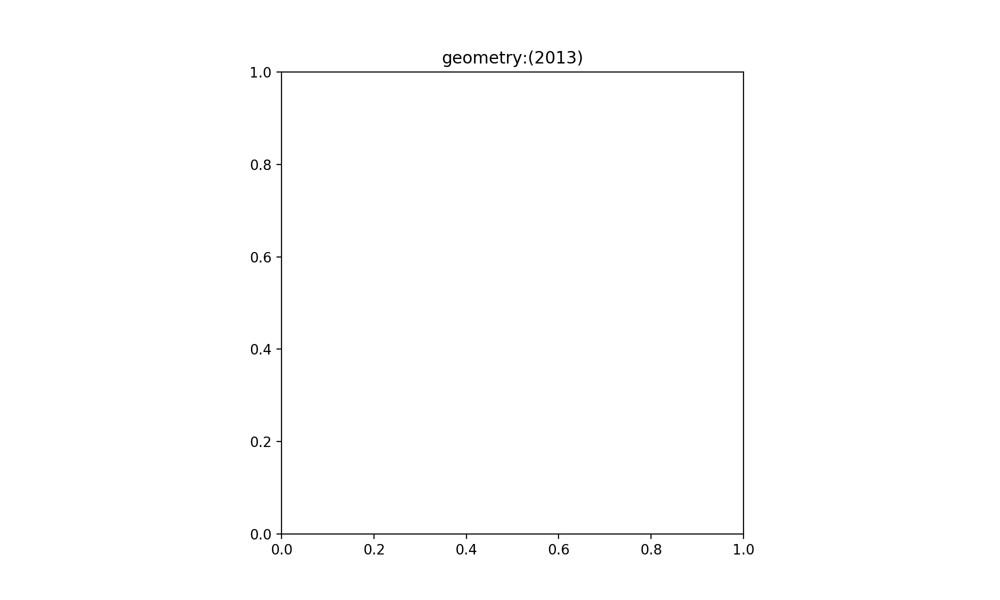

geometry:2013 has no data


<IPython.core.display.Javascript object>


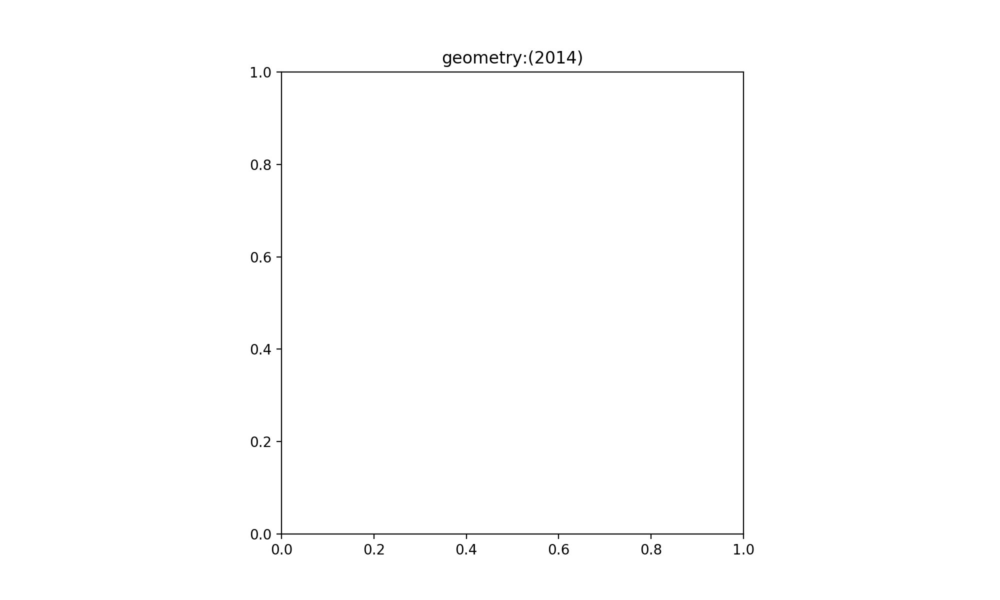

geometry:2014 has no data


<IPython.core.display.Javascript object>


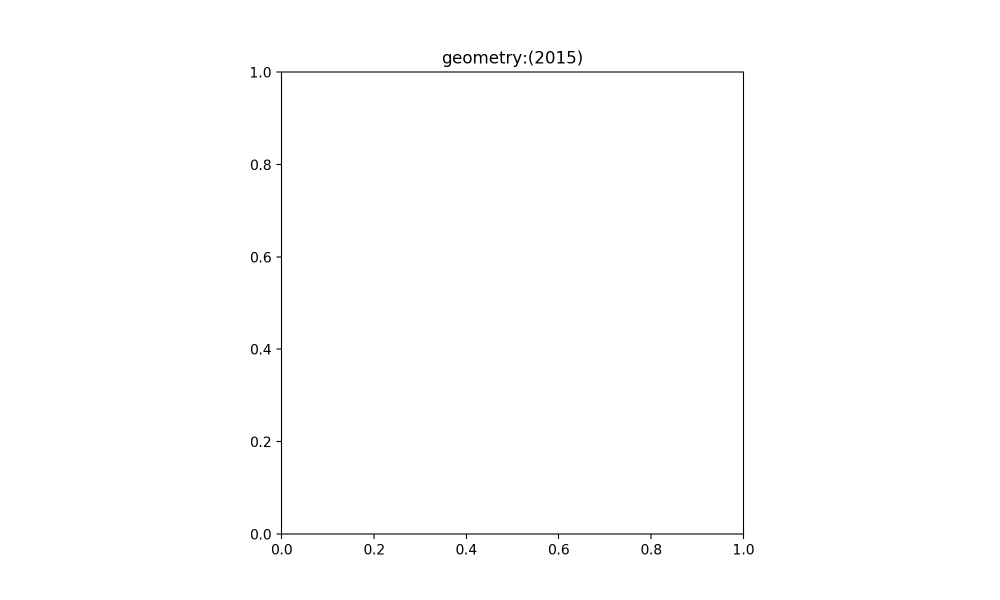

geometry:2015 has no data


<IPython.core.display.Javascript object>


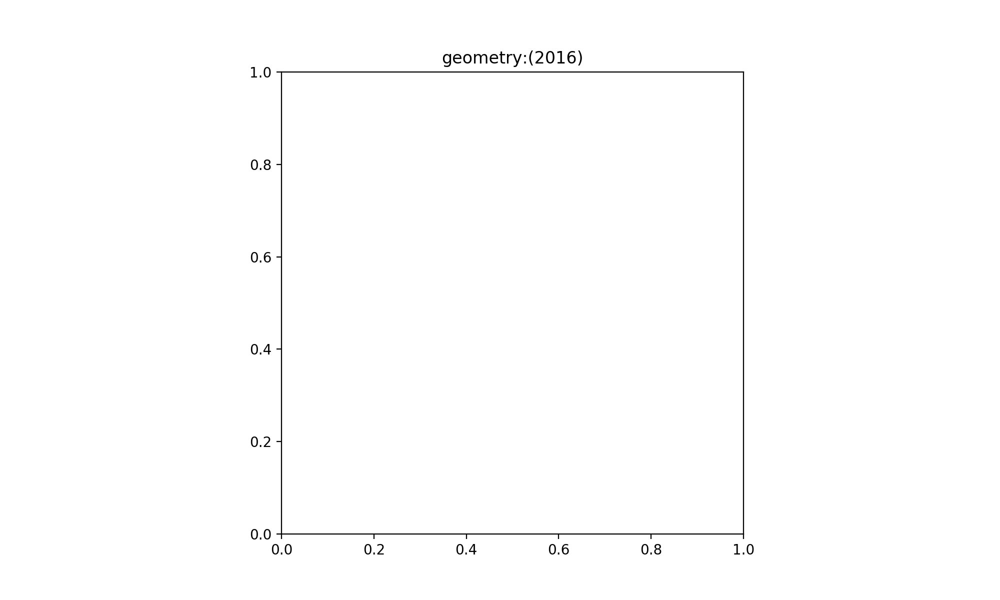

geometry:2016 has no data


<IPython.core.display.Javascript object>


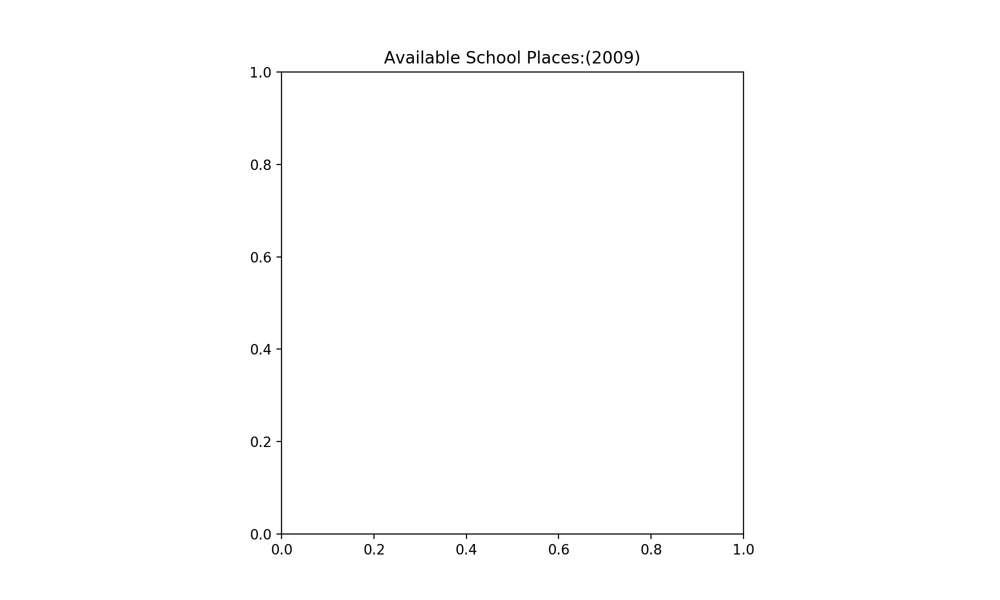

av:2009 has no data


<IPython.core.display.Javascript object>


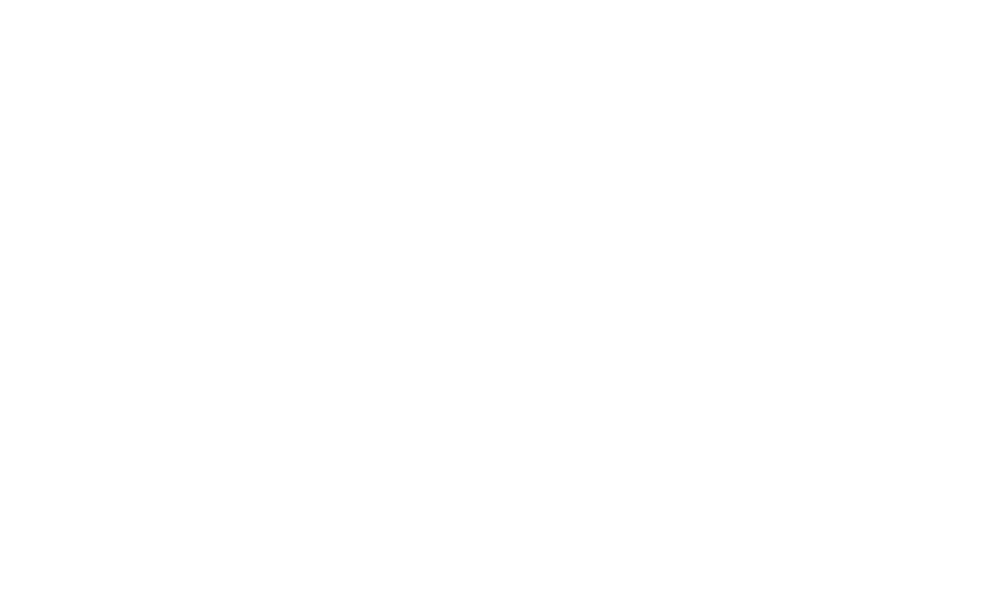

<IPython.core.display.Javascript object>


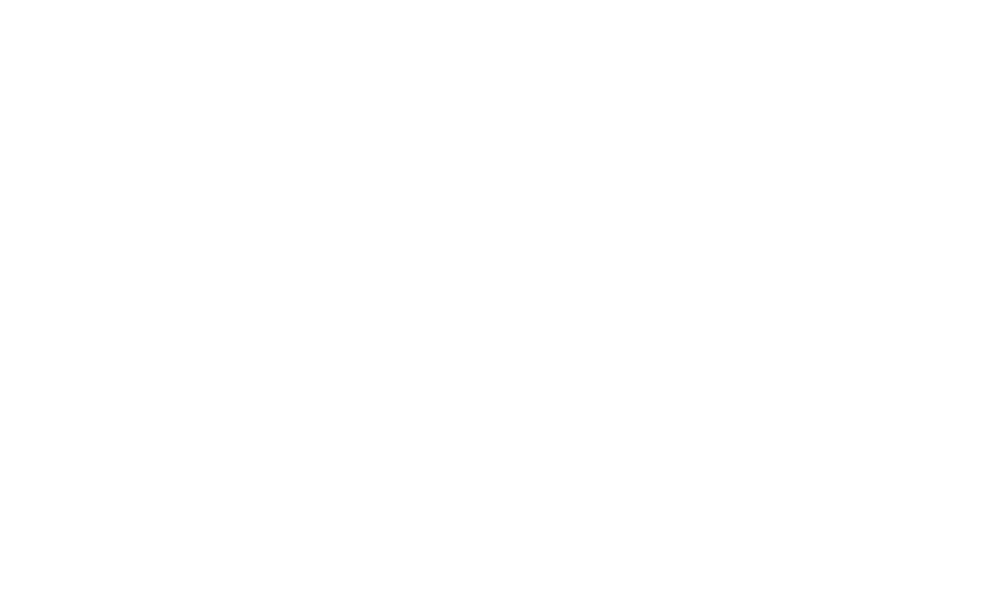

<IPython.core.display.Javascript object>


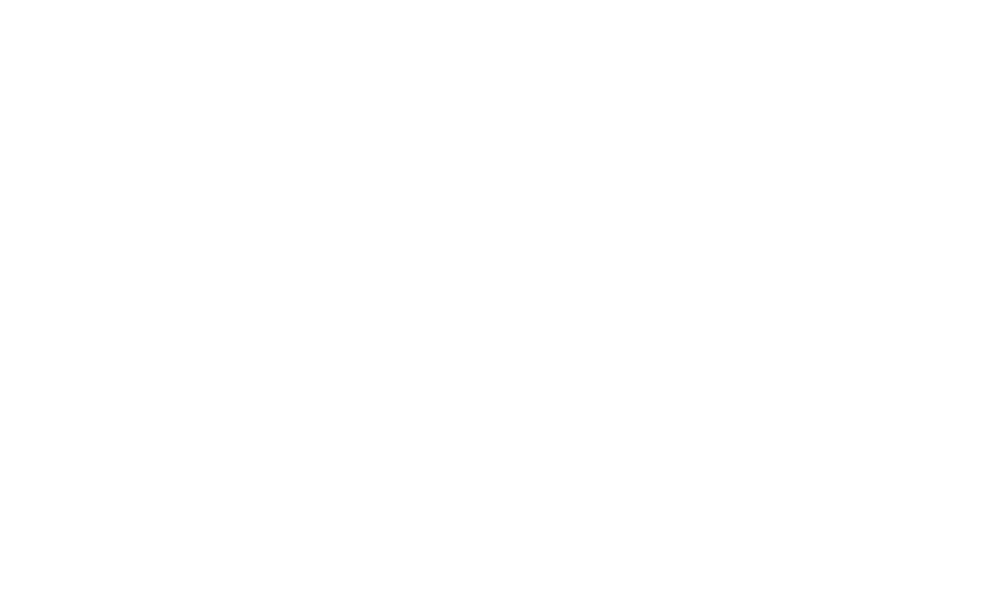

<IPython.core.display.Javascript object>


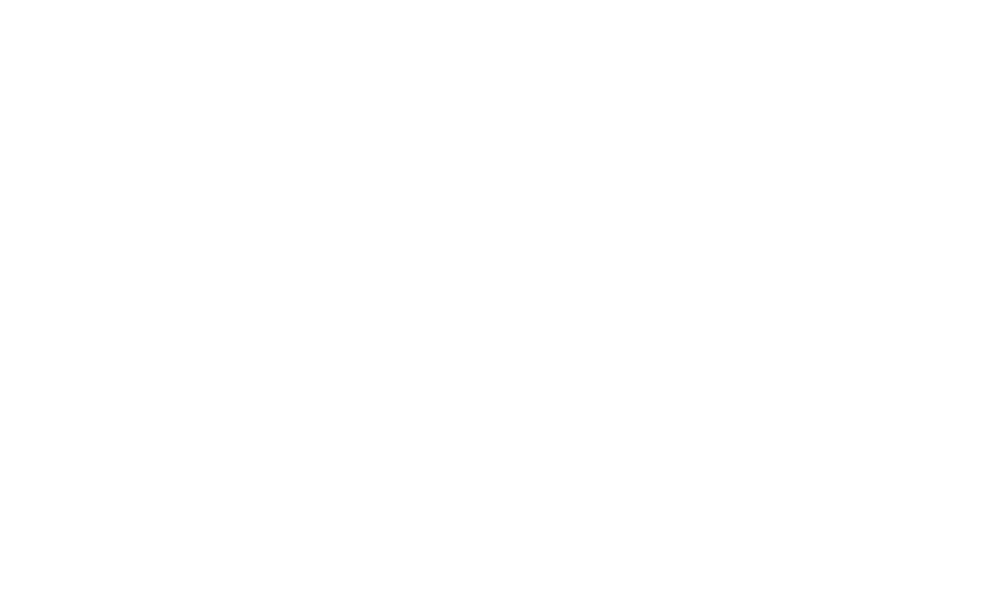

<IPython.core.display.Javascript object>


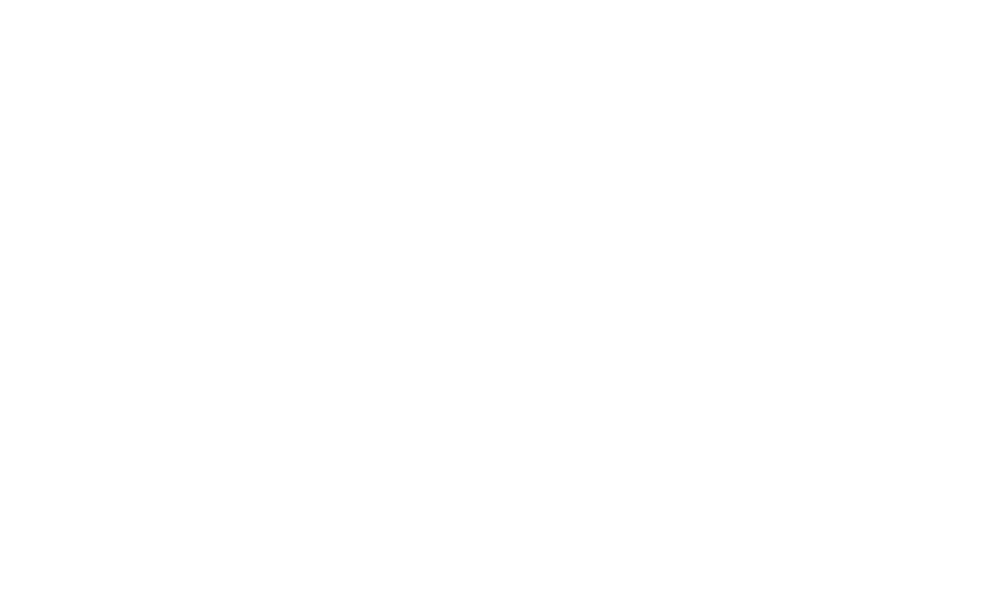

<IPython.core.display.Javascript object>


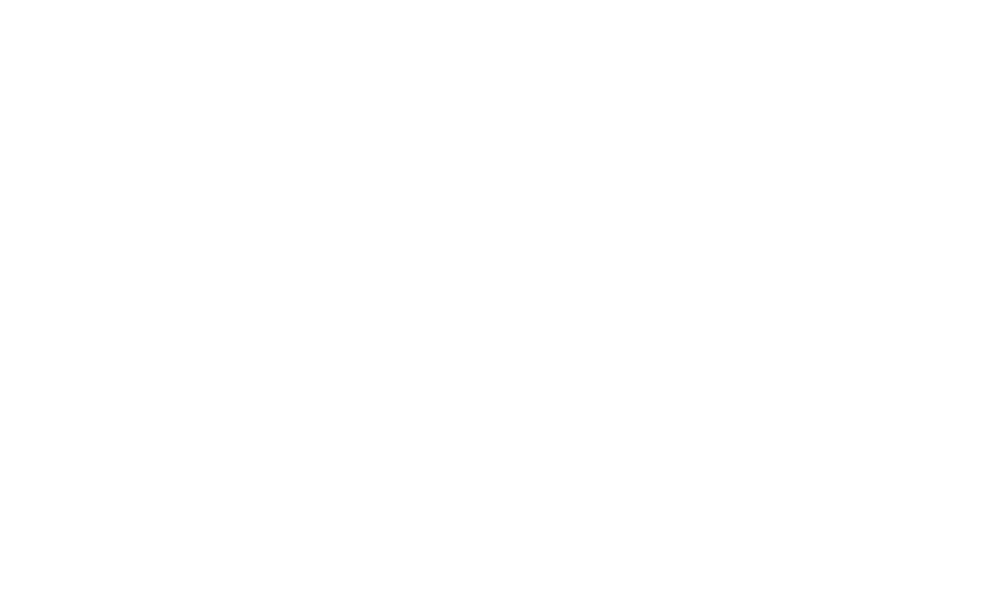

<IPython.core.display.Javascript object>


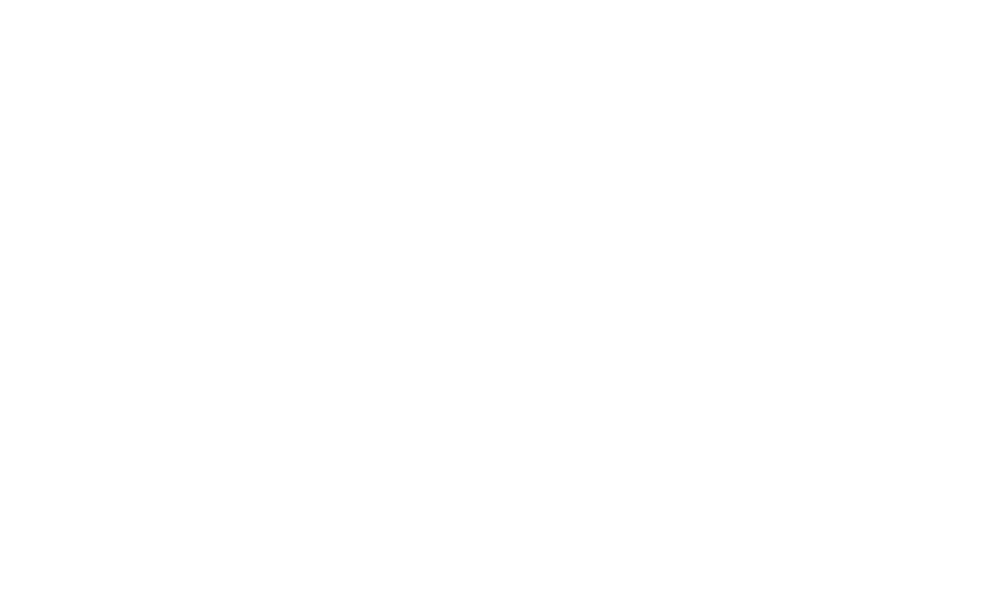

<IPython.core.display.Javascript object>


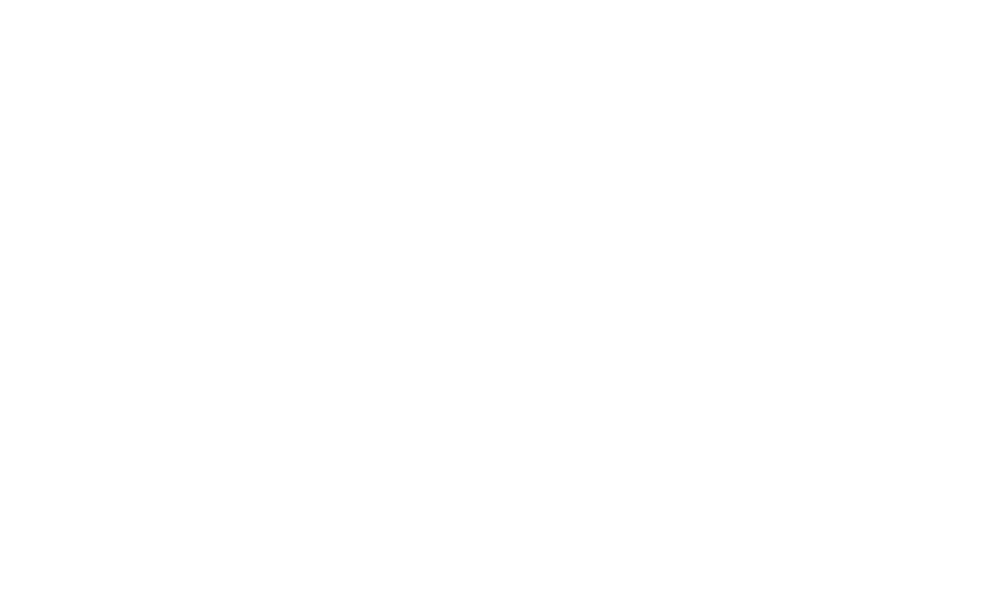

<IPython.core.display.Javascript object>


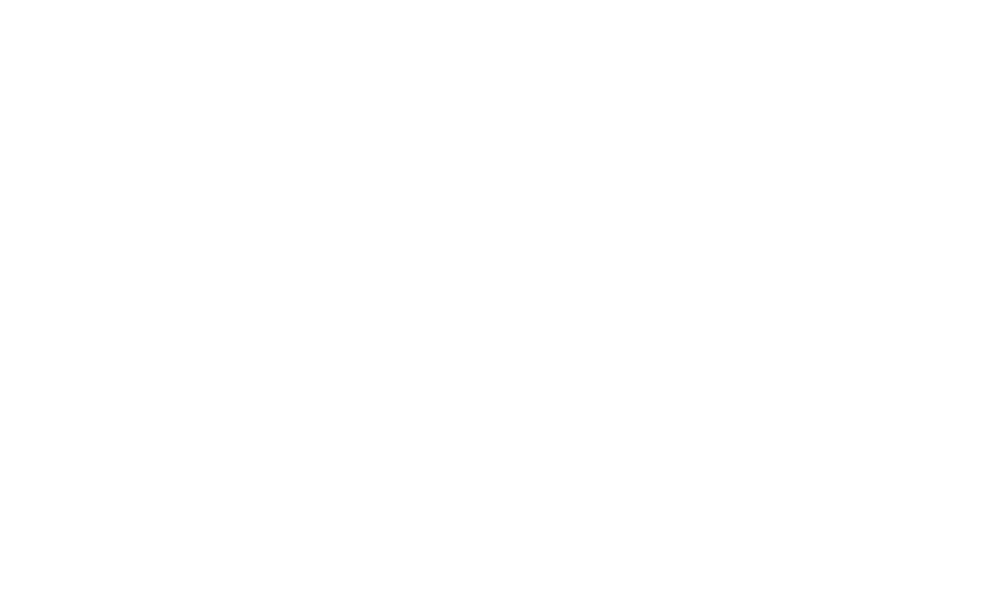

<IPython.core.display.Javascript object>


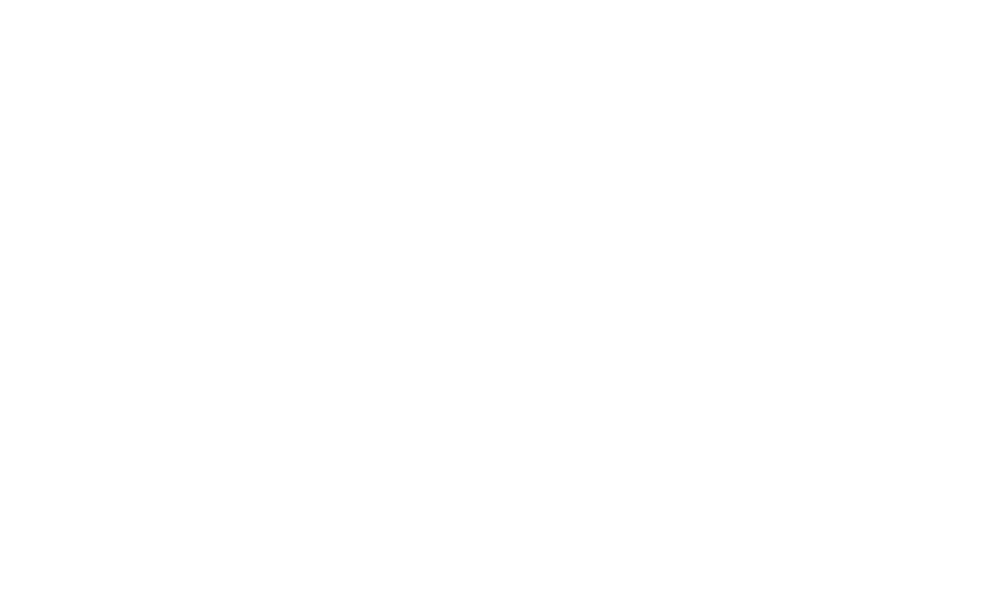

<IPython.core.display.Javascript object>


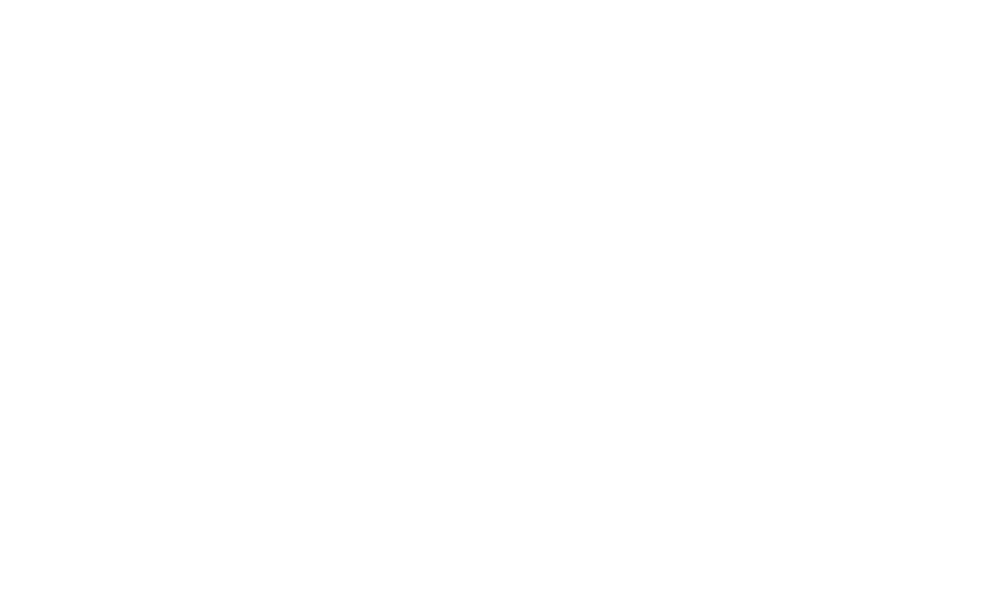

<IPython.core.display.Javascript object>


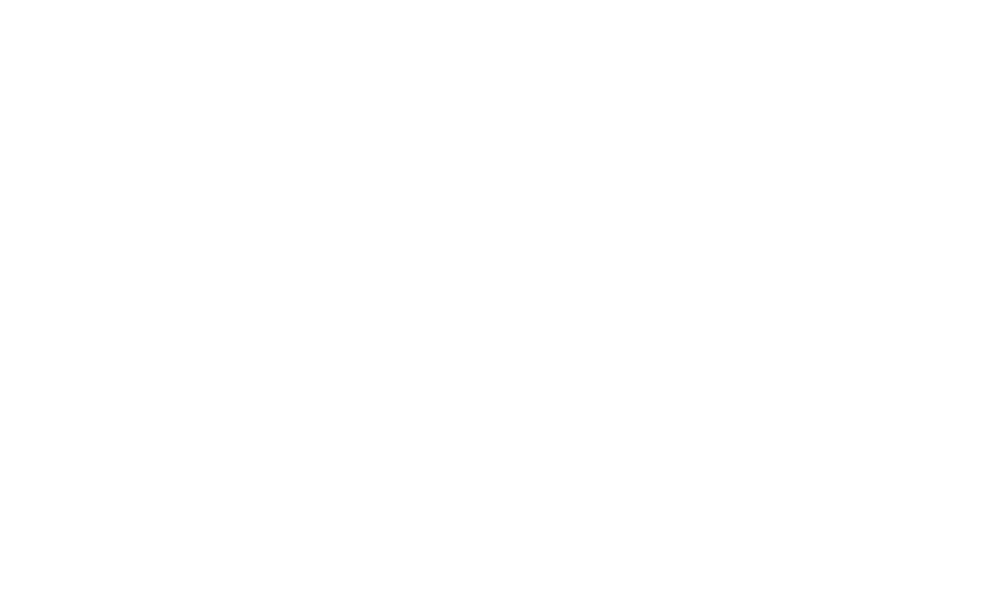

<IPython.core.display.Javascript object>


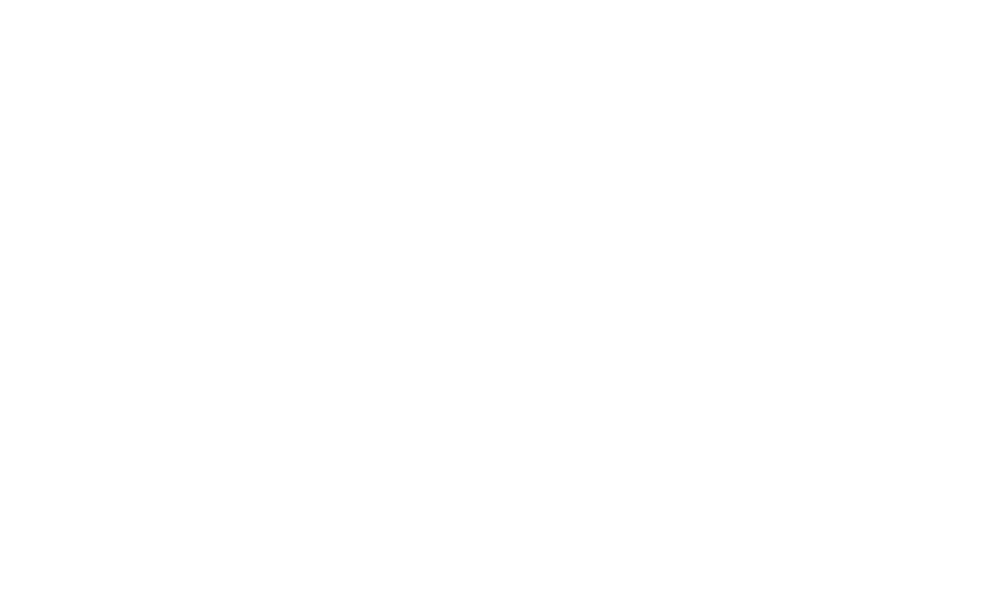

<IPython.core.display.Javascript object>


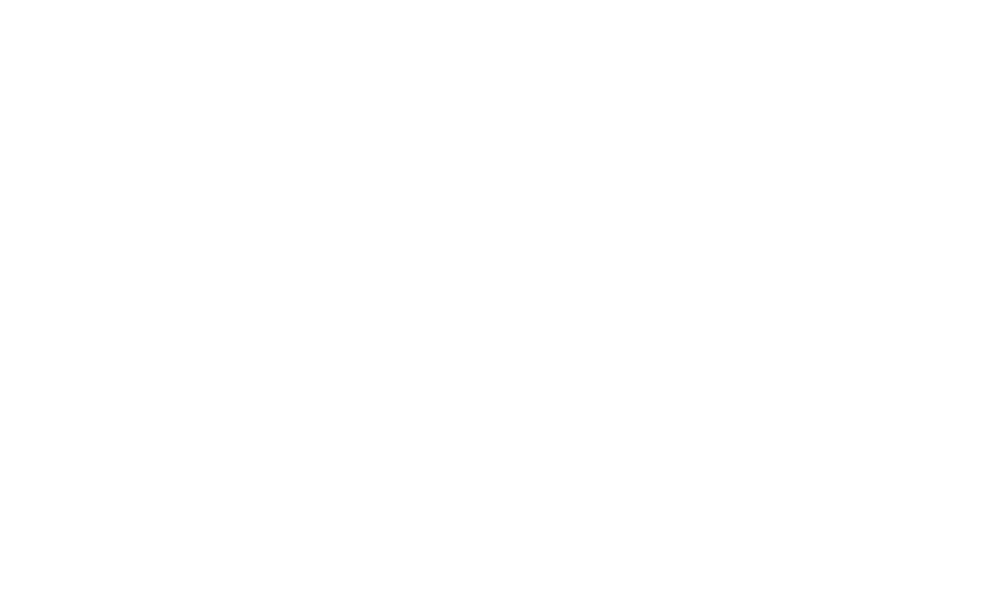

<IPython.core.display.Javascript object>


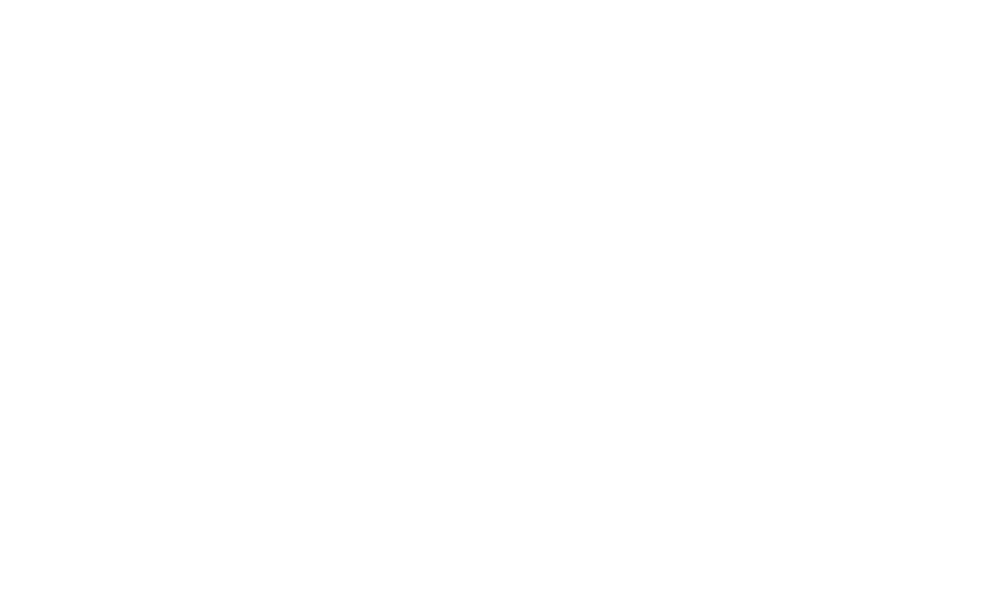

<IPython.core.display.Javascript object>


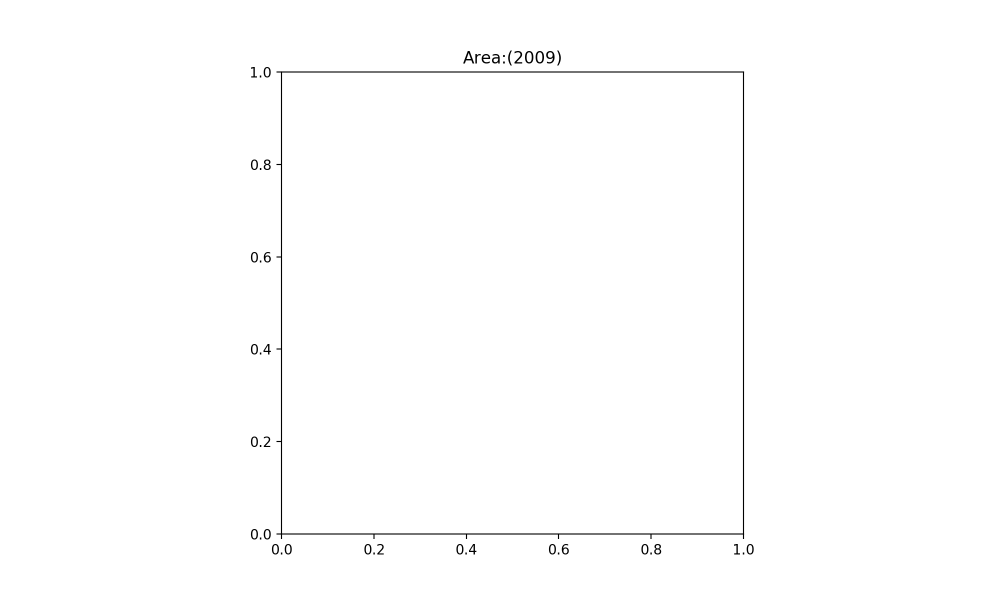

Area:2009 has no data


<IPython.core.display.Javascript object>


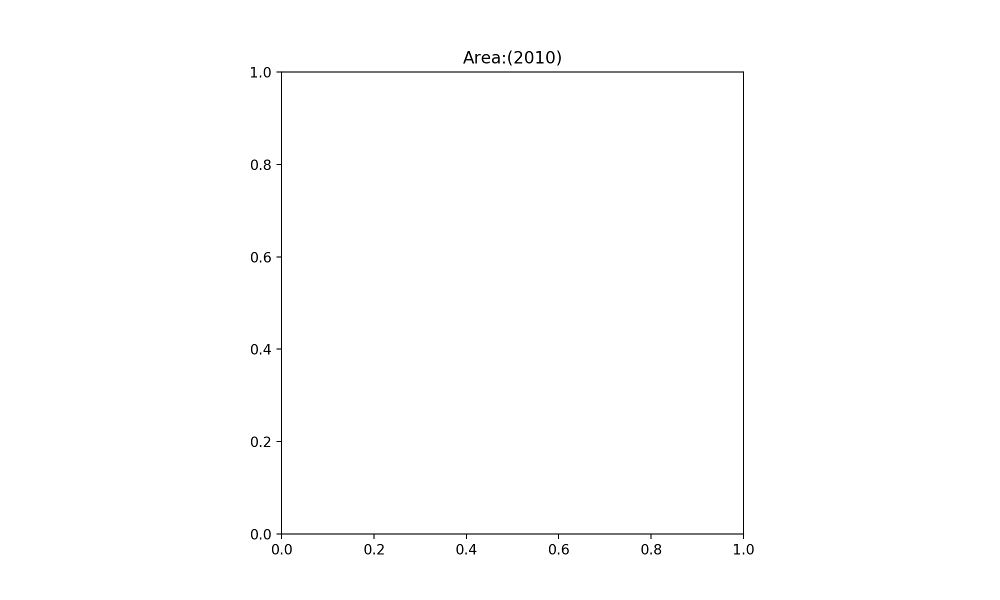

Area:2010 has no data


<IPython.core.display.Javascript object>


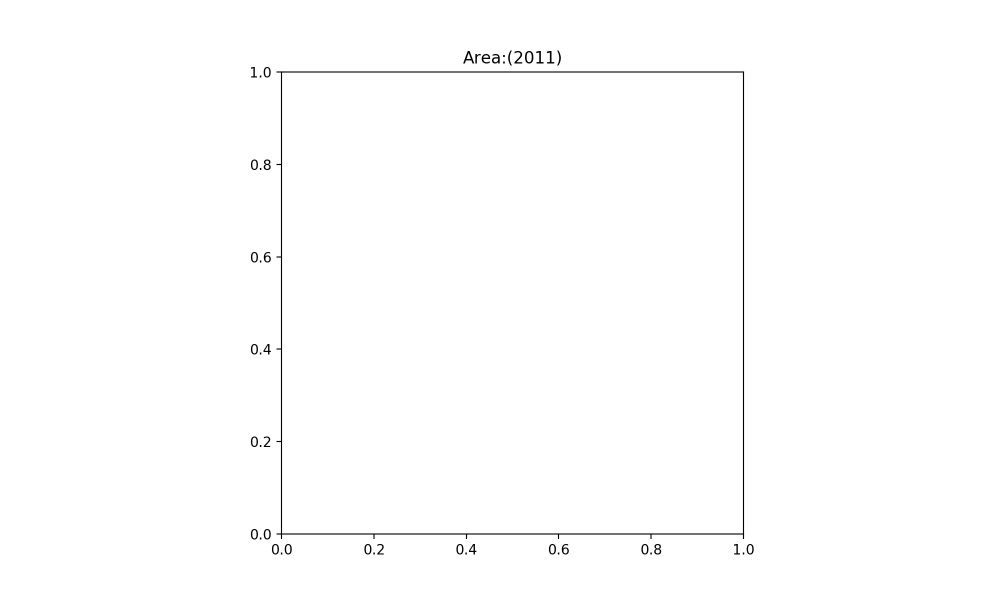

Area:2011 has no data


<IPython.core.display.Javascript object>


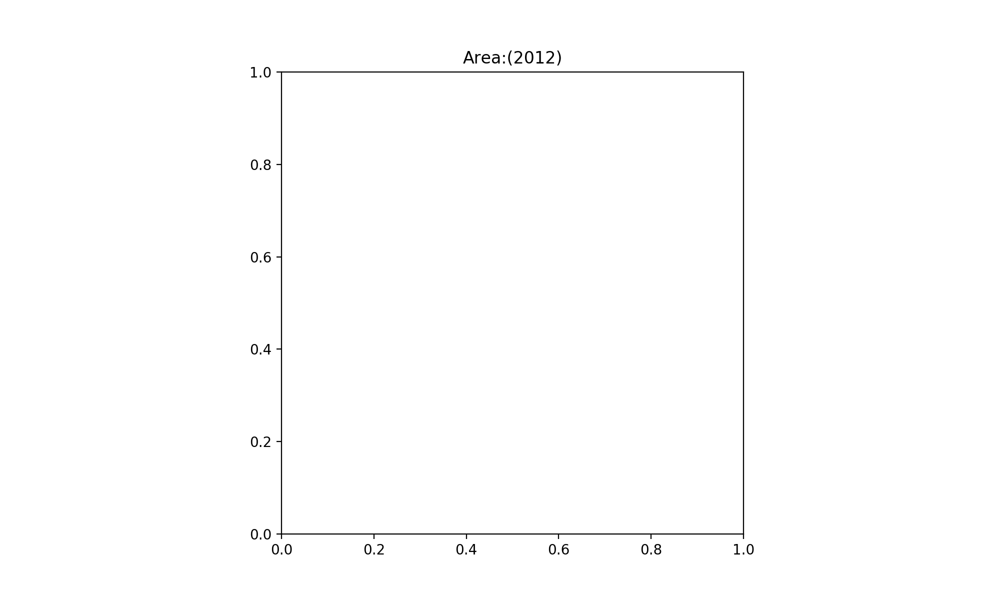

Area:2012 has no data


<IPython.core.display.Javascript object>


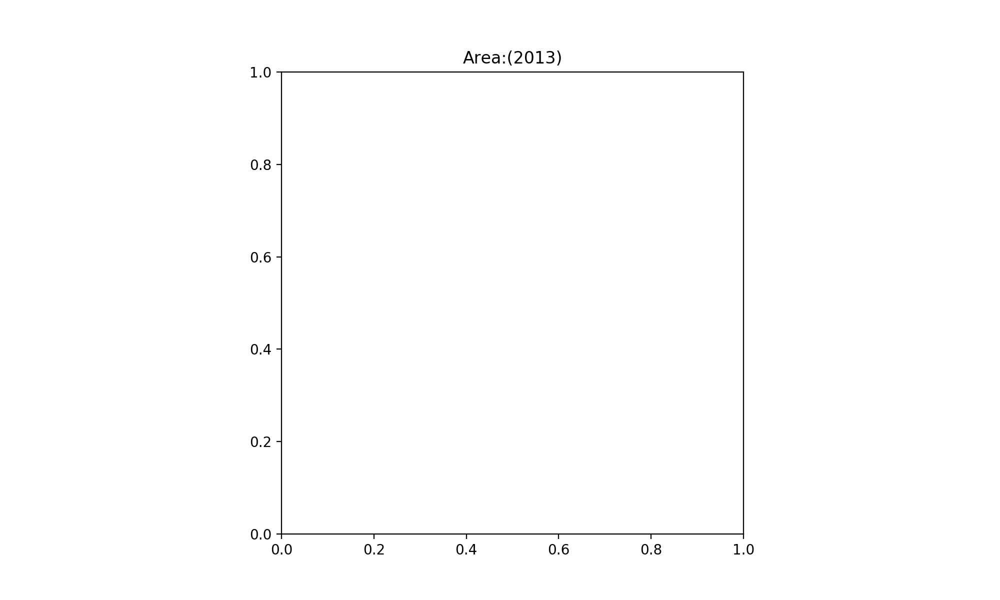

Area:2013 has no data


<IPython.core.display.Javascript object>


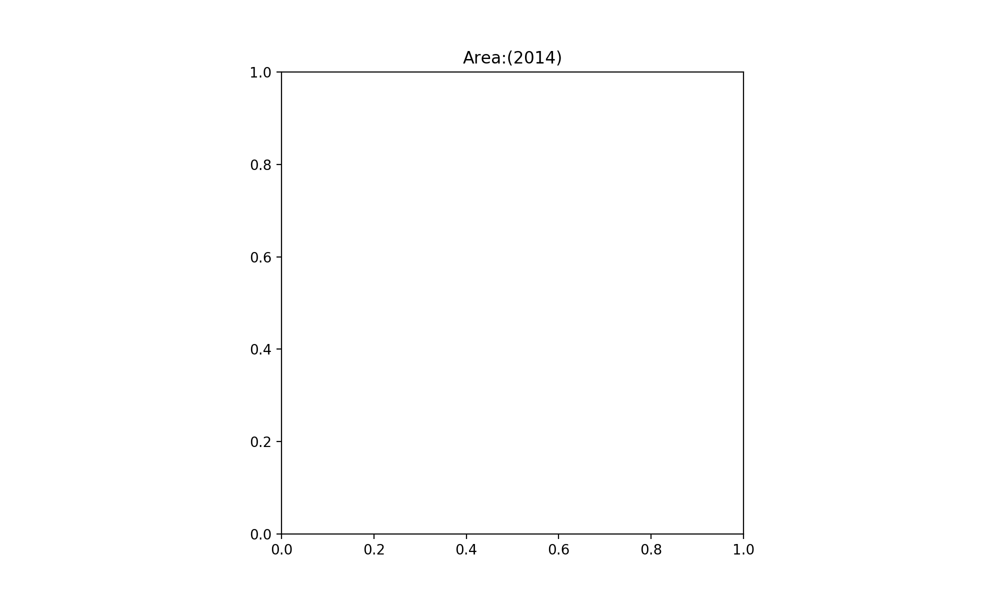

Area:2014 has no data


<IPython.core.display.Javascript object>


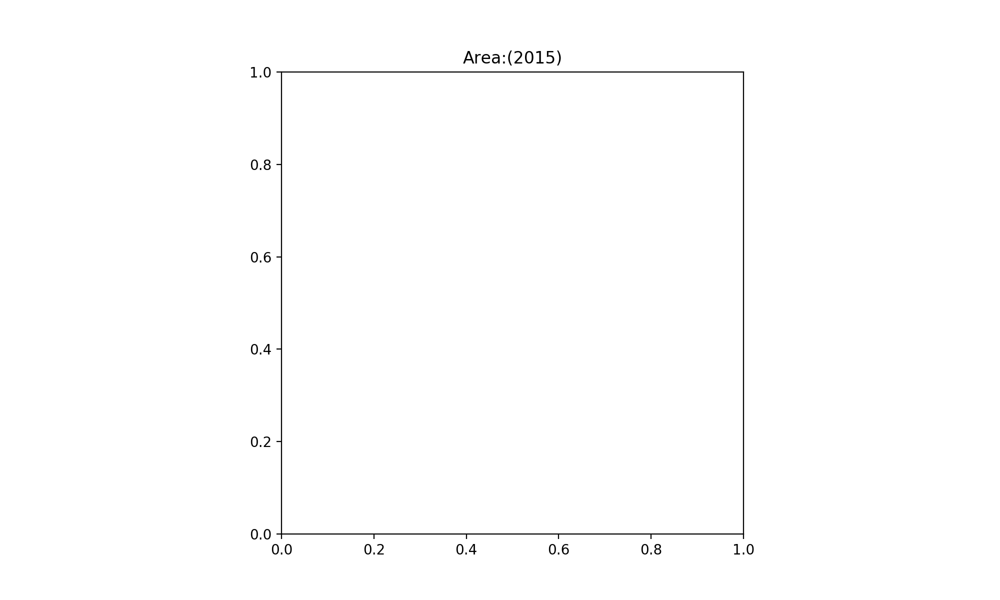

Area:2015 has no data


<IPython.core.display.Javascript object>


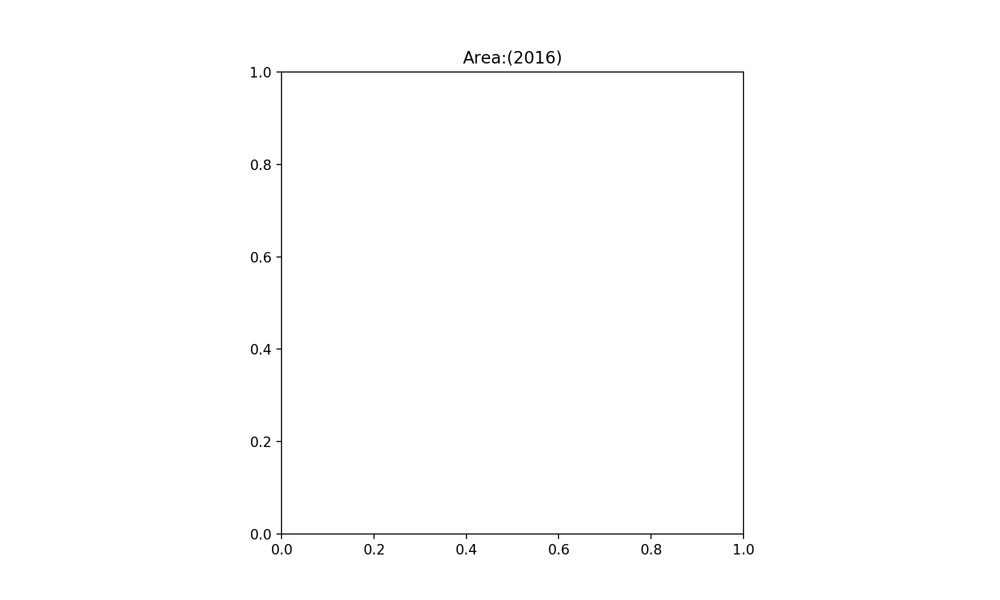

Area:2016 has no data


<IPython.core.display.Javascript object>


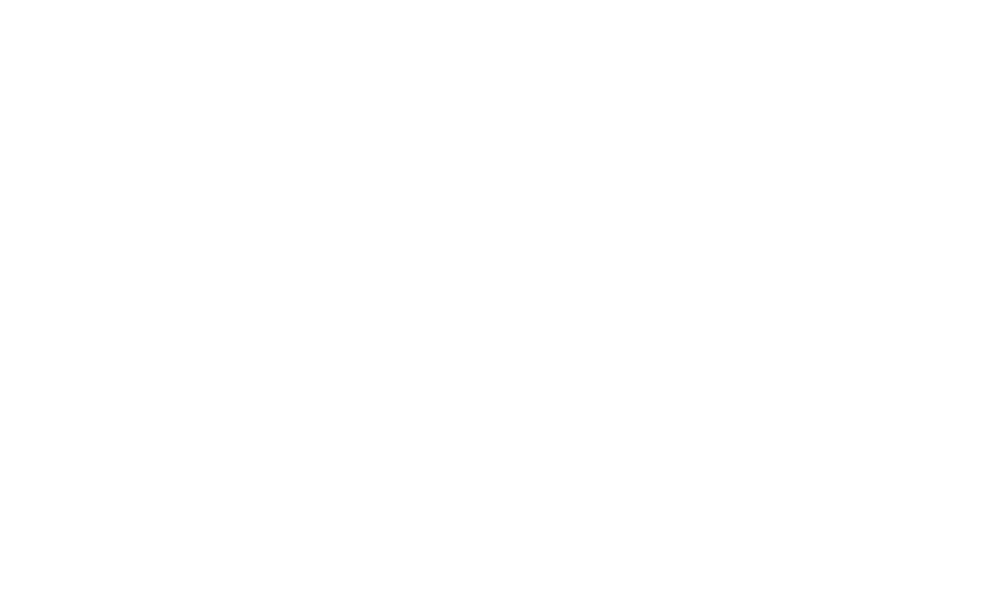

<IPython.core.display.Javascript object>


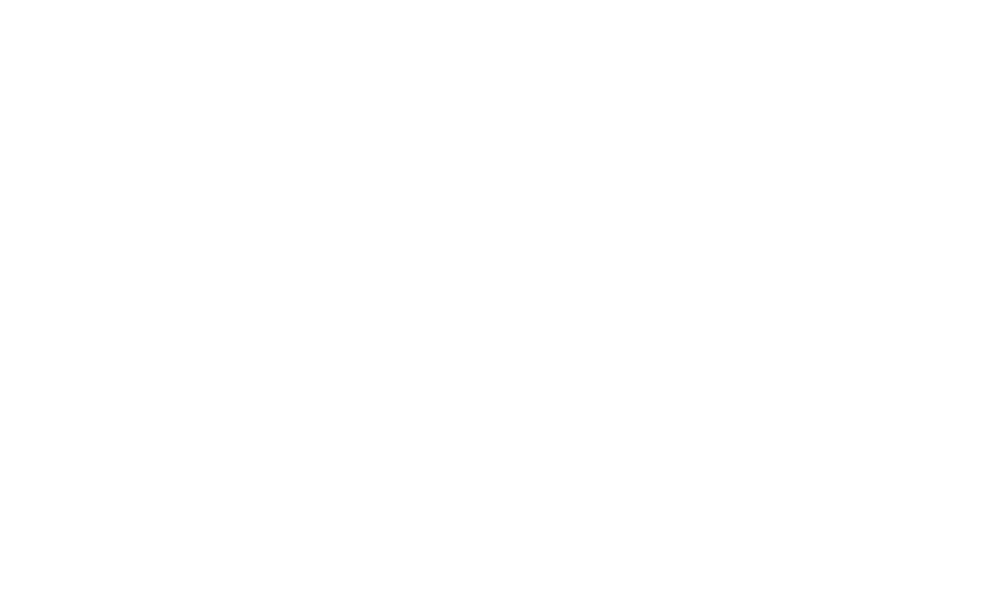

<IPython.core.display.Javascript object>


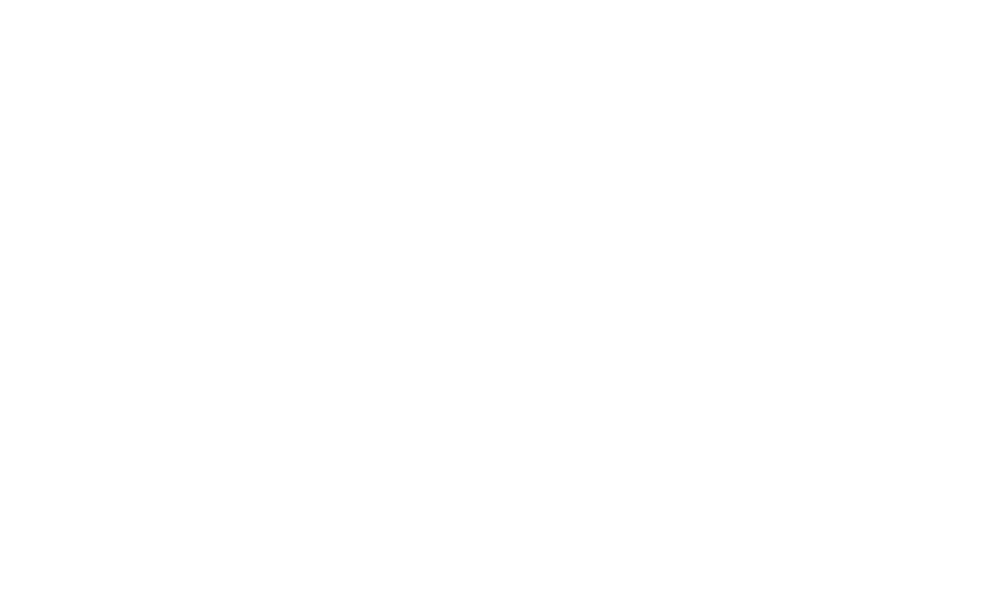

<IPython.core.display.Javascript object>


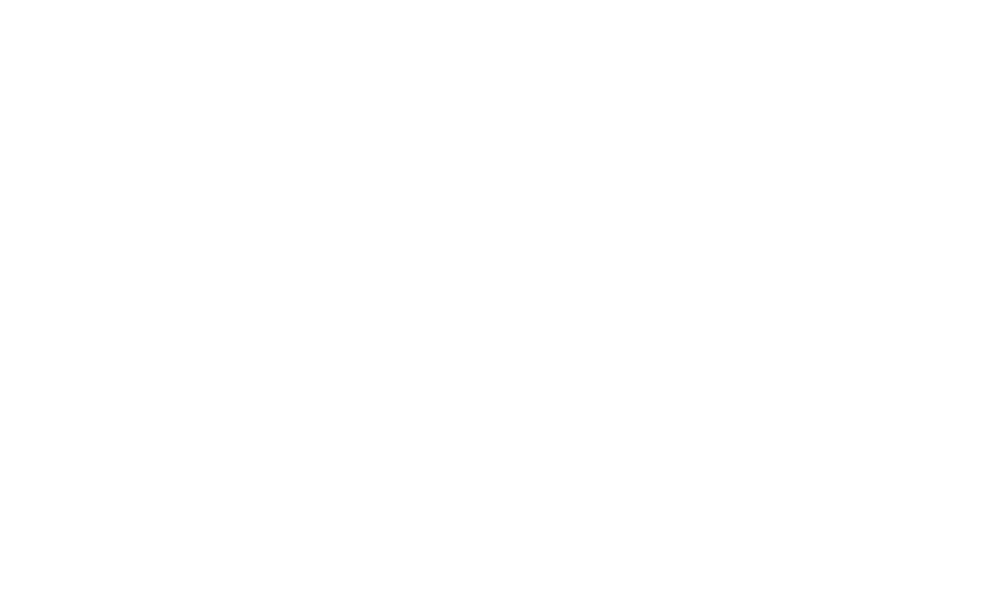

<IPython.core.display.Javascript object>


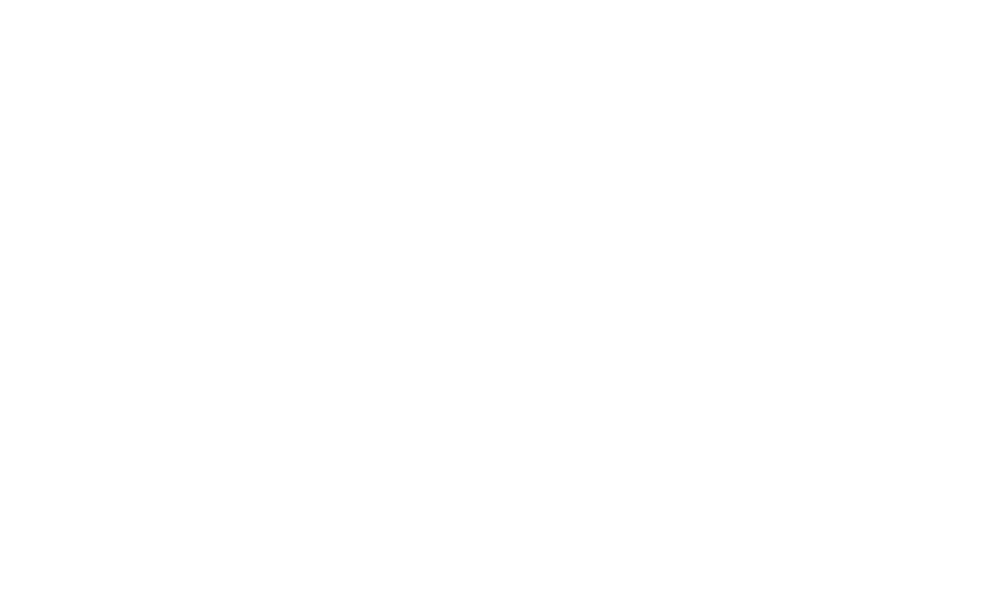

<IPython.core.display.Javascript object>


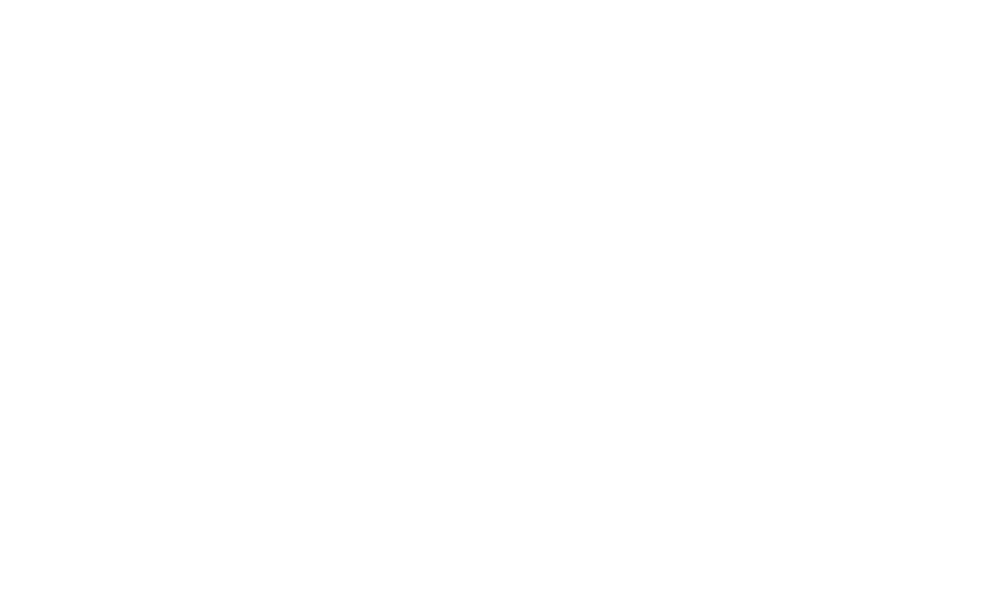

<IPython.core.display.Javascript object>


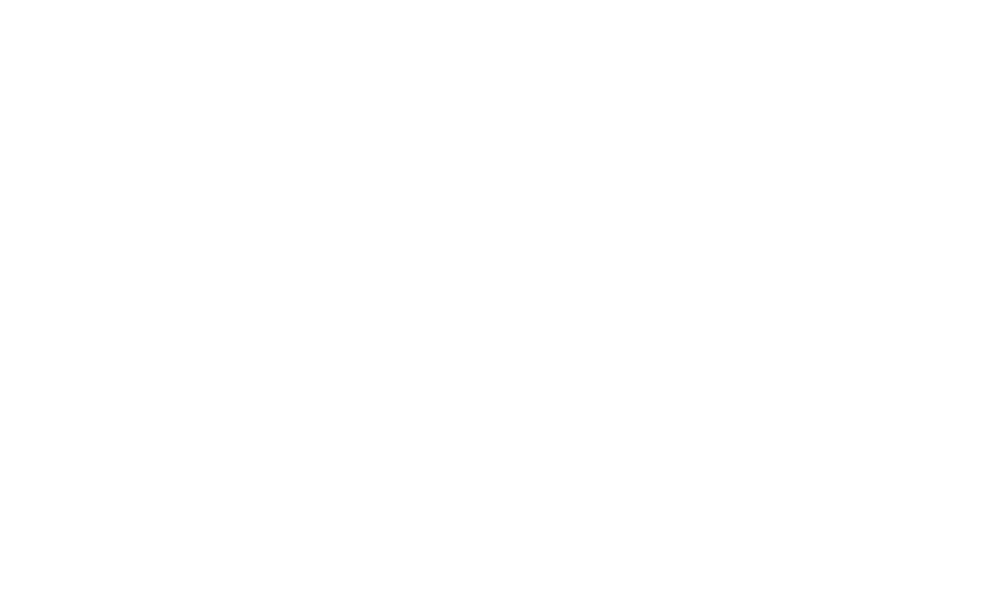

<IPython.core.display.Javascript object>


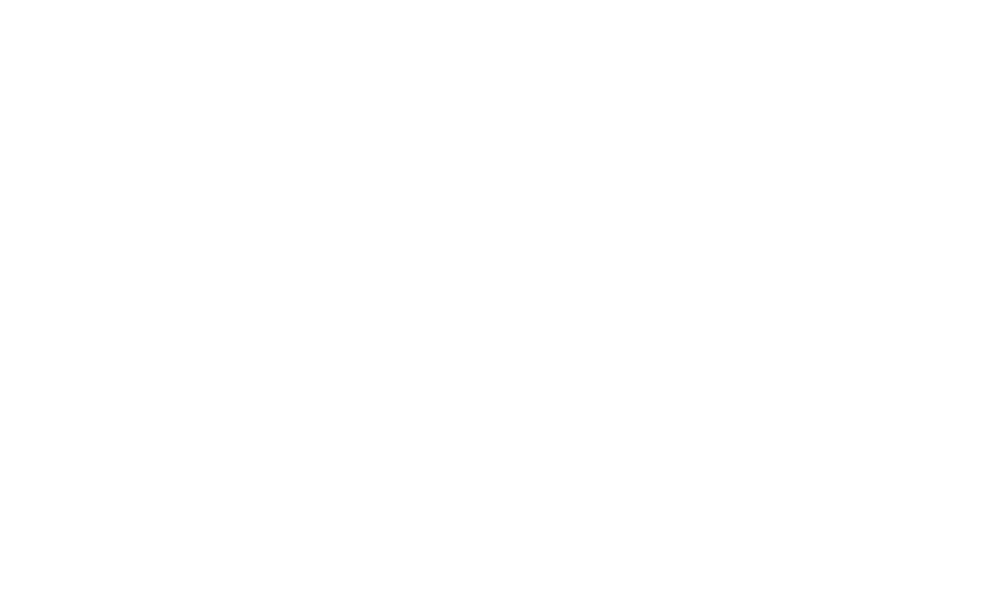

<IPython.core.display.Javascript object>


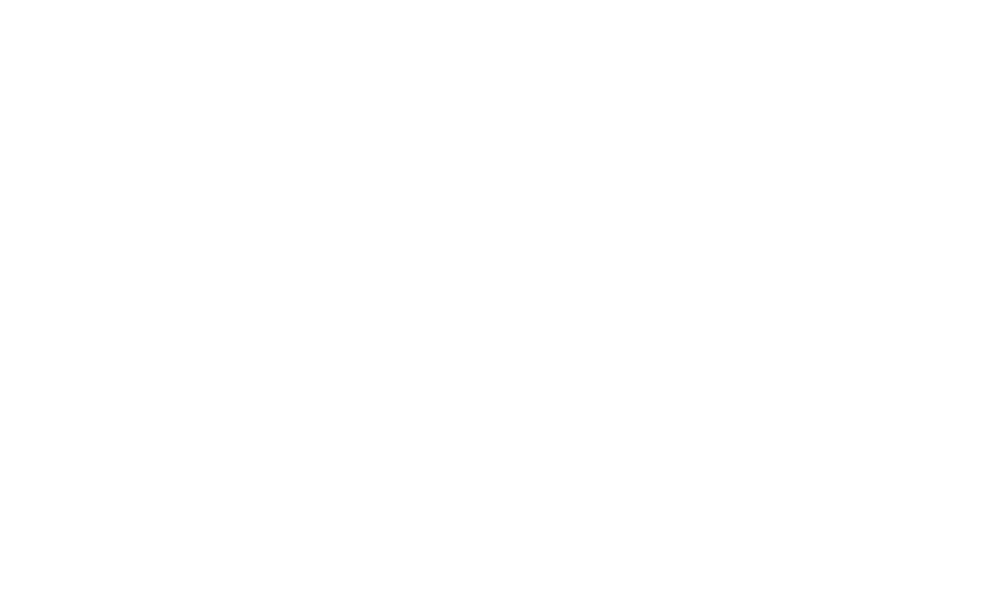

<IPython.core.display.Javascript object>


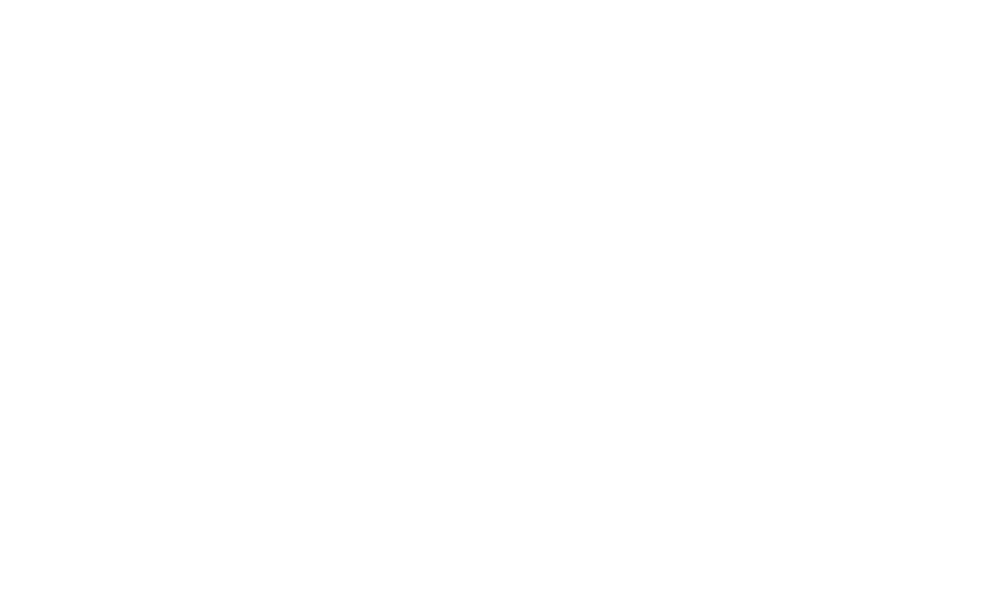

<IPython.core.display.Javascript object>


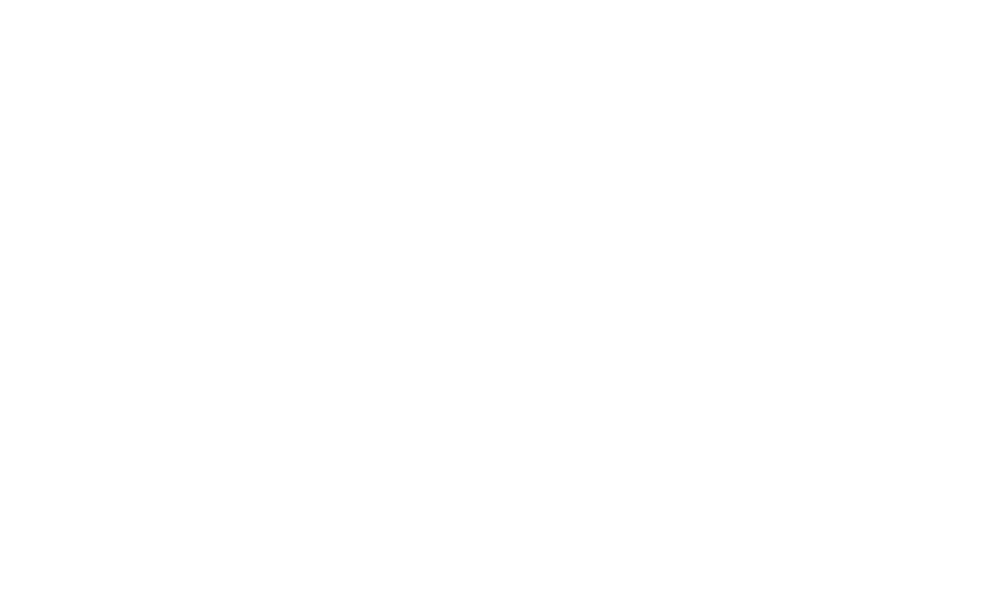

<IPython.core.display.Javascript object>


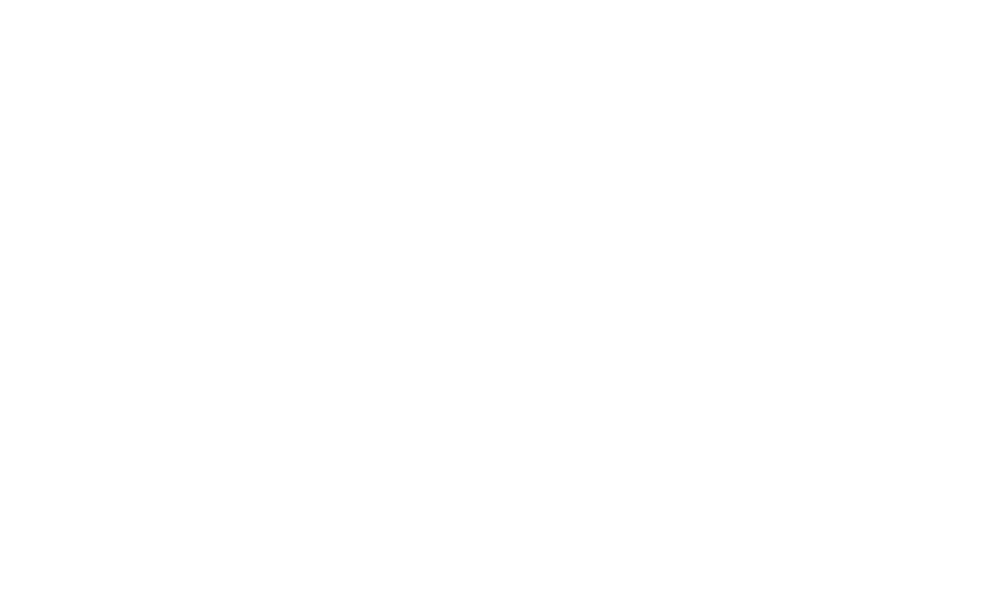

<IPython.core.display.Javascript object>


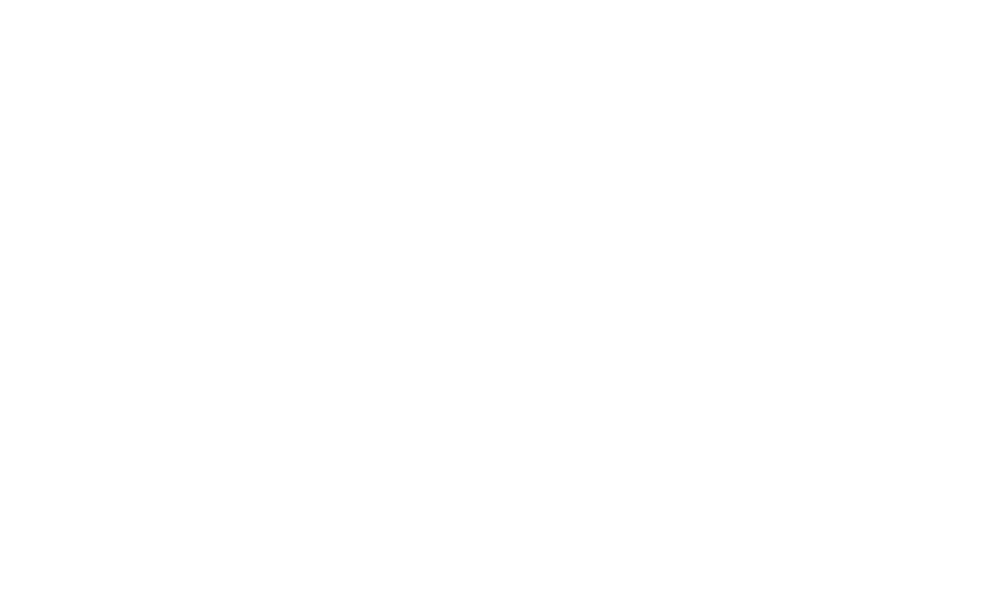

<IPython.core.display.Javascript object>


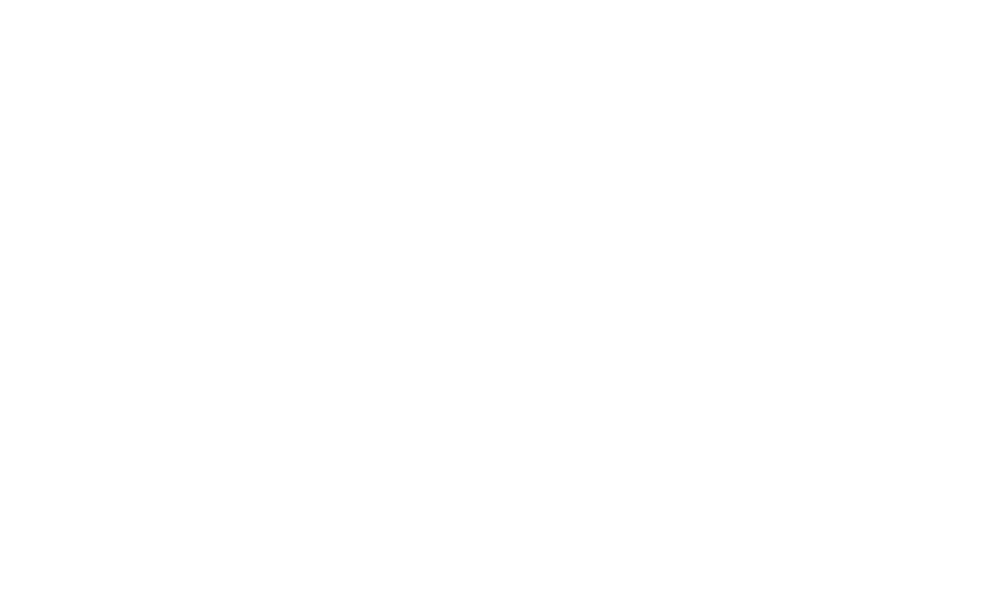

<IPython.core.display.Javascript object>


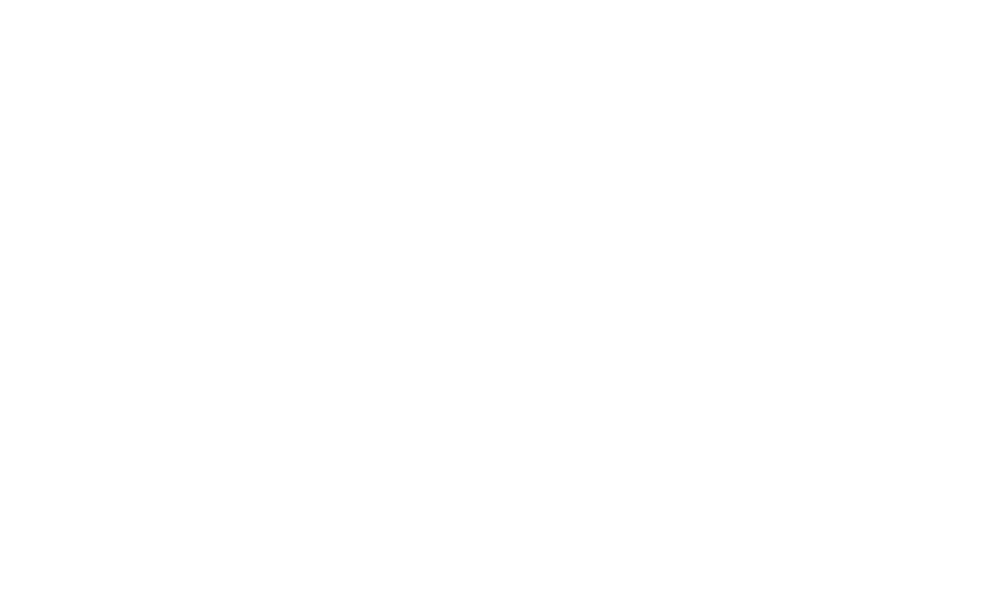

<IPython.core.display.Javascript object>


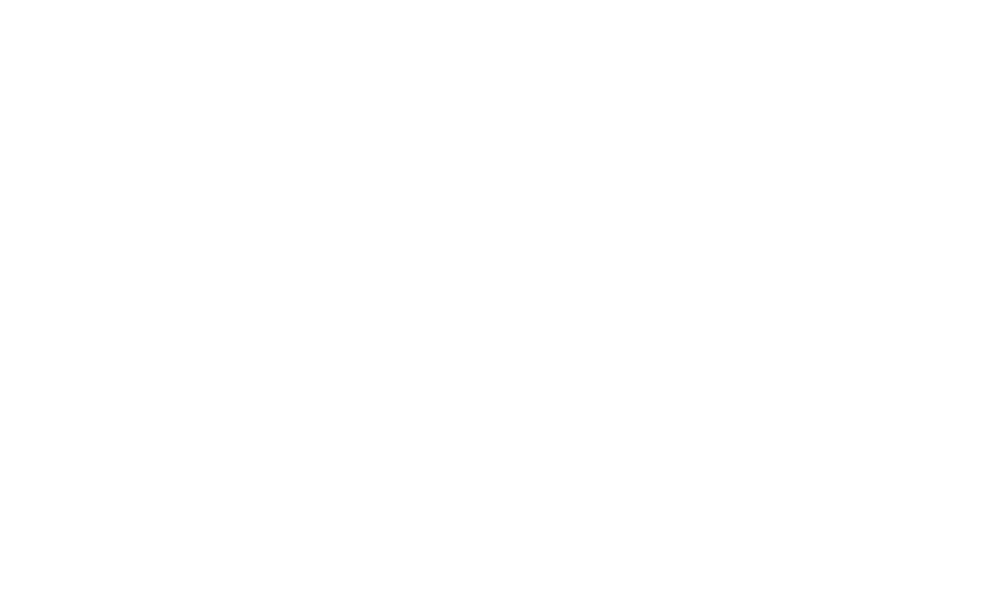

<IPython.core.display.Javascript object>


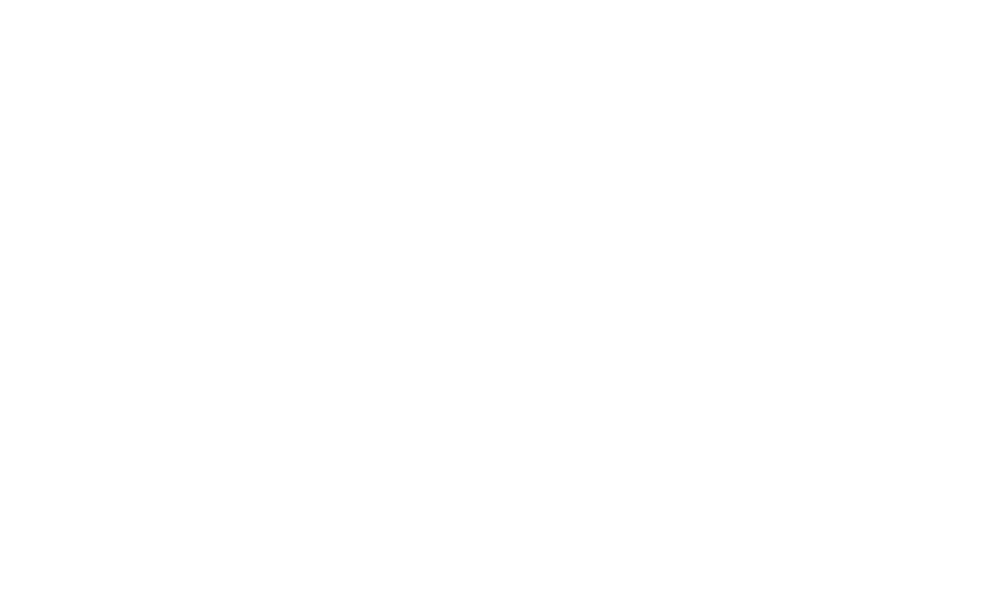

<IPython.core.display.Javascript object>


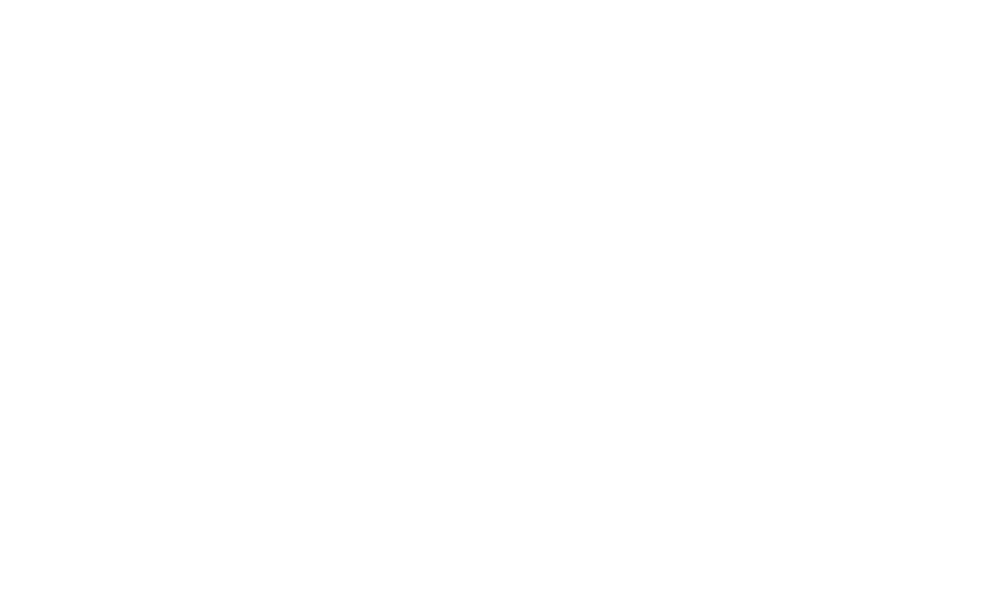

<IPython.core.display.Javascript object>


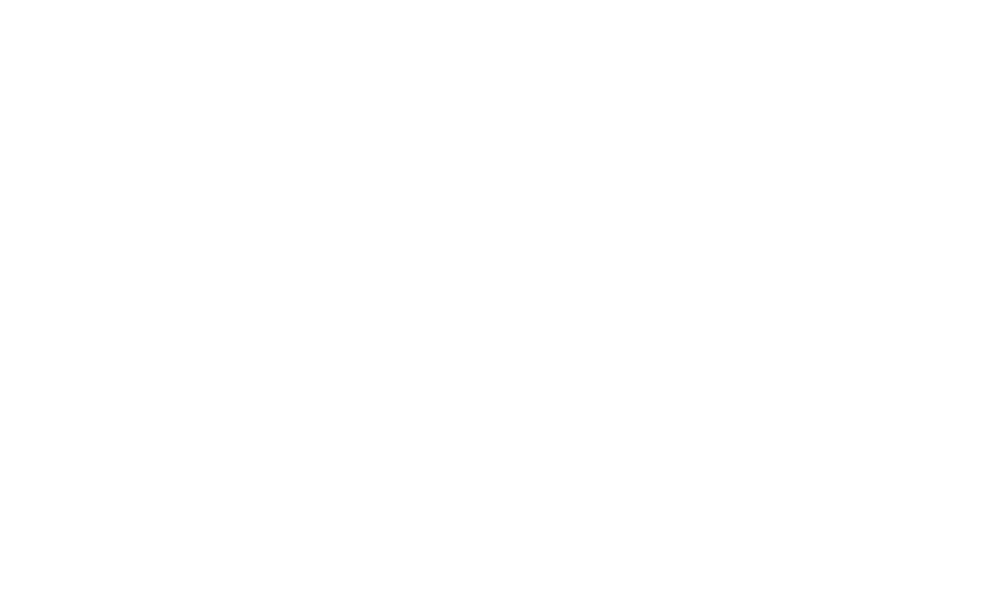

<IPython.core.display.Javascript object>


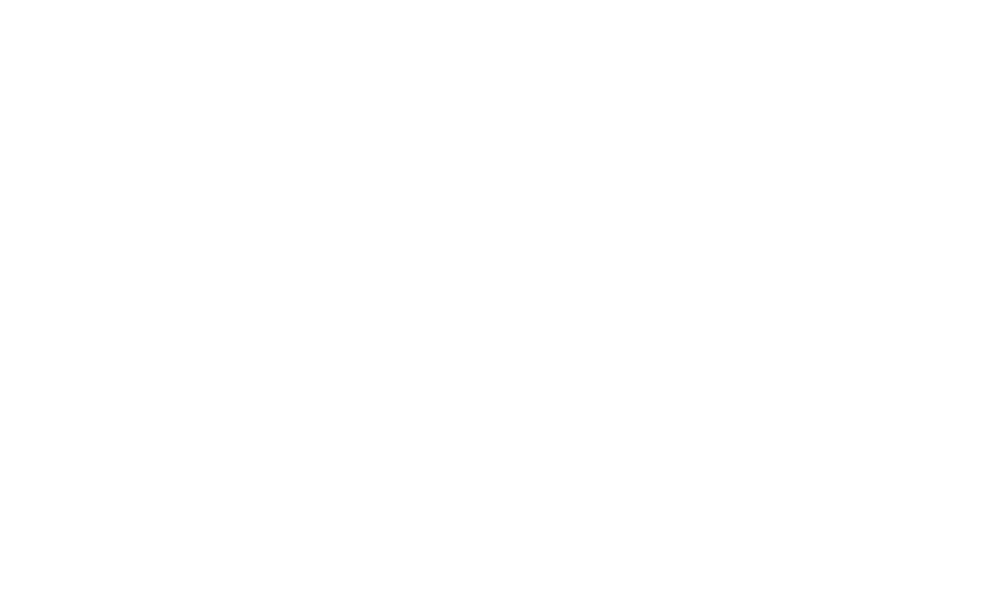

<IPython.core.display.Javascript object>


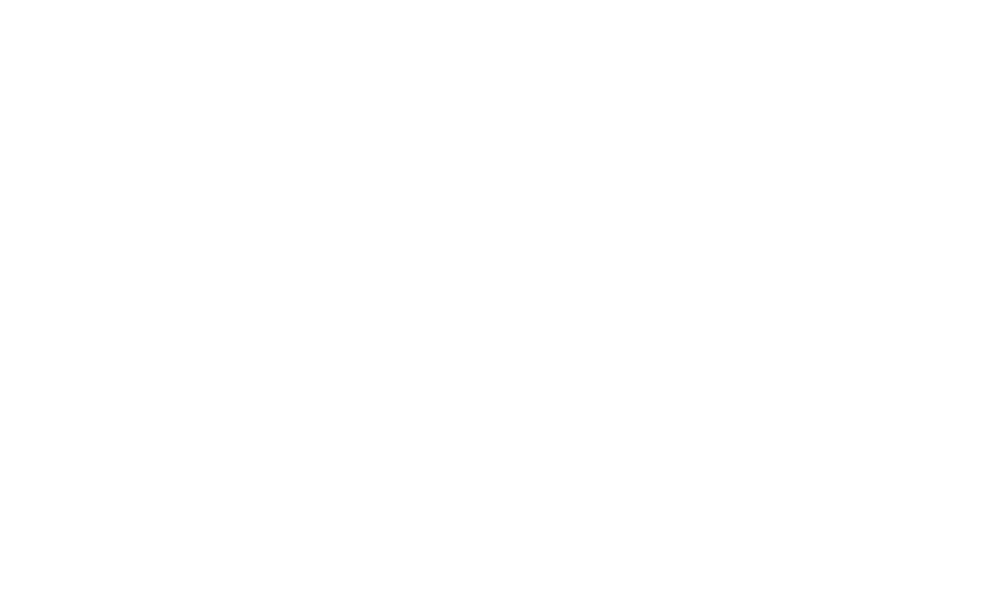

<IPython.core.display.Javascript object>


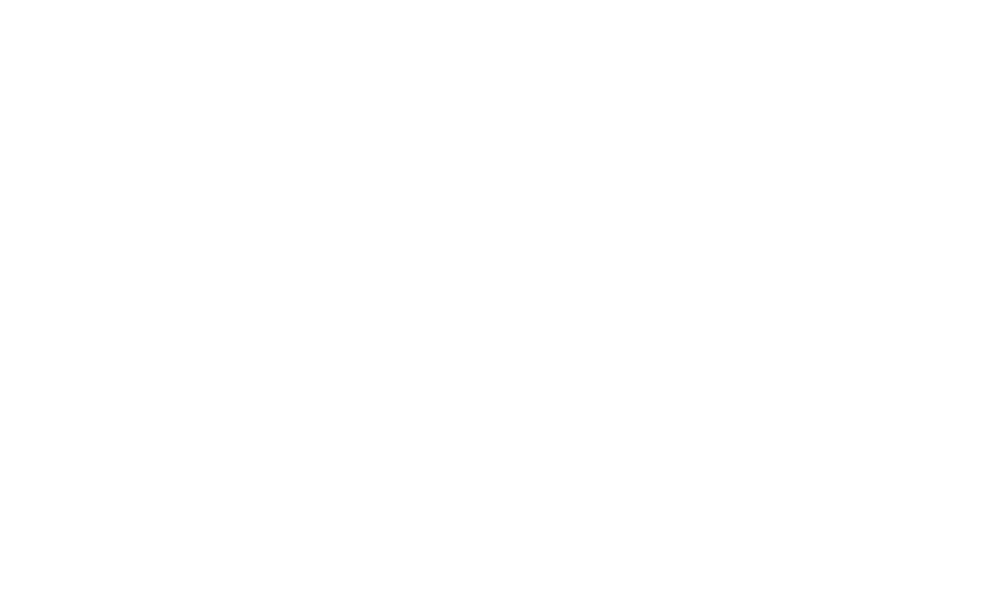

<IPython.core.display.Javascript object>


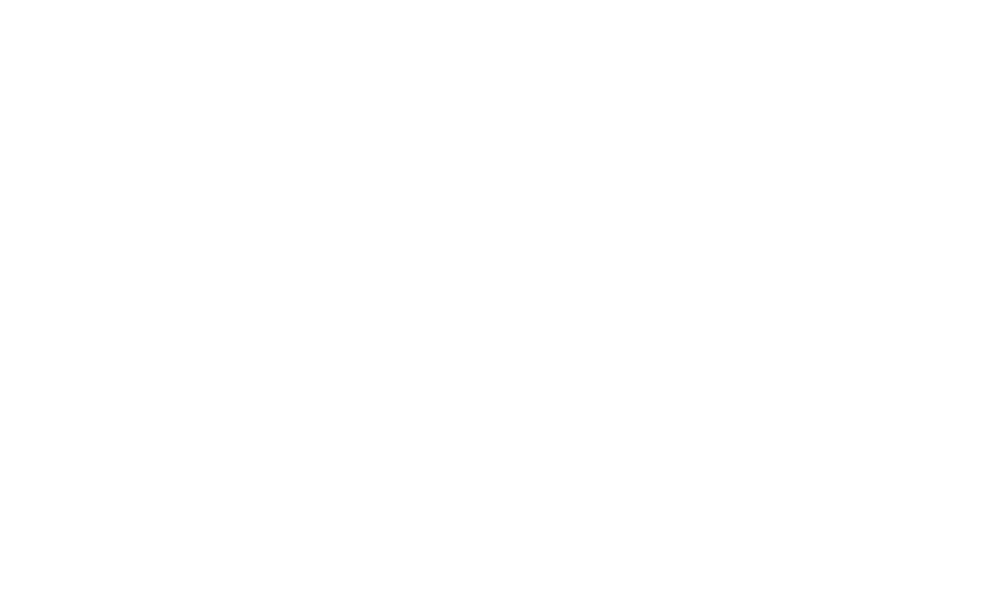

<IPython.core.display.Javascript object>


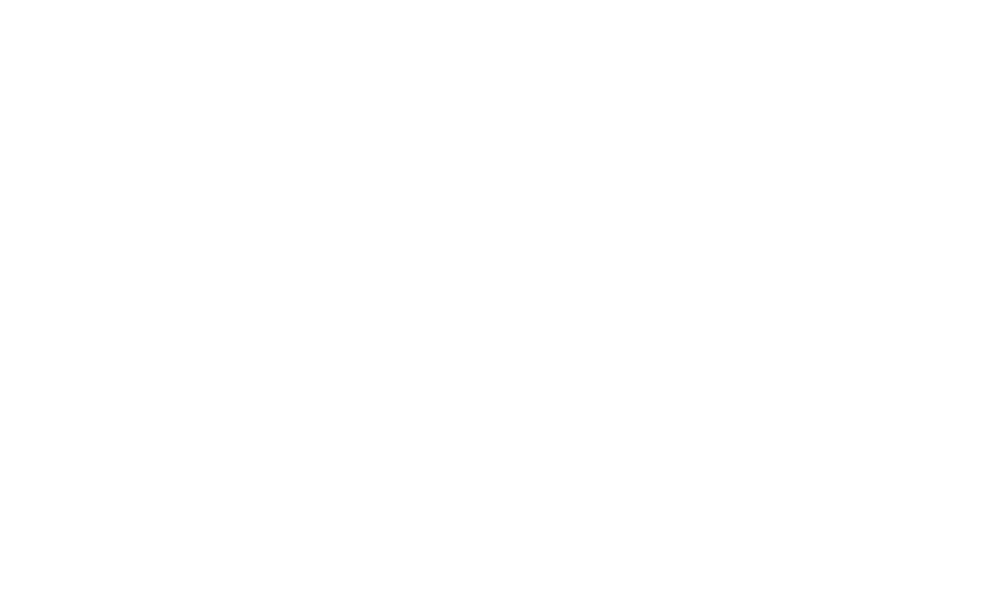

<IPython.core.display.Javascript object>


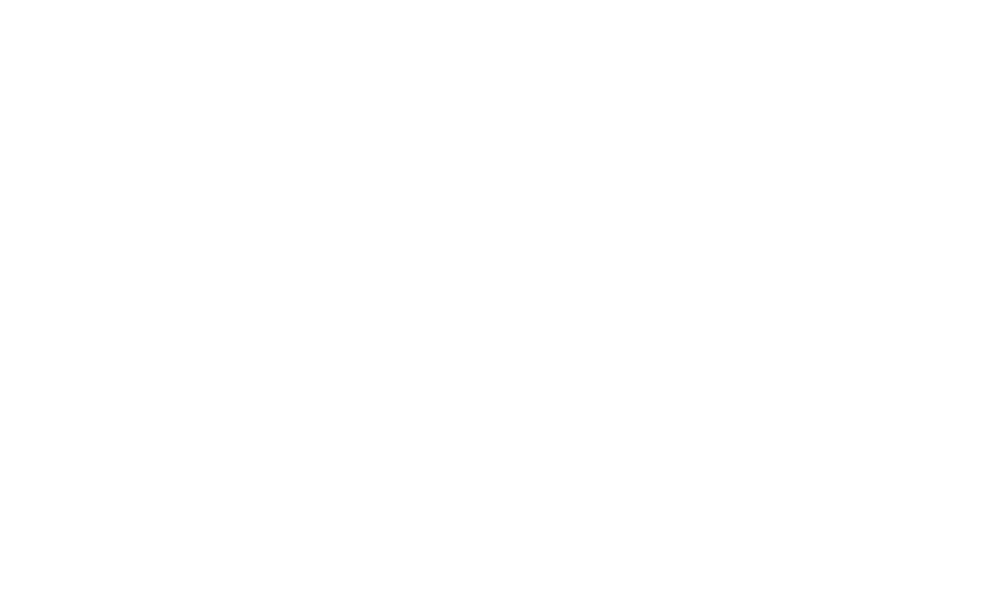

<IPython.core.display.Javascript object>


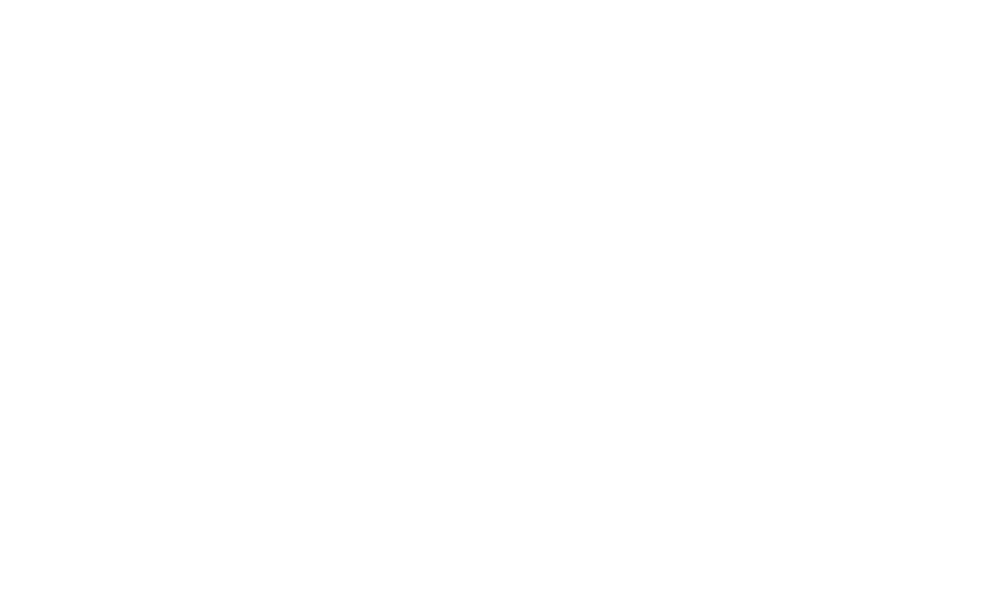

<IPython.core.display.Javascript object>


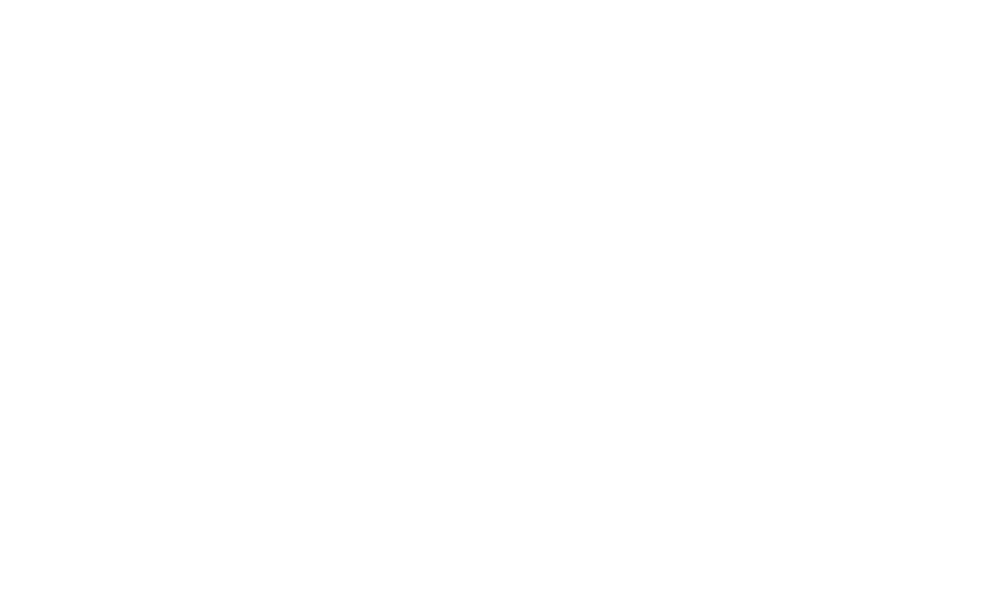

<IPython.core.display.Javascript object>


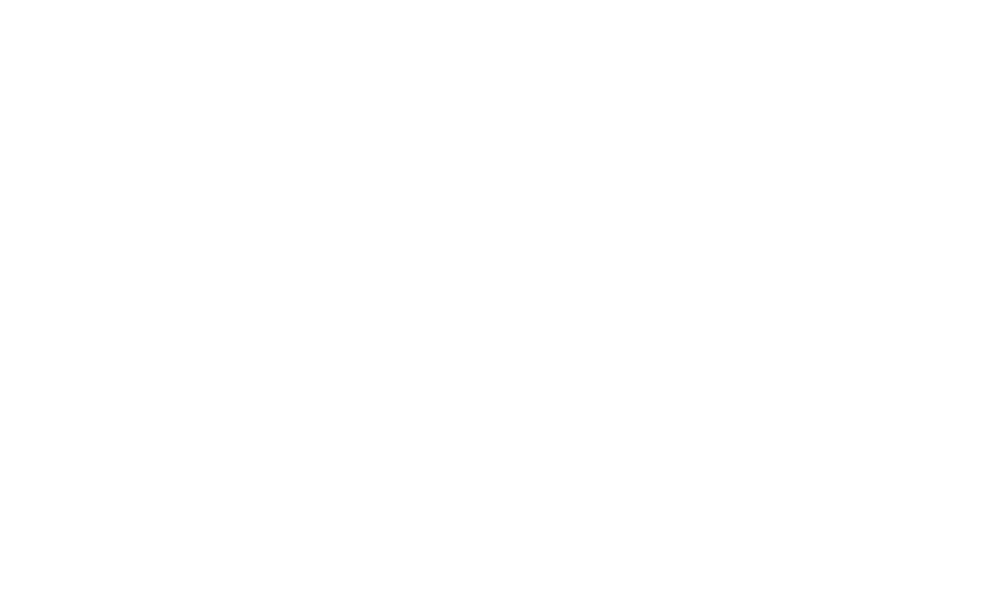

<IPython.core.display.Javascript object>


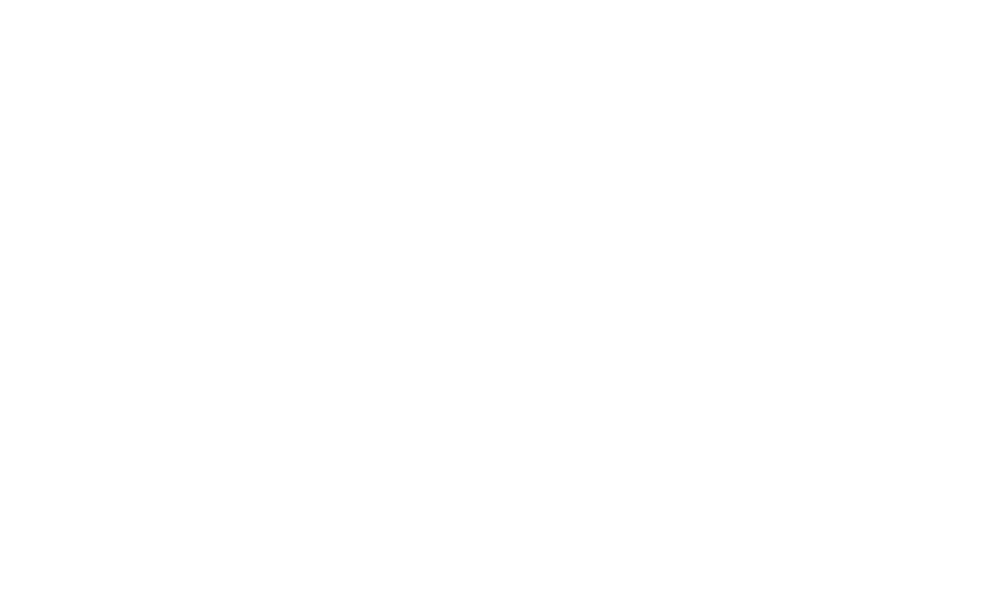

<IPython.core.display.Javascript object>


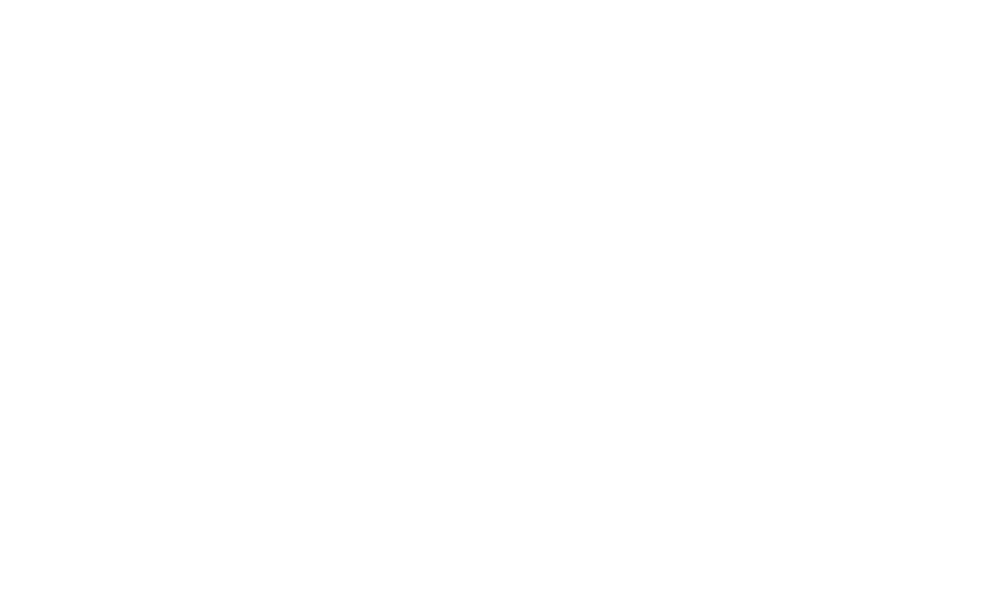

<IPython.core.display.Javascript object>


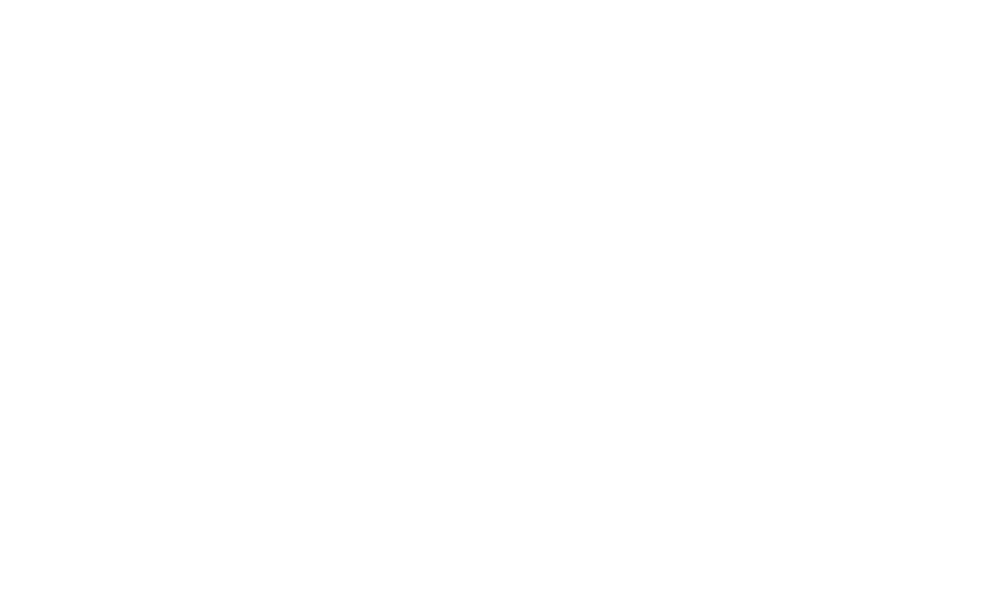

<IPython.core.display.Javascript object>


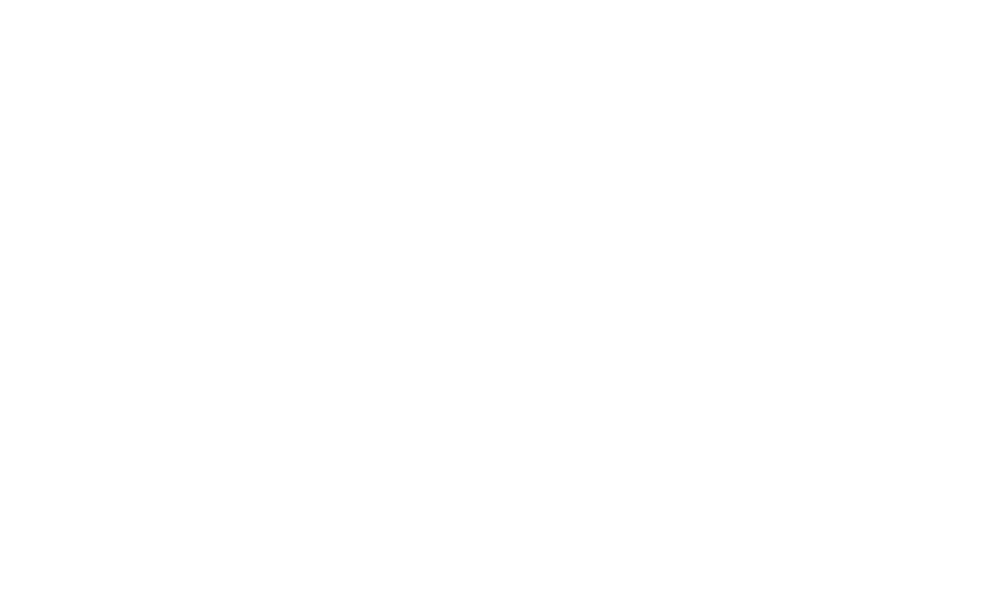

<IPython.core.display.Javascript object>


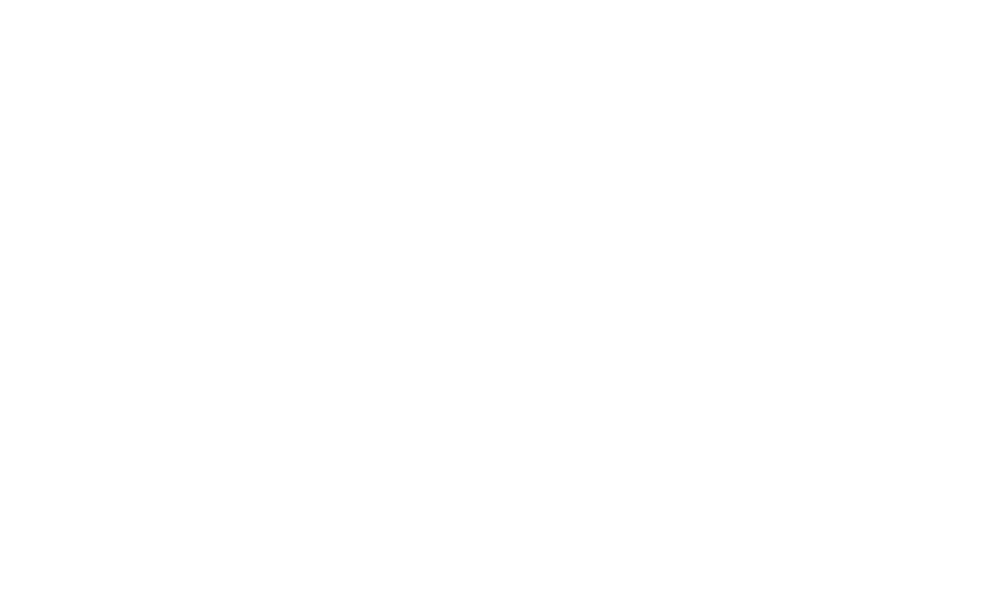

<IPython.core.display.Javascript object>


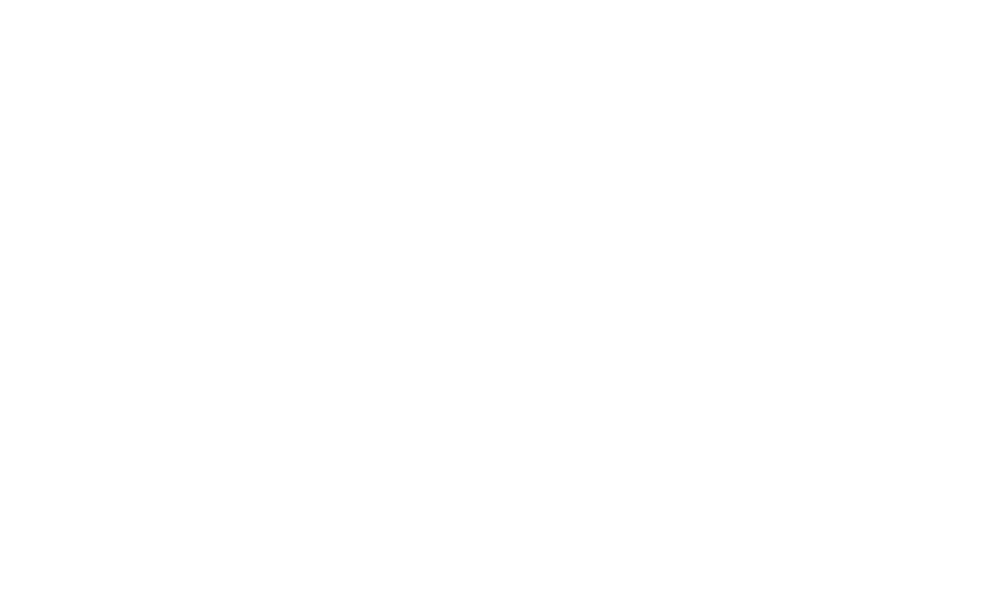

<IPython.core.display.Javascript object>


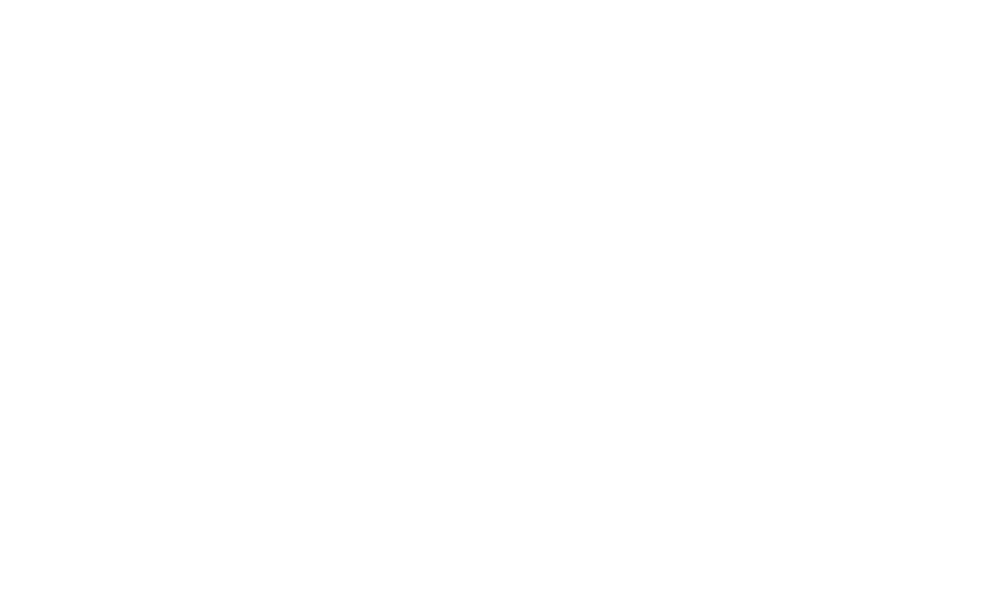

<IPython.core.display.Javascript object>


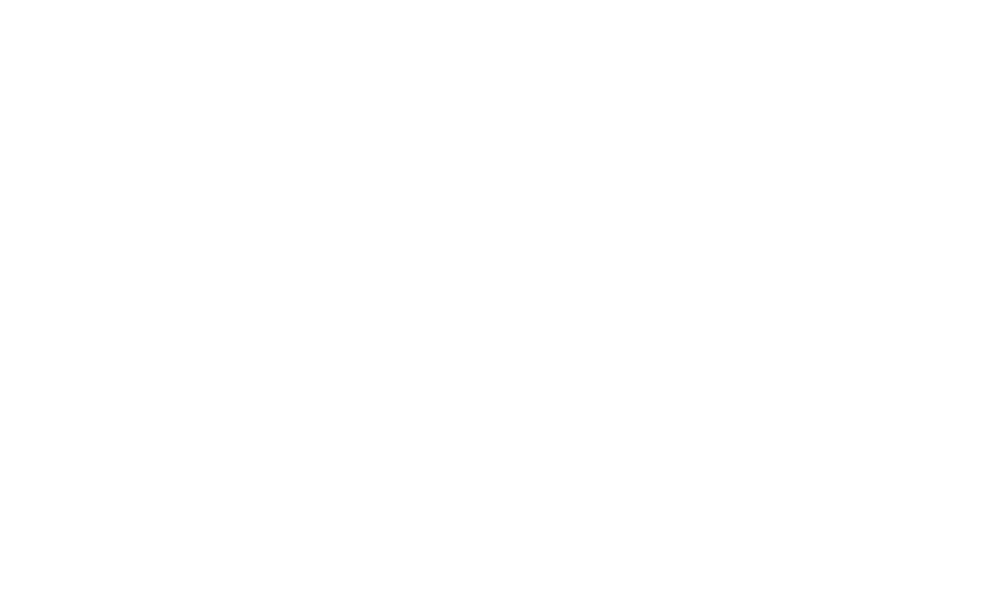

<IPython.core.display.Javascript object>


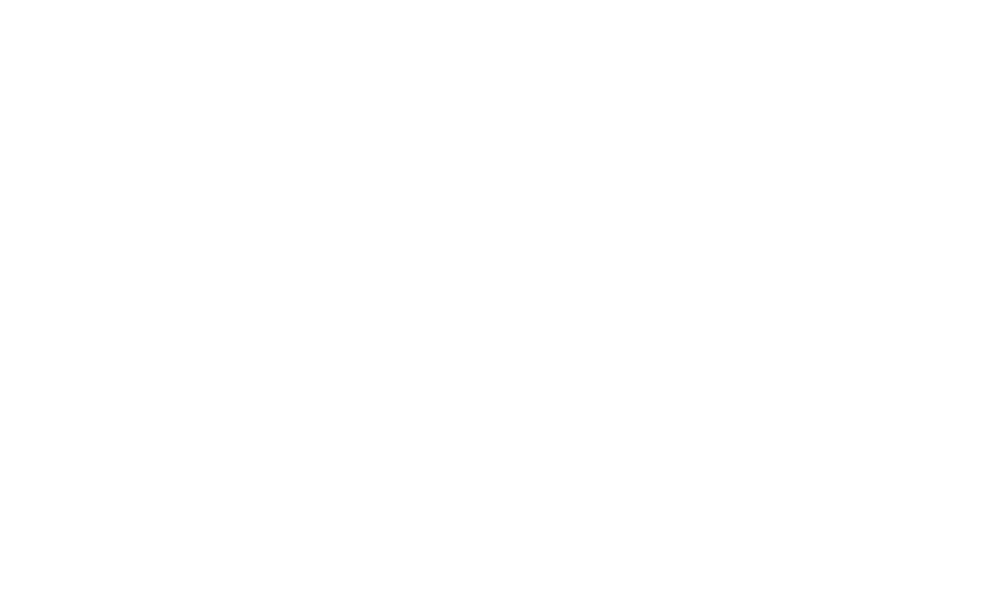

<IPython.core.display.Javascript object>


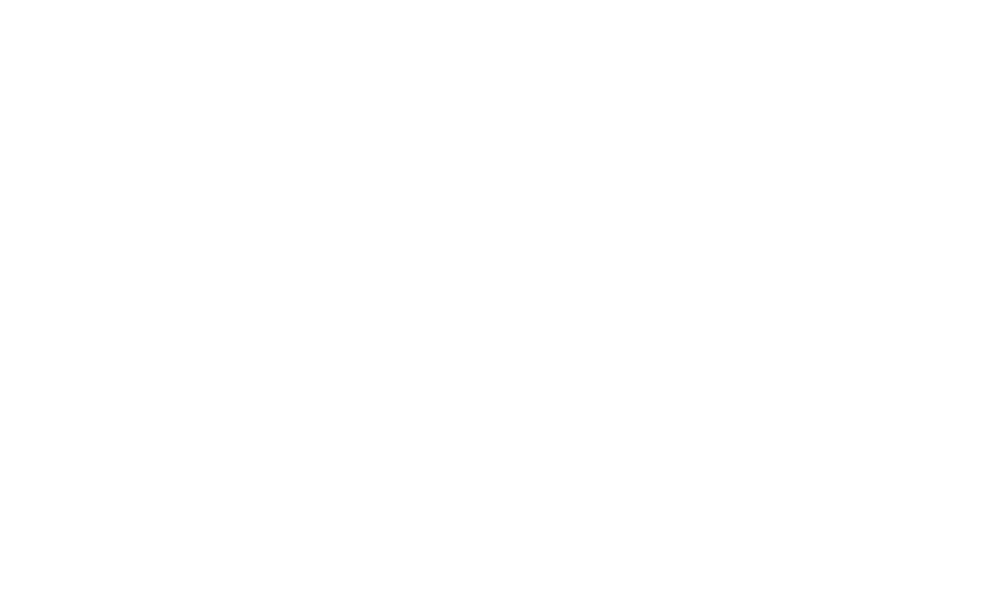

<IPython.core.display.Javascript object>


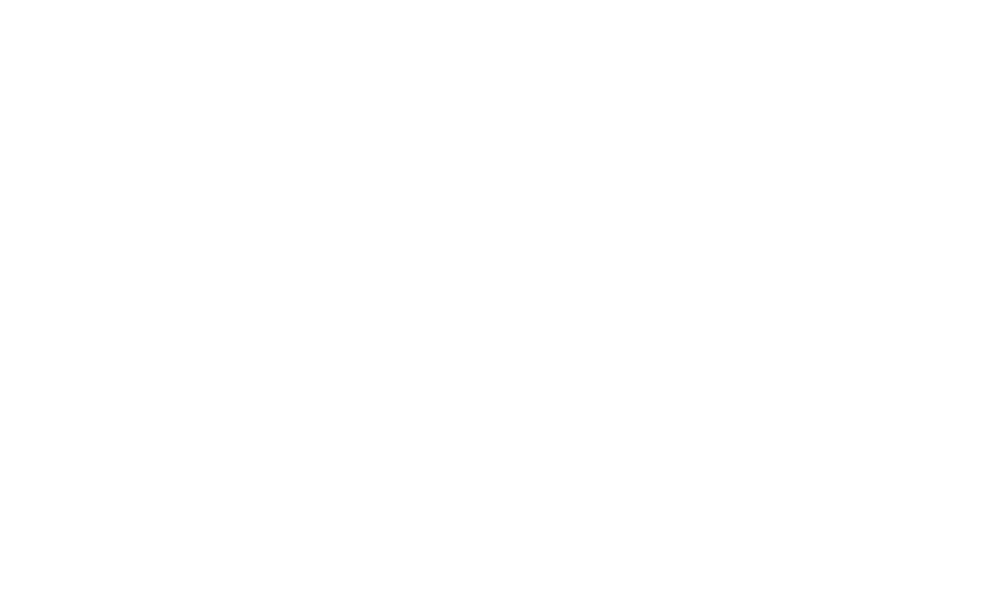

<IPython.core.display.Javascript object>


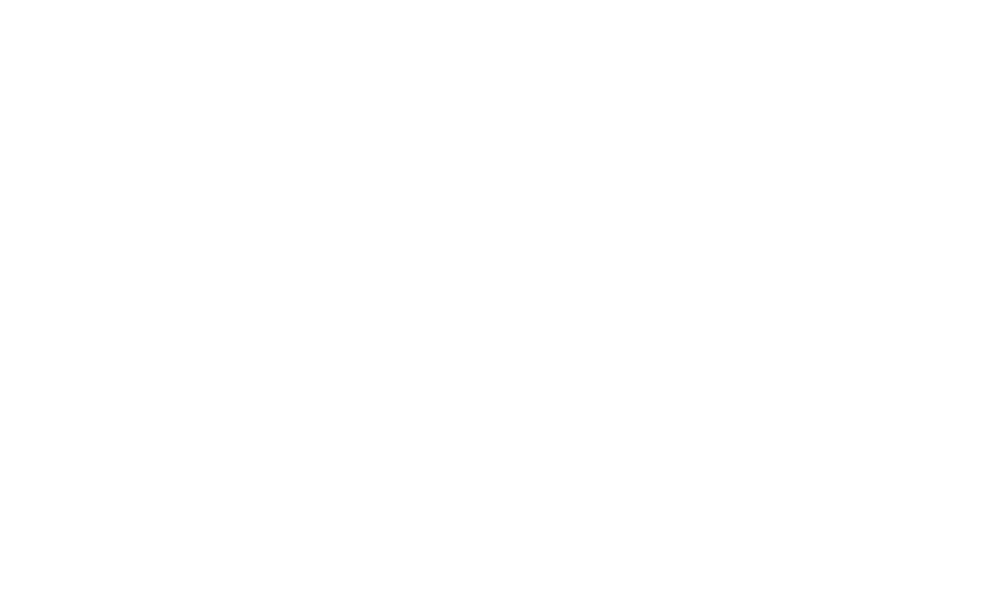

<IPython.core.display.Javascript object>


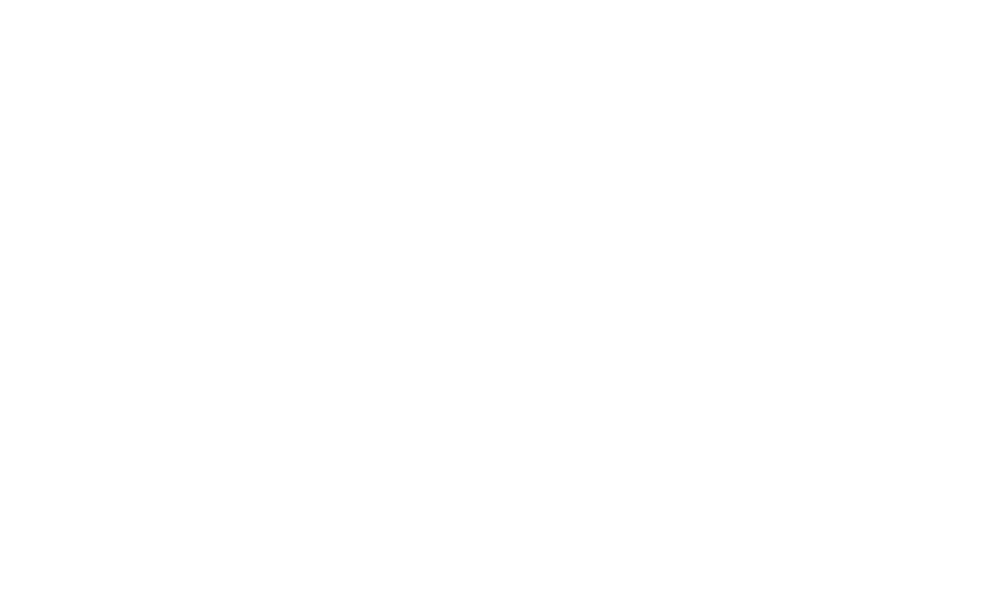

<IPython.core.display.Javascript object>


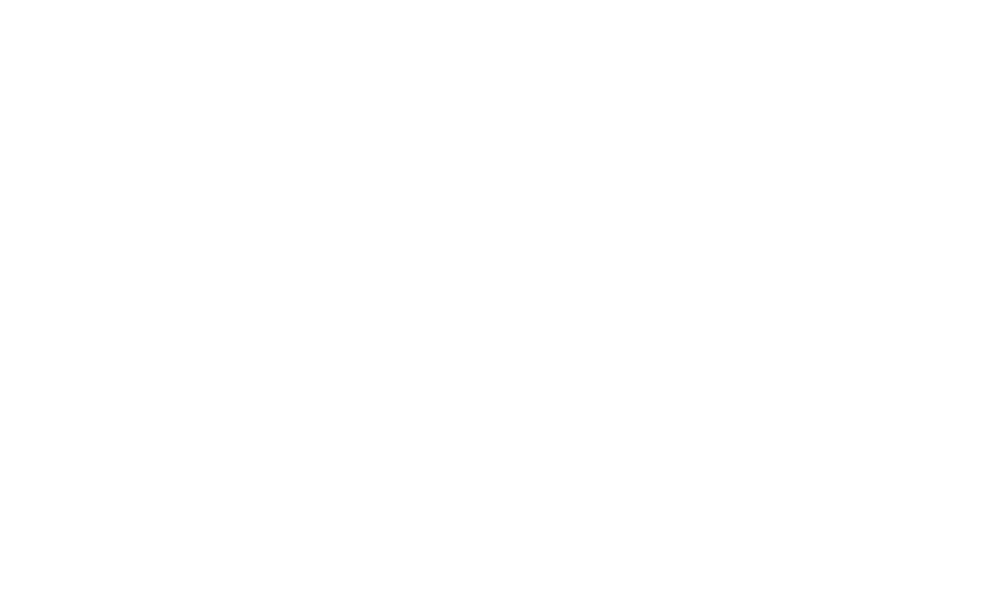

<IPython.core.display.Javascript object>


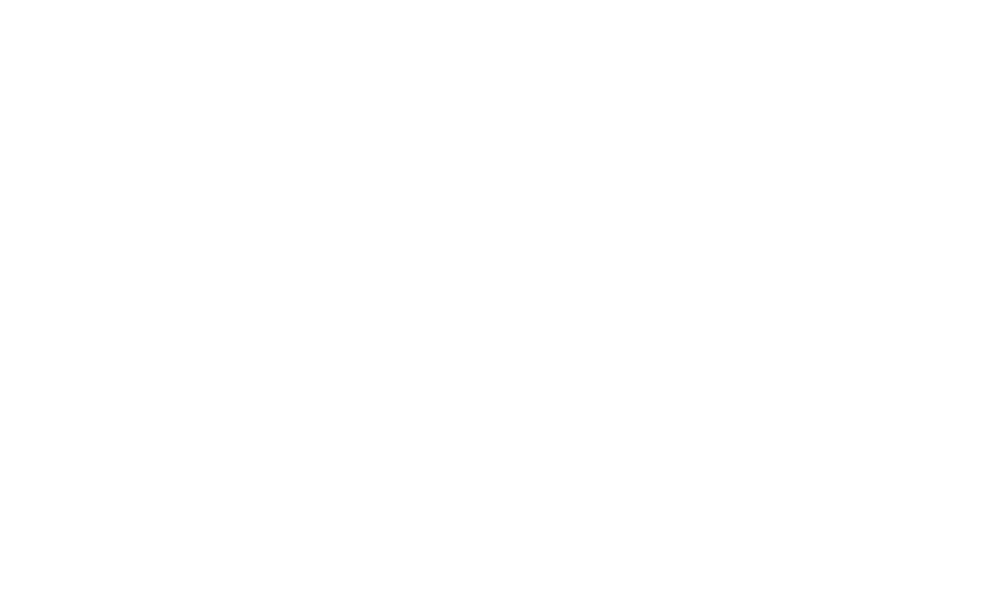

<IPython.core.display.Javascript object>


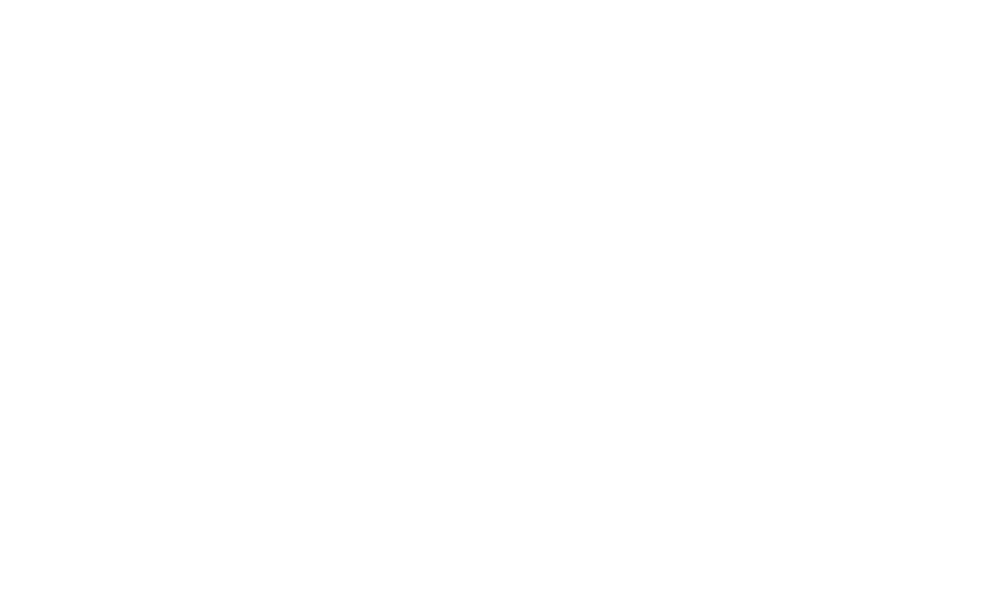

<IPython.core.display.Javascript object>


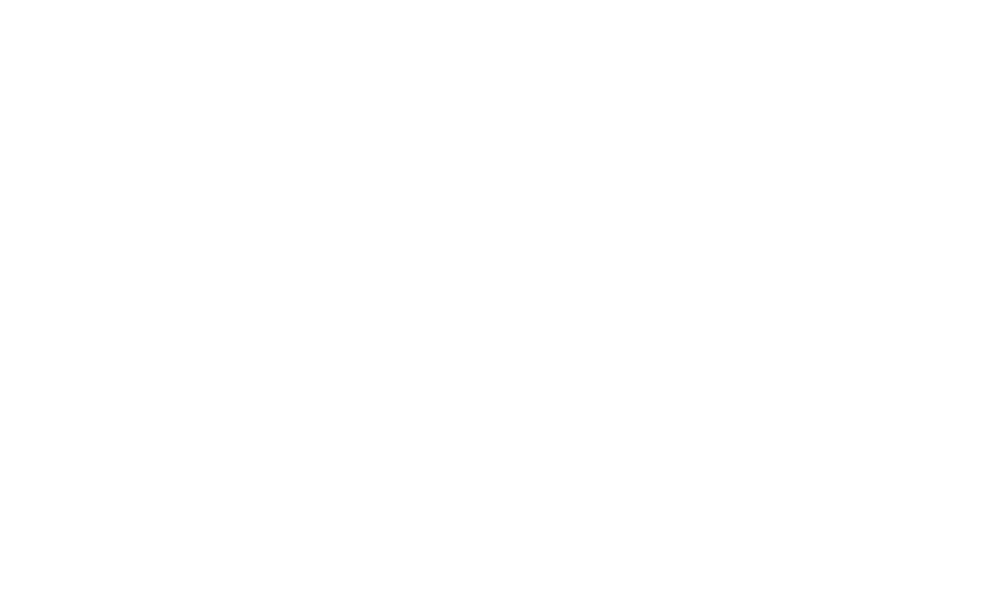

<IPython.core.display.Javascript object>


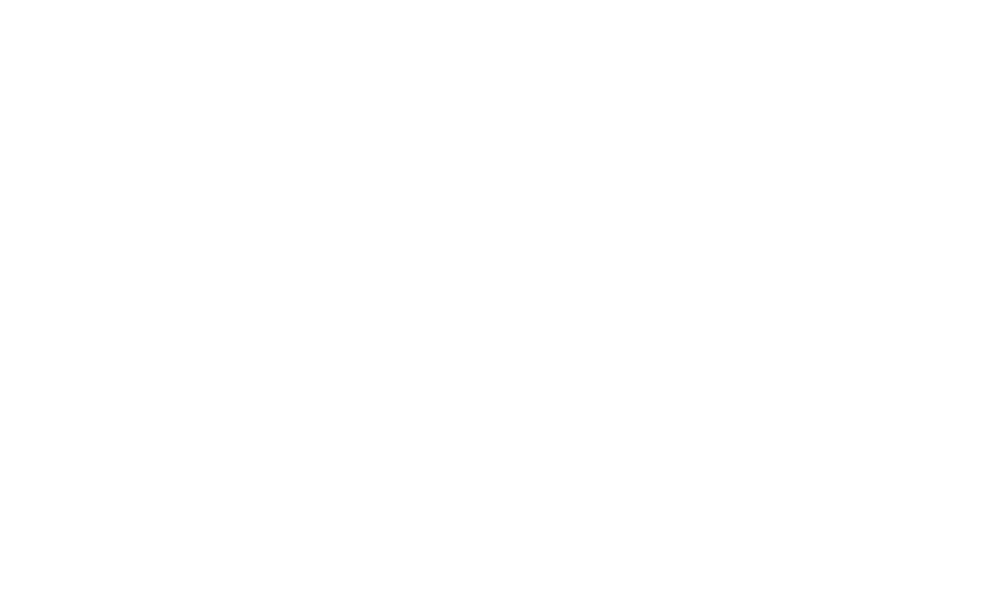

<IPython.core.display.Javascript object>


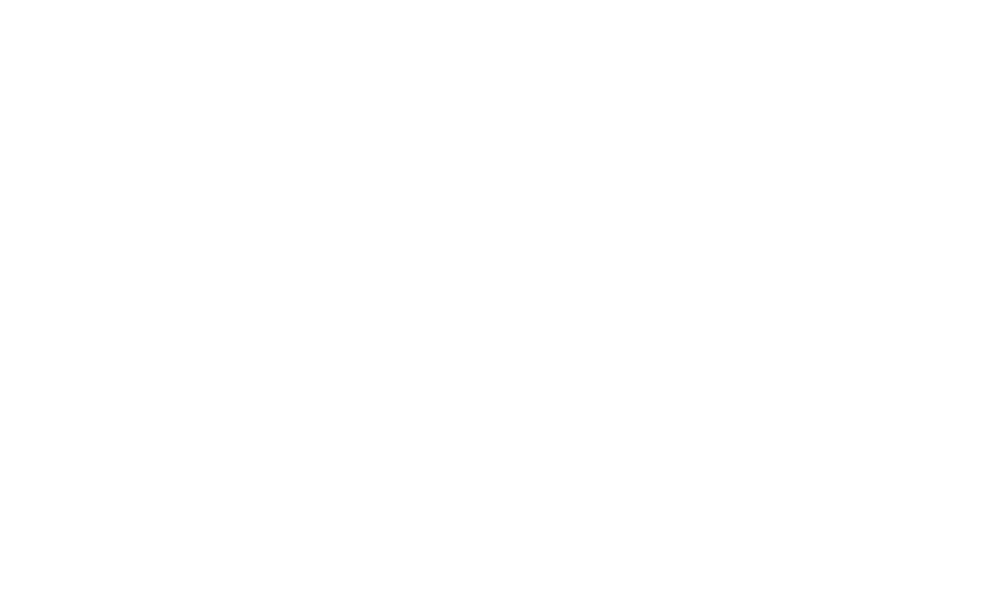

<IPython.core.display.Javascript object>


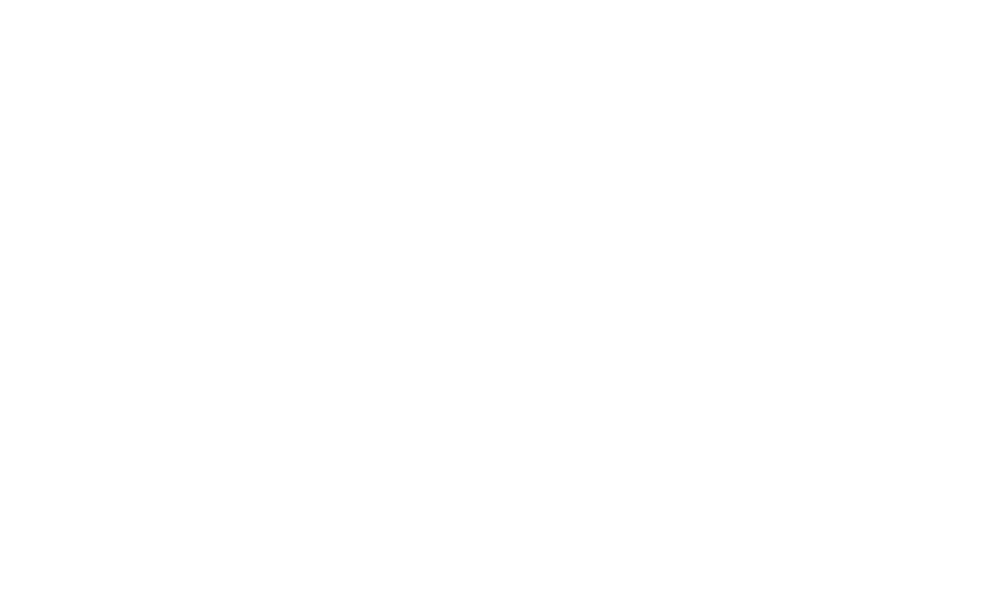

<IPython.core.display.Javascript object>


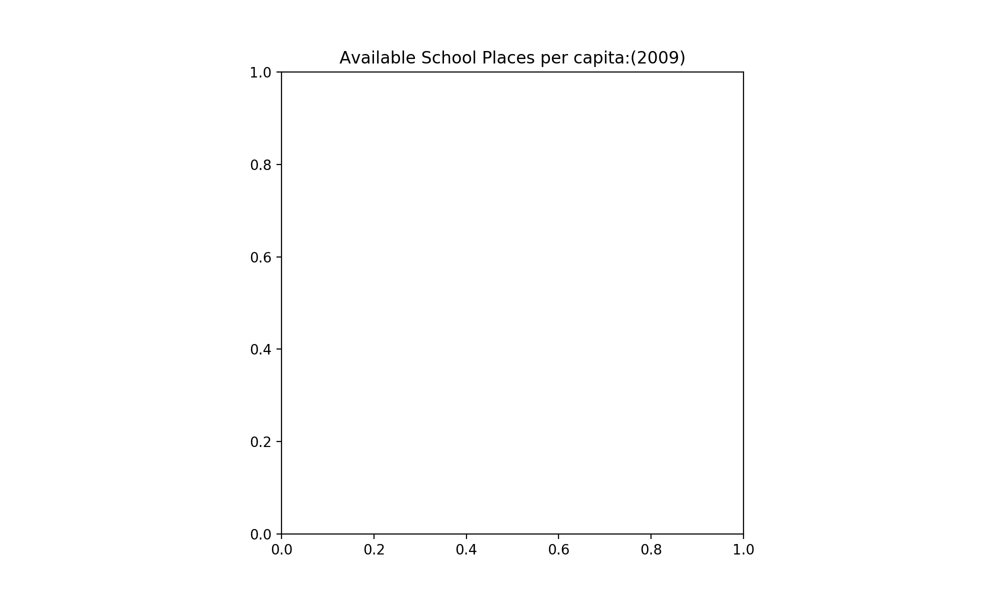

av_pc:2009 has no data


<IPython.core.display.Javascript object>


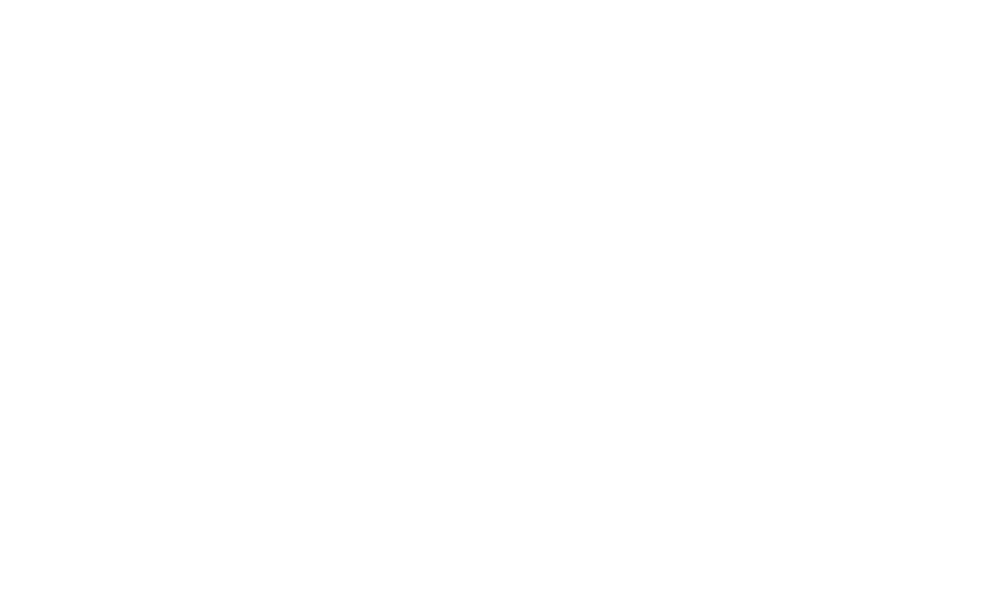

<IPython.core.display.Javascript object>


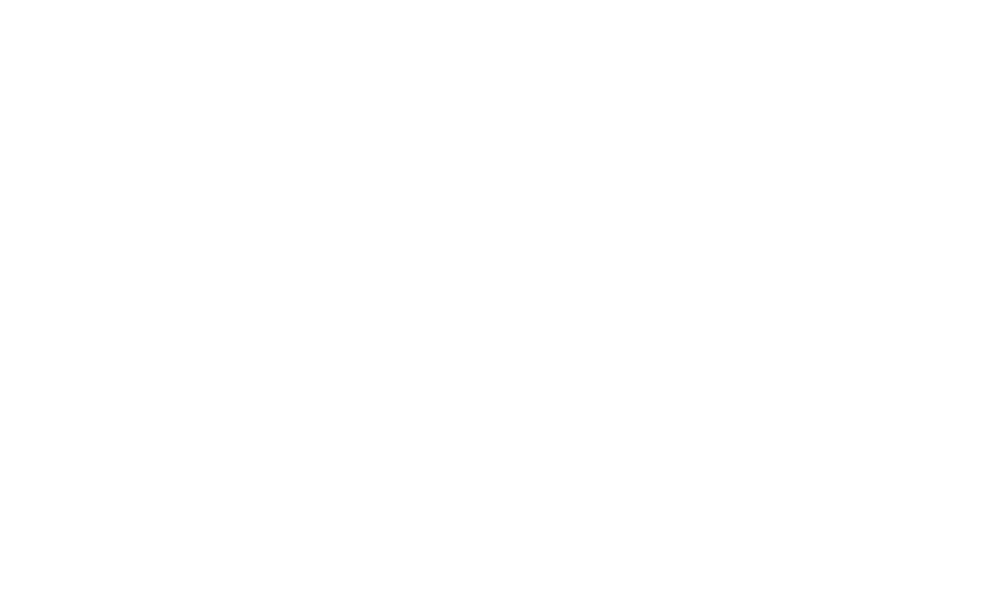

<IPython.core.display.Javascript object>


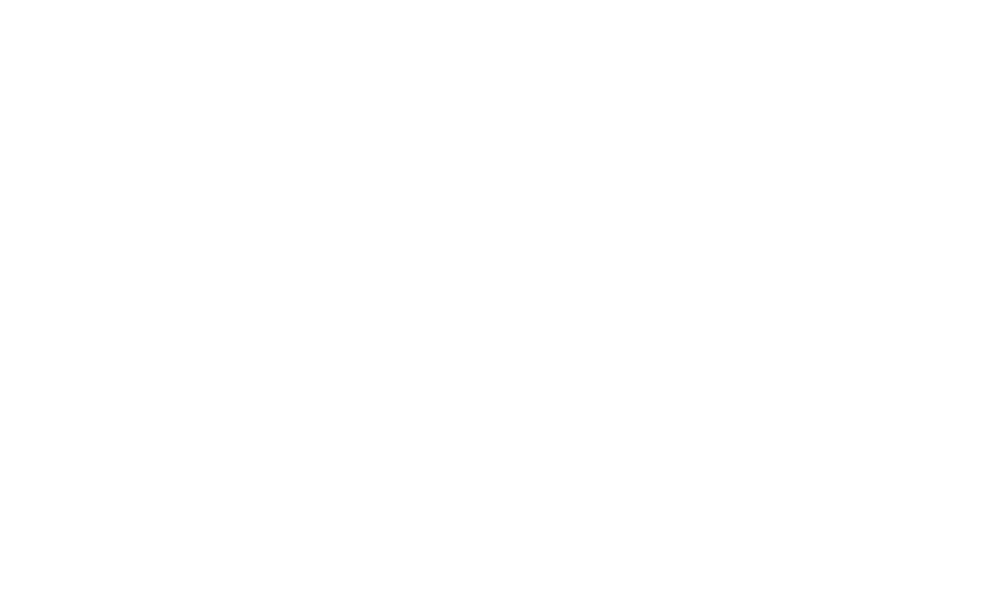

<IPython.core.display.Javascript object>


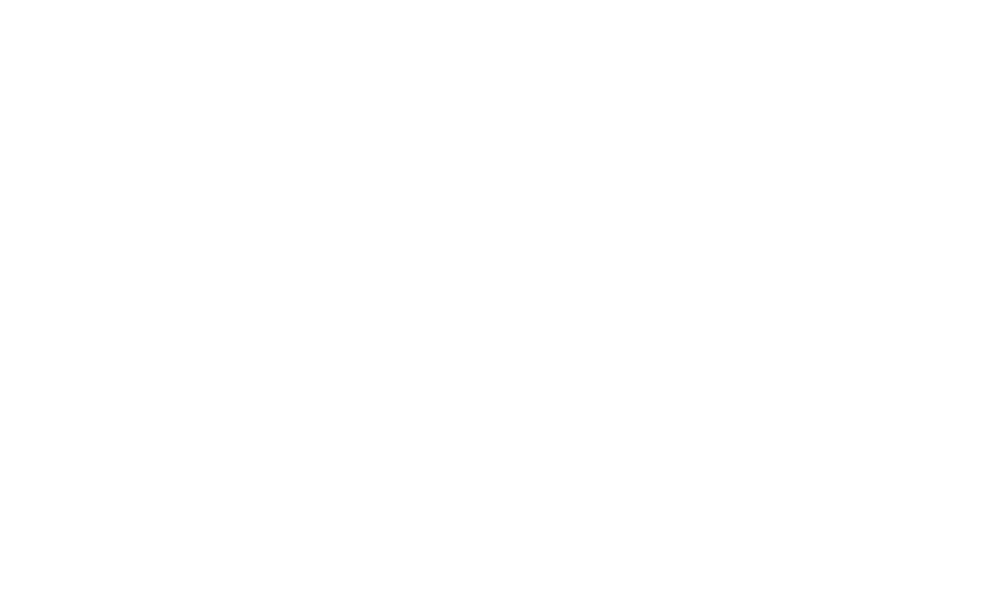

<IPython.core.display.Javascript object>


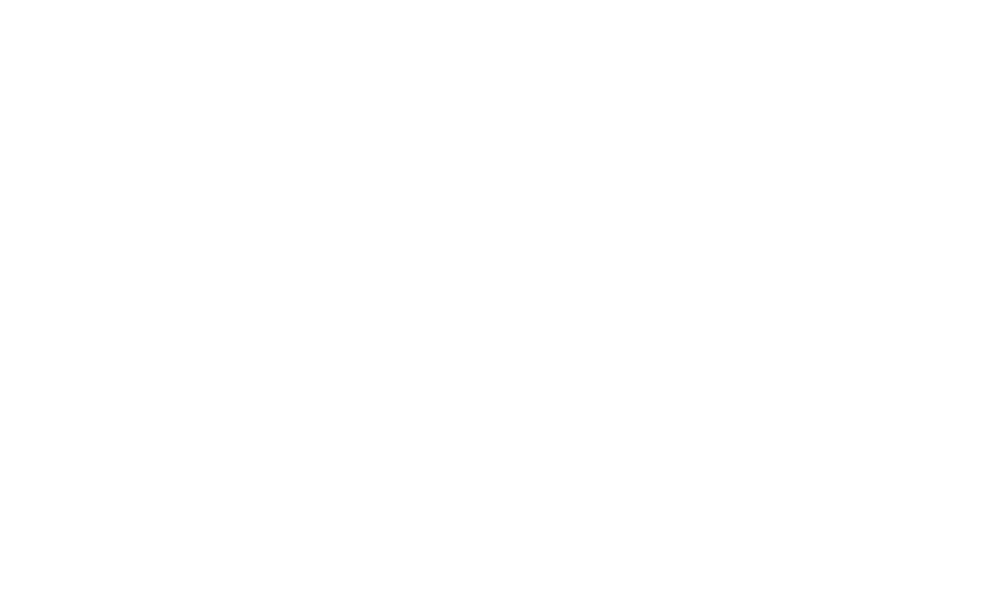

<IPython.core.display.Javascript object>


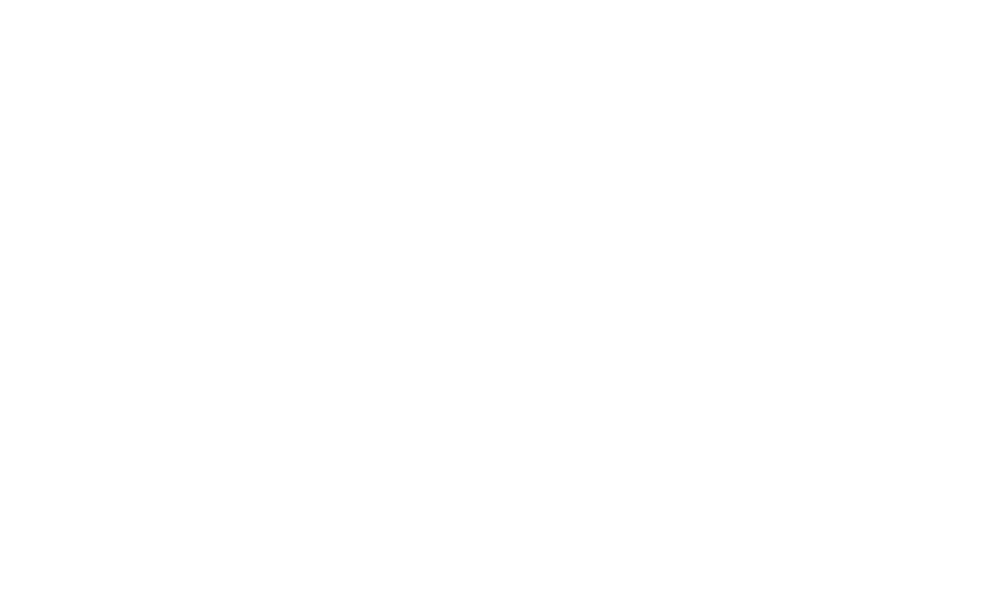

<IPython.core.display.Javascript object>


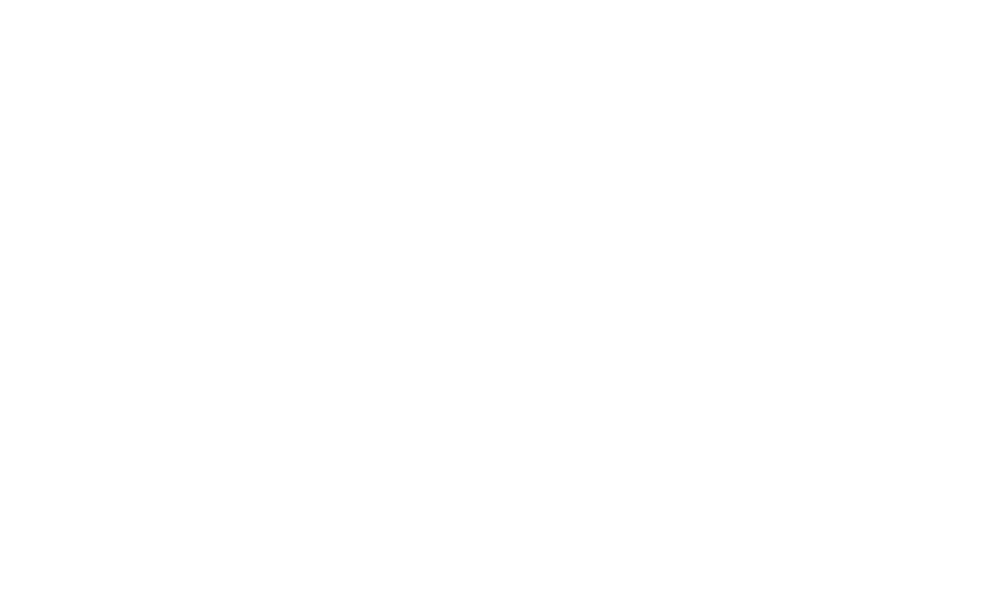

<IPython.core.display.Javascript object>


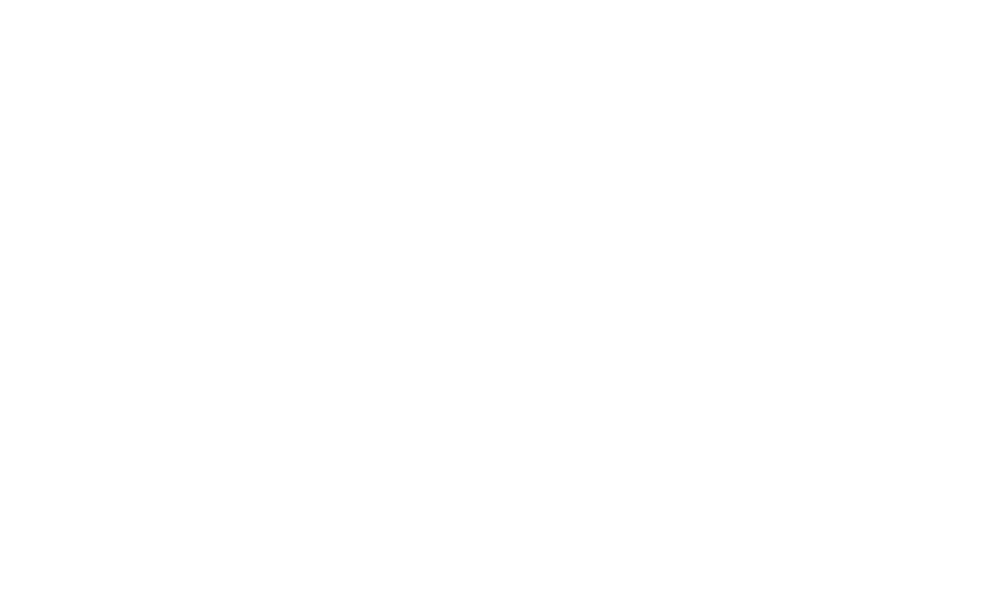

<IPython.core.display.Javascript object>


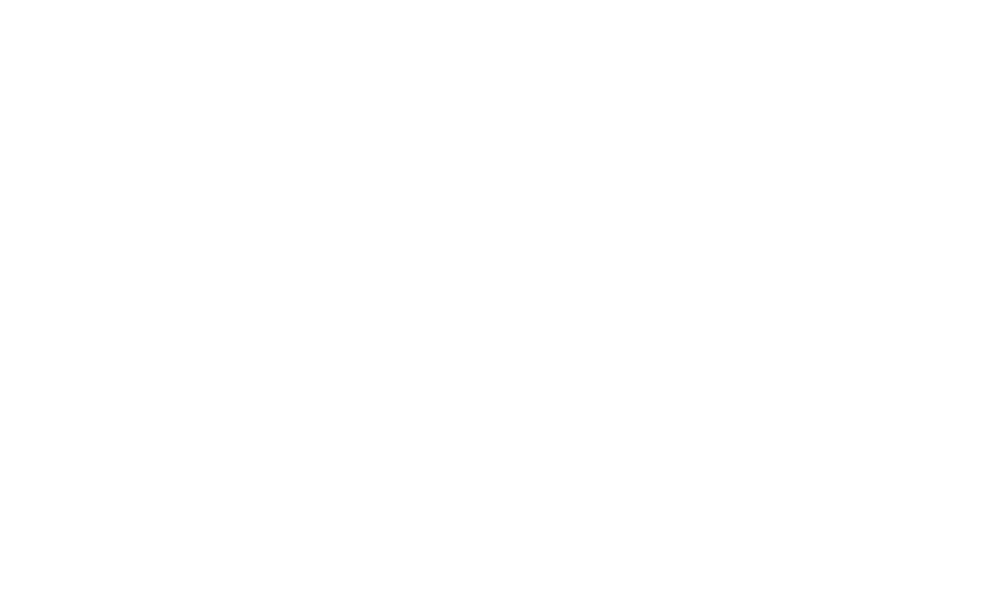

<IPython.core.display.Javascript object>


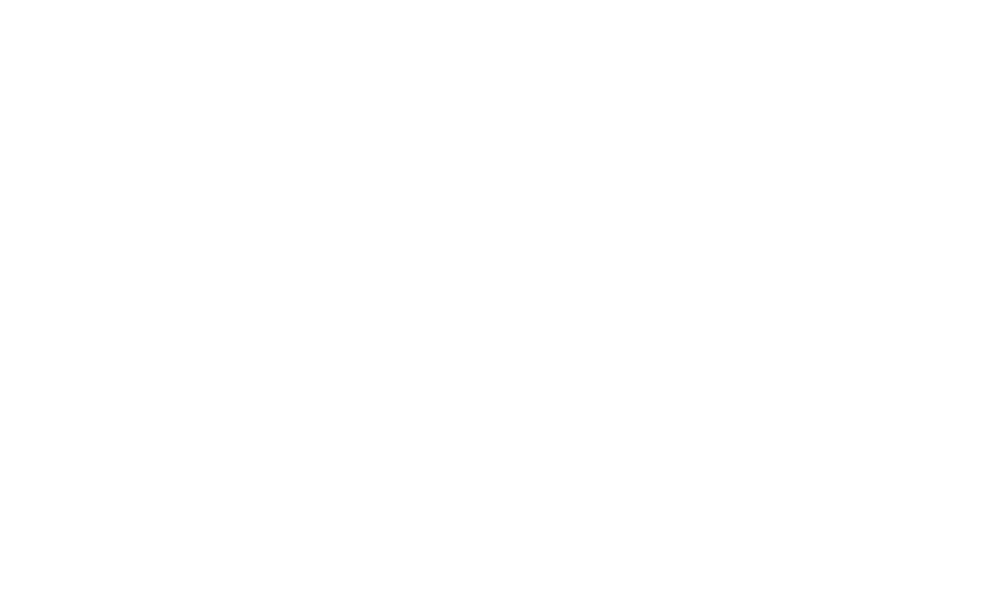

<IPython.core.display.Javascript object>


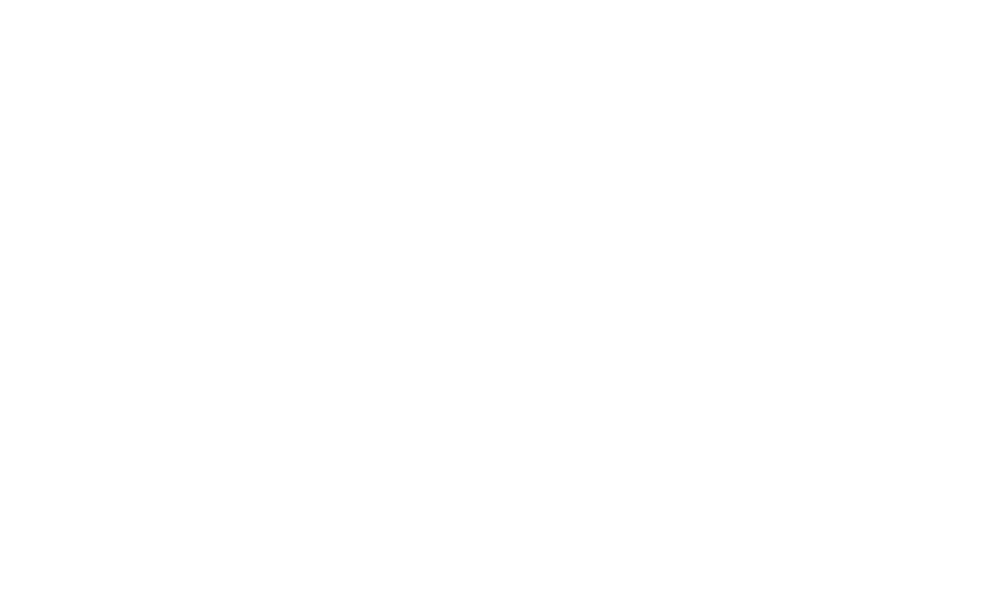

<IPython.core.display.Javascript object>


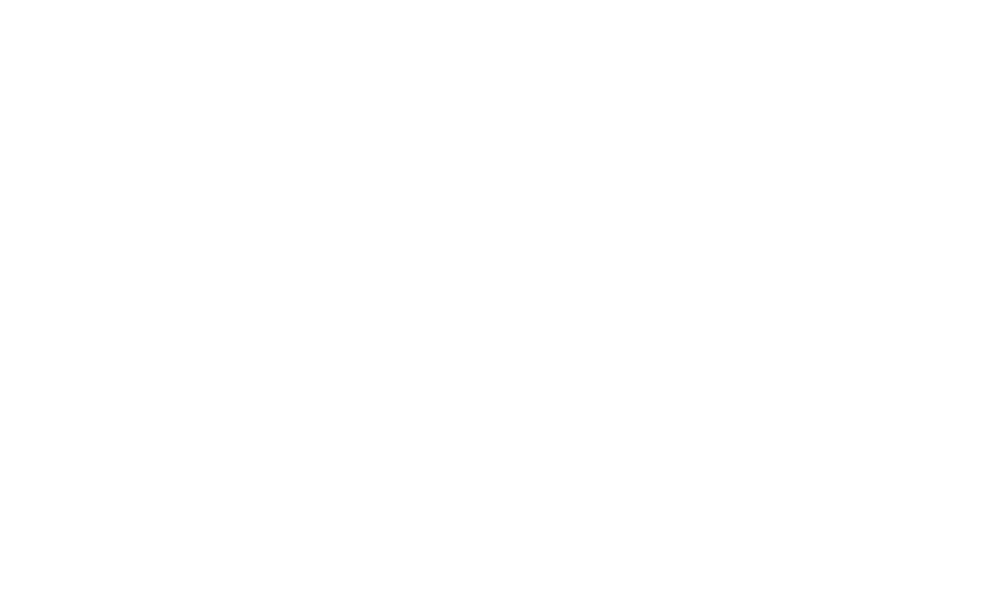

<IPython.core.display.Javascript object>


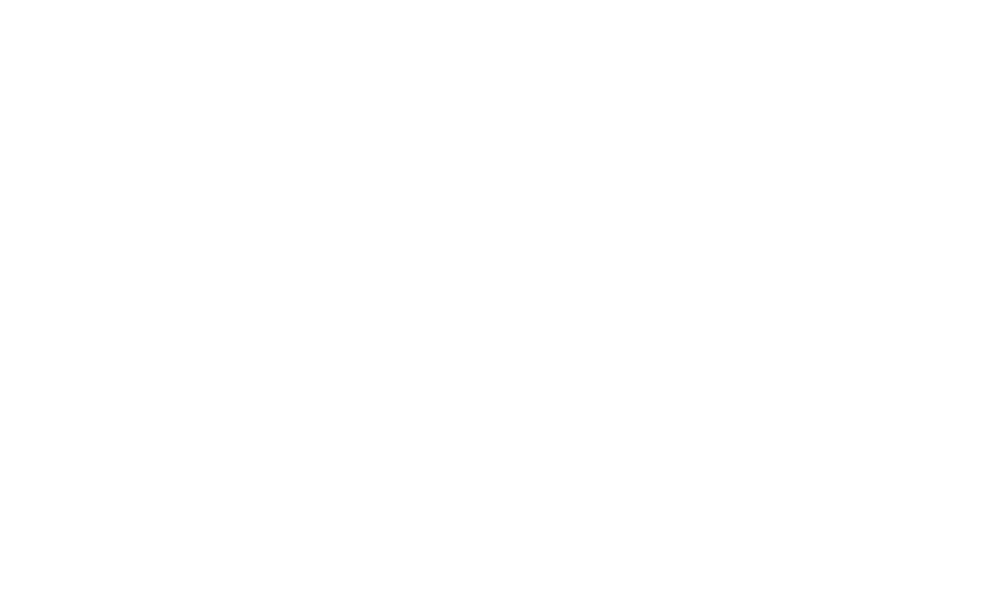

<IPython.core.display.Javascript object>


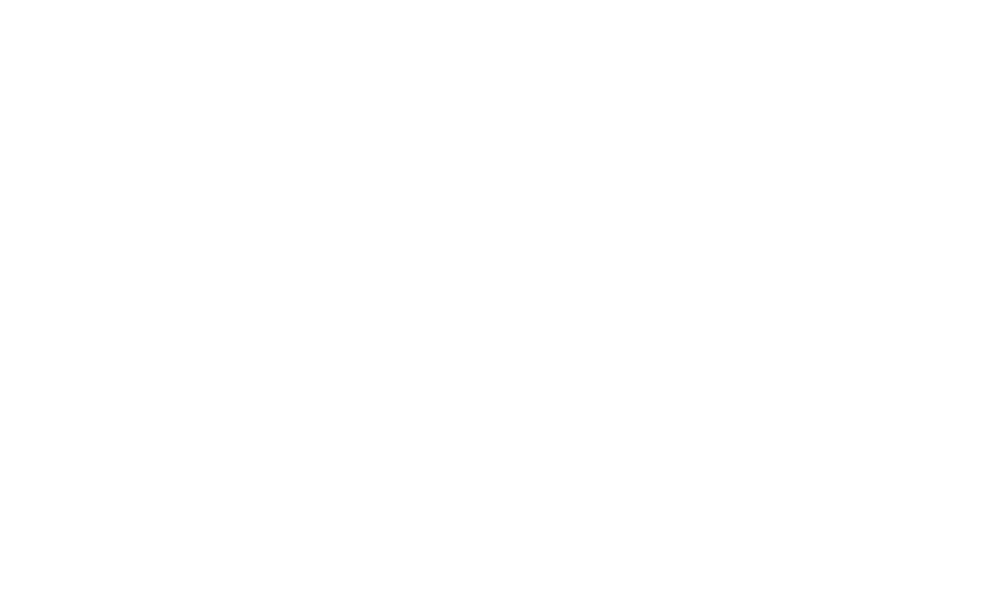

<IPython.core.display.Javascript object>


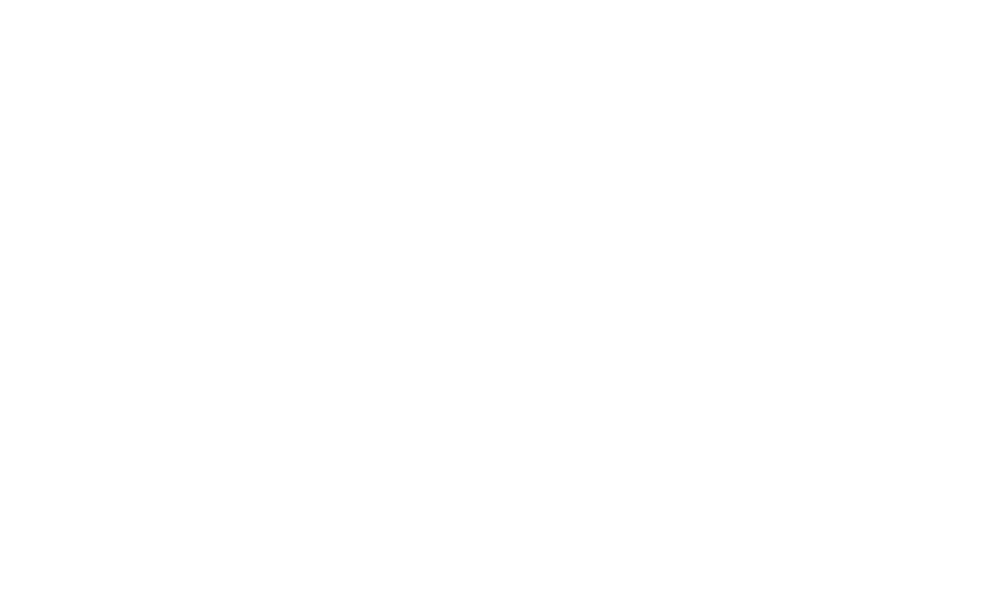

<IPython.core.display.Javascript object>


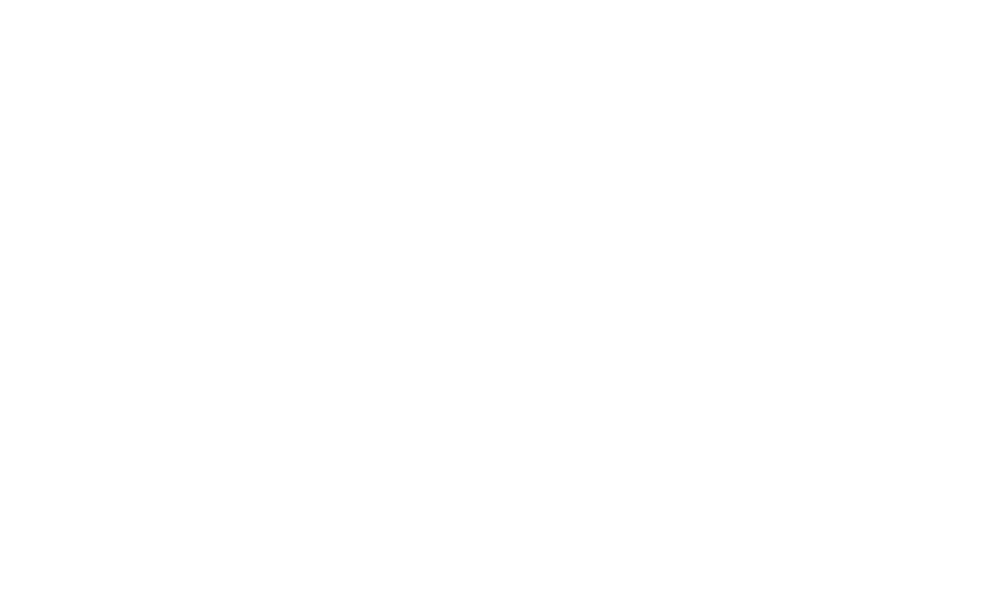

<IPython.core.display.Javascript object>


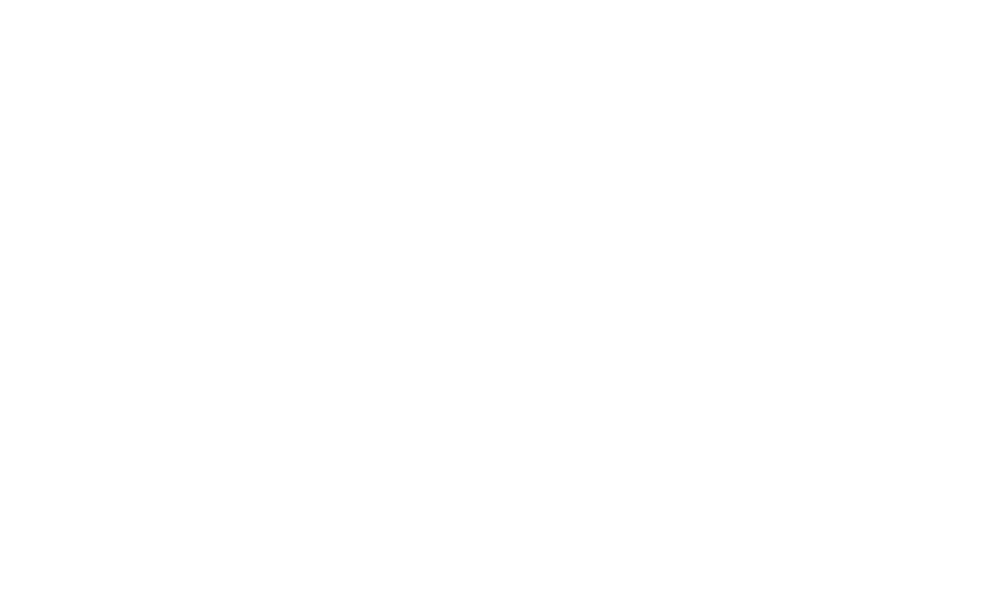

<IPython.core.display.Javascript object>


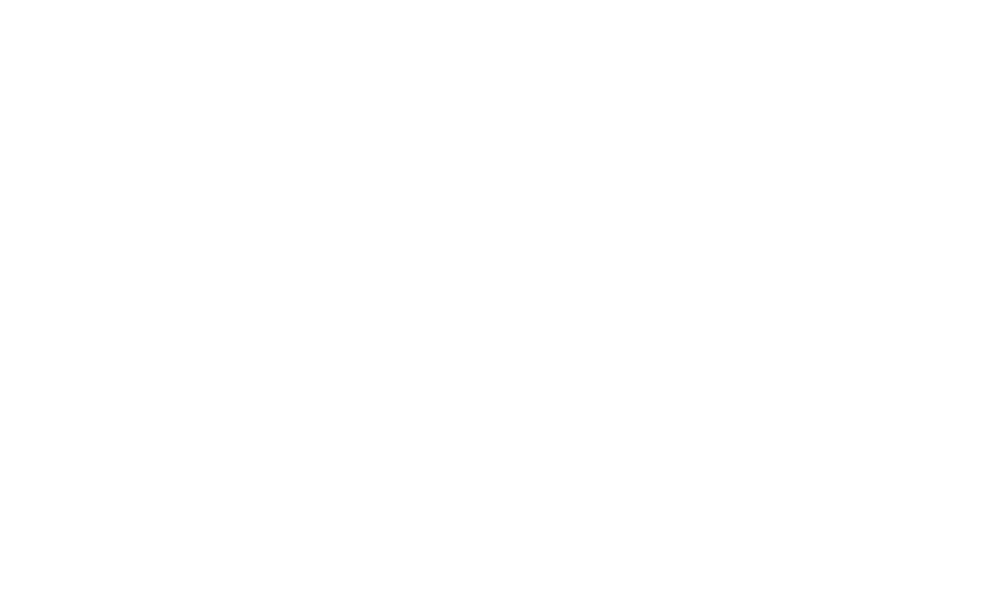

<IPython.core.display.Javascript object>


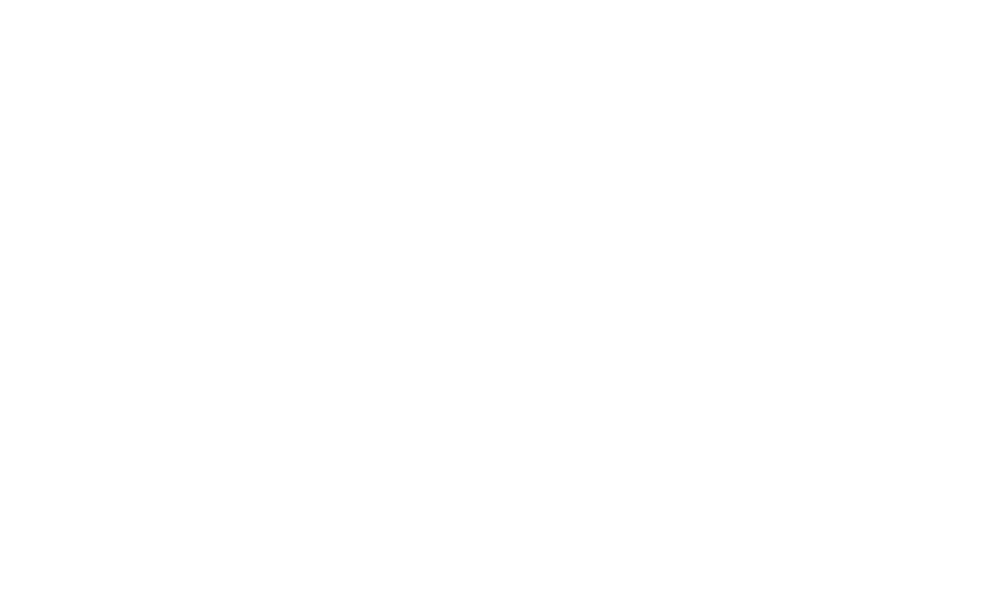

<IPython.core.display.Javascript object>


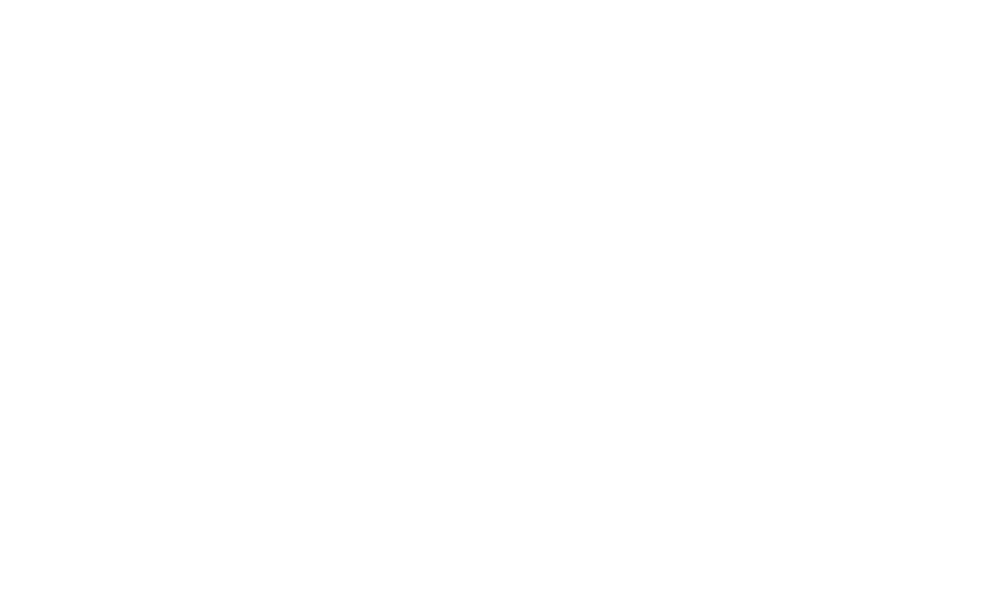

<IPython.core.display.Javascript object>


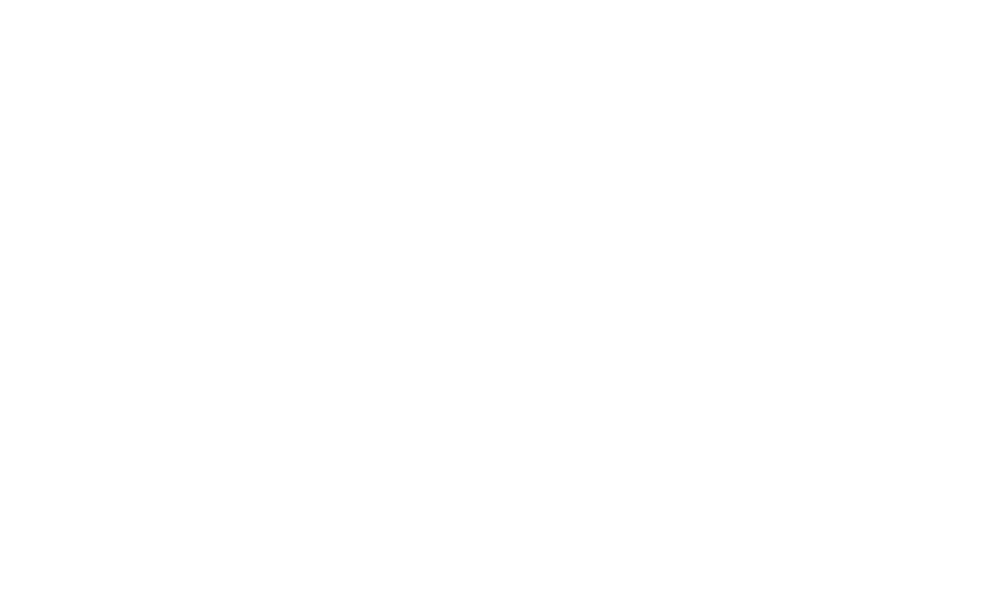

<IPython.core.display.Javascript object>


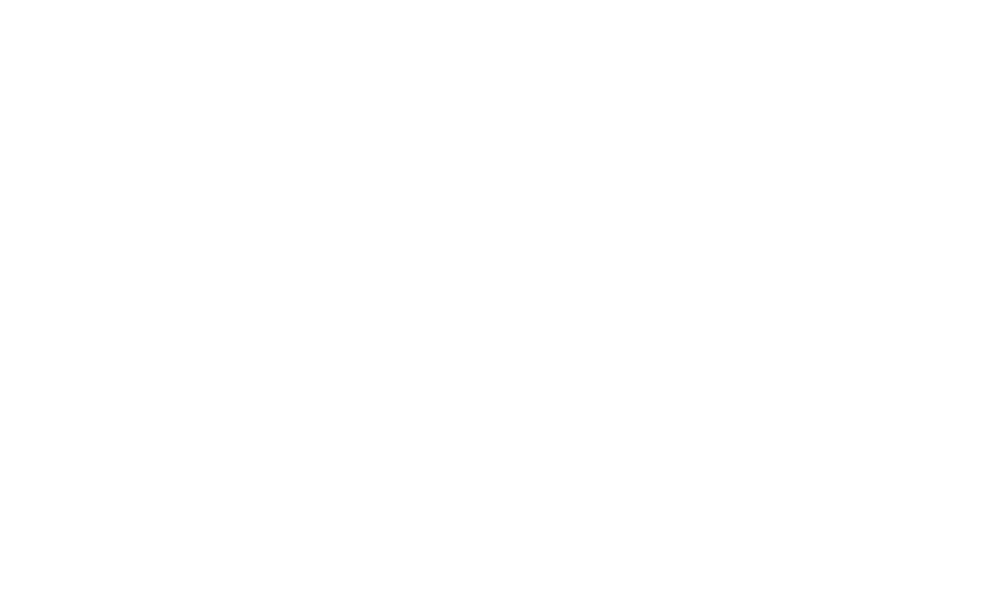

<IPython.core.display.Javascript object>


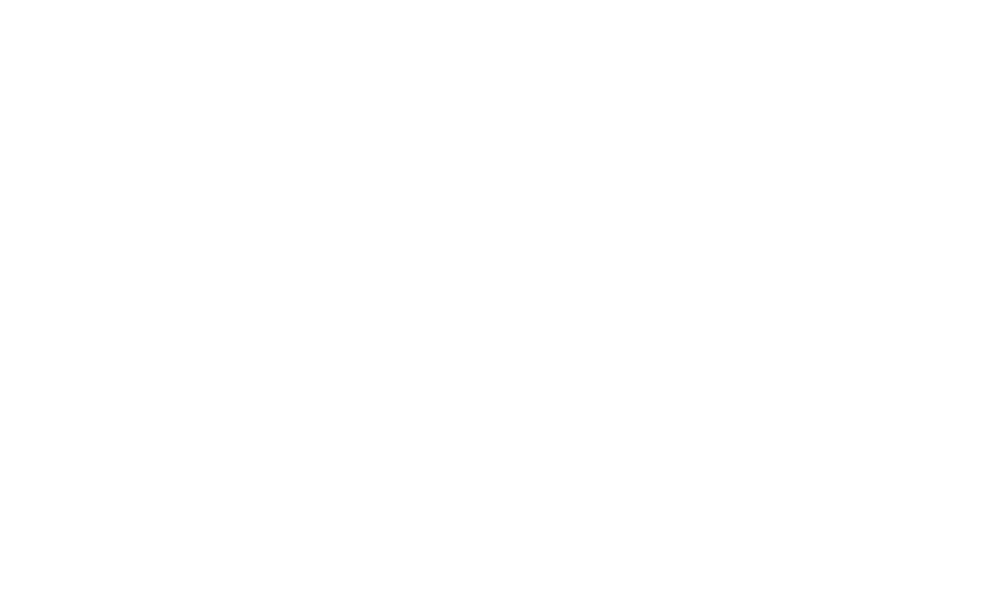

<IPython.core.display.Javascript object>


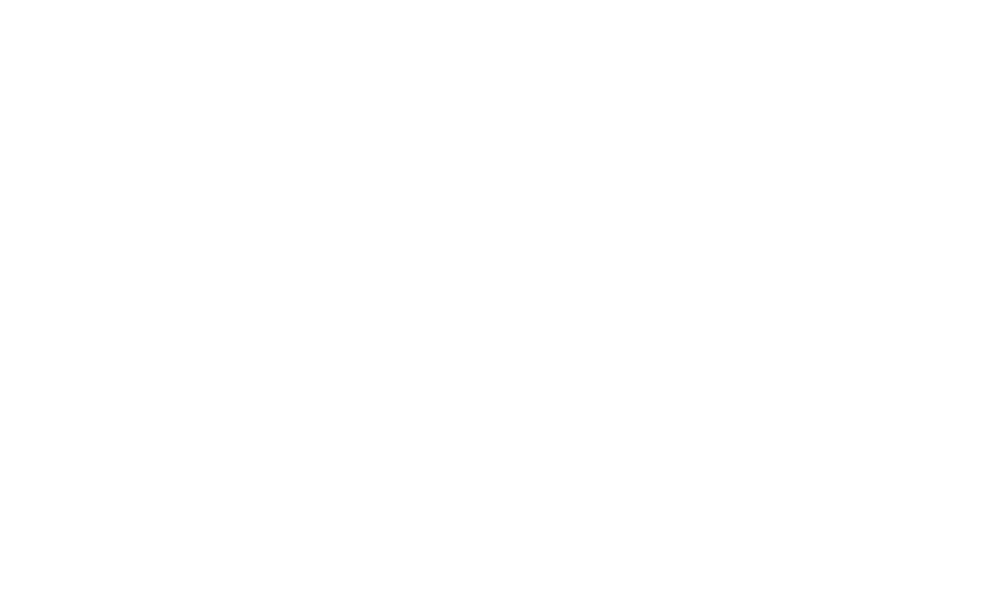

<IPython.core.display.Javascript object>


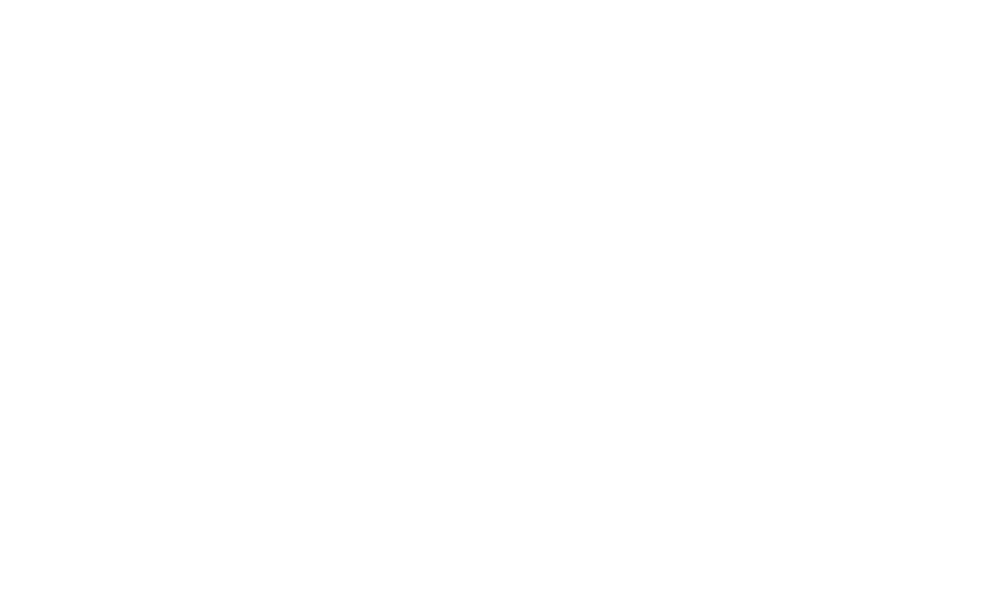

<IPython.core.display.Javascript object>


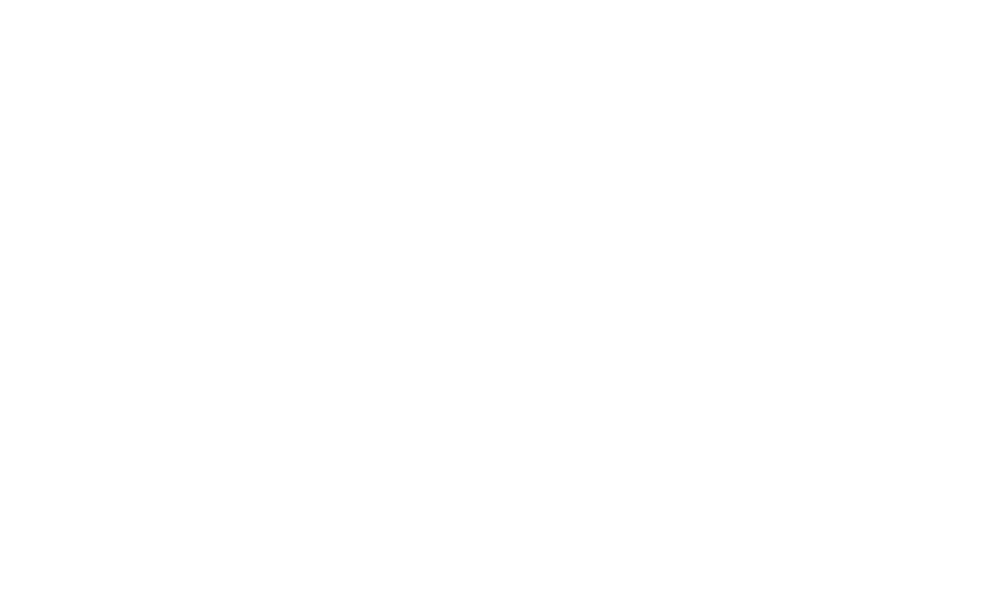

<IPython.core.display.Javascript object>


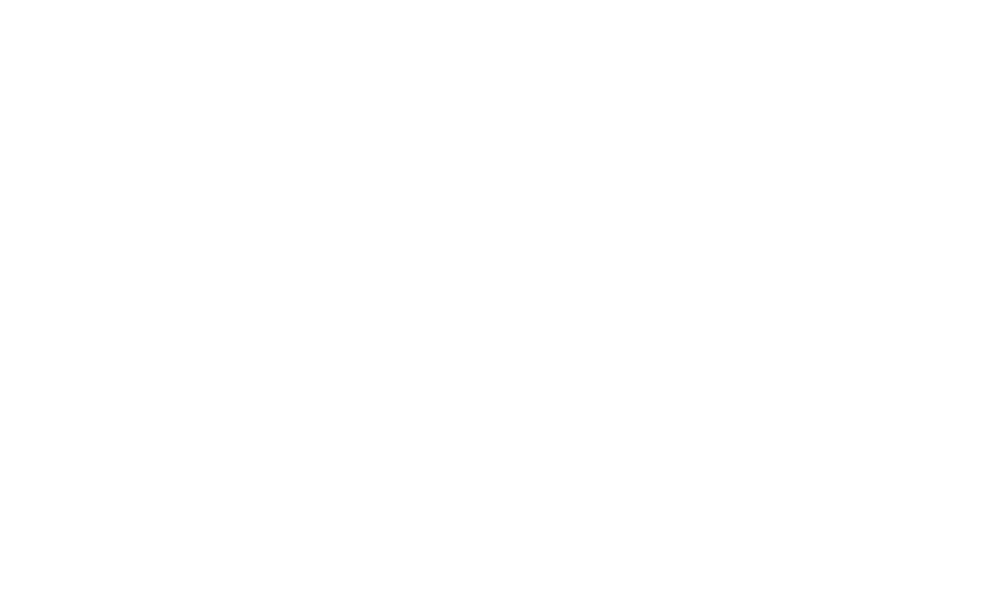

<IPython.core.display.Javascript object>


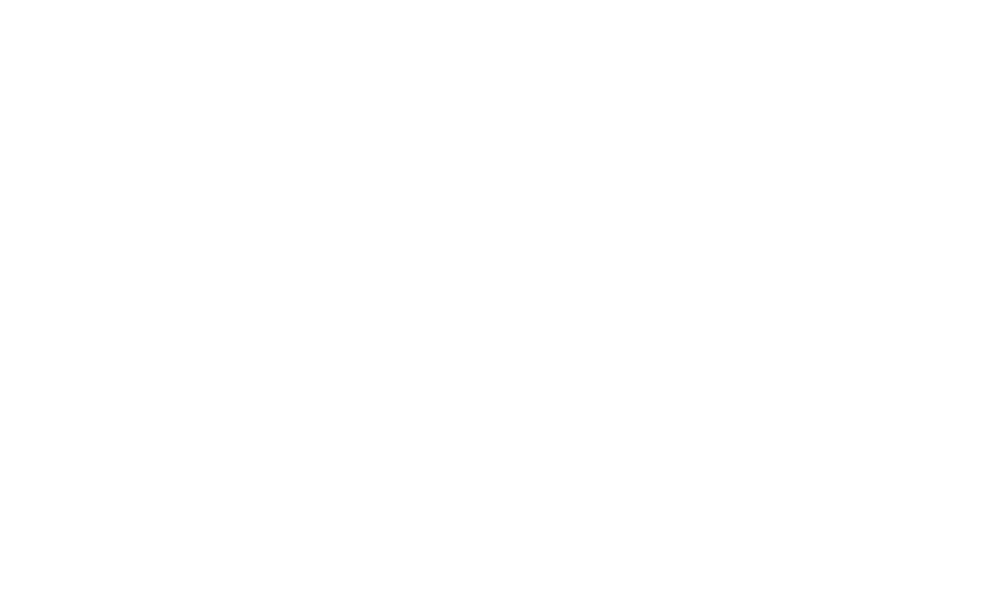

<IPython.core.display.Javascript object>


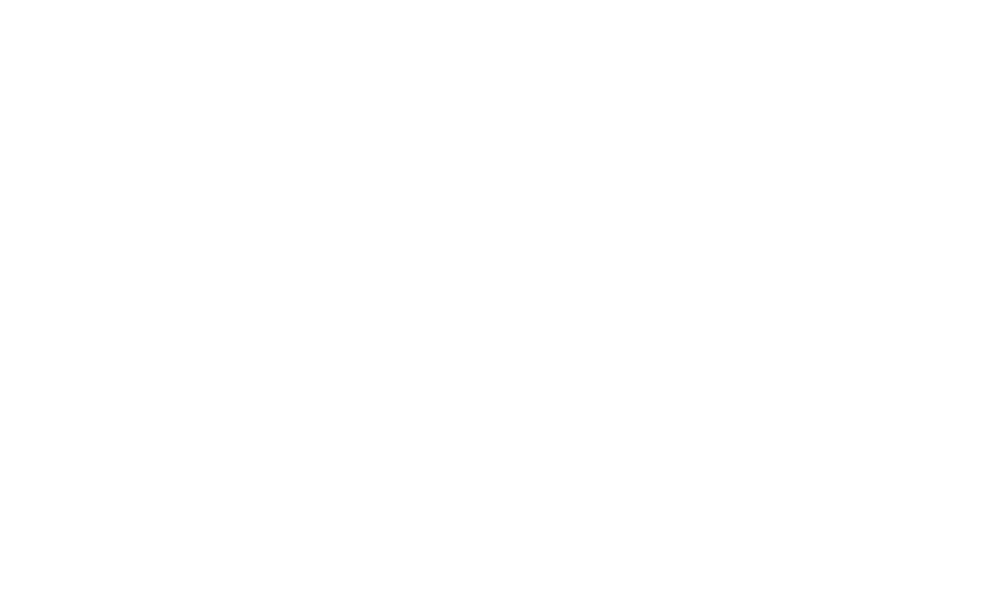

<IPython.core.display.Javascript object>


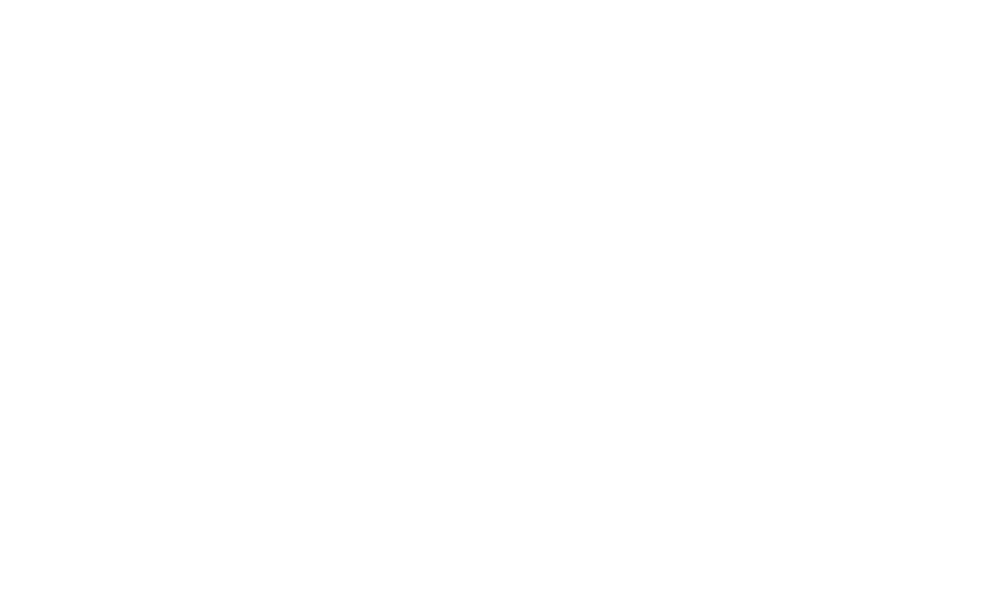

<IPython.core.display.Javascript object>


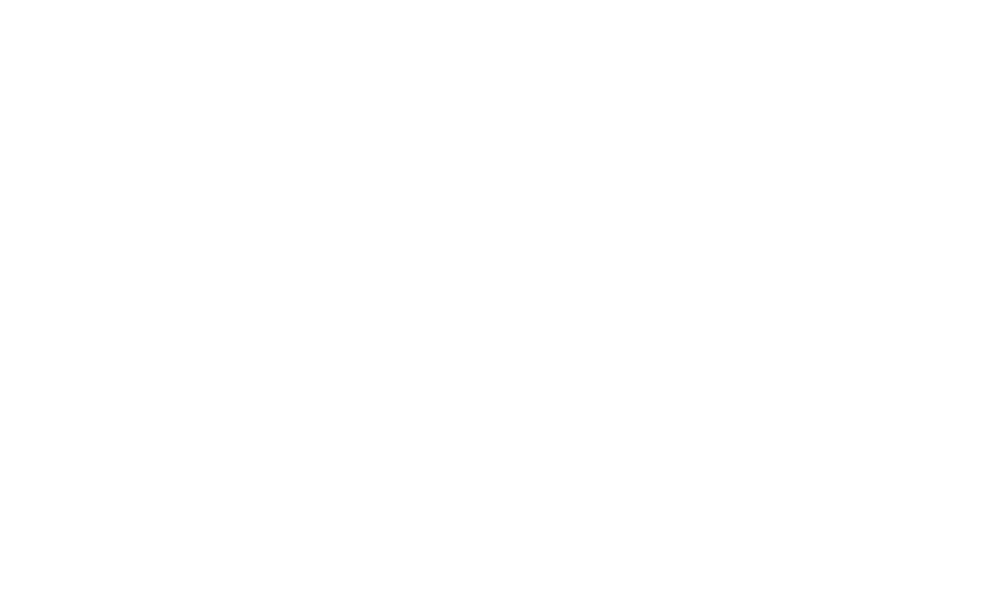

In [192]:
for metric in set(map(unyearify, cons_gdf.columns)):
    for year in years:
        try:
            p = Path(f"outputs/{metric}/{year}.png")
            p.parent.mkdir(parents=True, exist_ok=True)
            if metric in explanations:
                title= f"{explanations[metric]}:({year})"
            else:
                title= f"{metric}:({year})"
            if metric=='topqt':
                plotmap(cons_gdf, f'topqt_{year}', outfile=p, title=title)
            else:
                _df = cons_gdf[[c for c in cons_gdf.columns if str(year) in c]+['geometry']]\
                    .rename(columns=unyearify)
                plotmap(_df,metric, outfile=p, title=title)
        except:
            print(f"{metric}:{year} has no data")

In [193]:
import moviepy.editor as mpy
import moviepy.video as mpyv

def build_gif_of(p):
    metric = p.parts[-1]
    file_list = list(map(str,sorted(filter(lambda s:s.suffix=='.png', p.iterdir()))))
    if file_list: # May catch empty dirs if year-generation fails
        clip = mpy.ImageSequenceClip(file_list, fps=1.5)
        clip = mpyv.fx.all.freeze(clip, t='end', freeze_duration=2)
        clip.write_gif(f"outputs/{metric}.gif", verbose=False)
        return metric,clip
        
for p in Path('outputs/').iterdir():
    if not p.is_dir():
        continue
    build_gif_of(p)

    

 92%|█████████▏| 11/12 [00:00<00:00, 12.57it/s]


### We're getting older, or at least living longer
![](outputs/age_avg.gif)

### But younger people are taking over the west
_I'm so sorry for the colourscheme on this one, meaculpa!_
![](outputs/topqt.gif)

### 💕 Go West for Men, or West Belfast for Women 💕 
10% fewer men than women in West Belfast, ~2% more men than women out west
![](outputs/pop_m_per_f.gif)

### Free School Meals are rising with population
![](outputs/fsm.gif)

### But the divide is getting wider per capita
![](outputs/fsm_rat.gif)

### There aren't necessarily fewer available school places either...
There just aren't any where people want to send their kids...

Could *possibly* indicate over-provisioning in yellow areas...
![](outputs/av_pc.gif)

### Population distribution isn't really changing at all
![](outputs/pop.gif)

### And as such, noones sending their kids anywhere differently despite closures...

![](outputs/en_pc.gif)

## Population Distribution Shifts

In [194]:
# This has additional requirements as detailed in https://plot.ly/python/static-image-export/
for year in years:
    try:
        df = cons_pop[(cons_pop.Gender == 'All Persons') \
                  & (cons_pop.Mid_Year_Ending == year)]\
            .groupby(['Age','constituency'])['Population_Estimate']\
            .sum().unstack()
        f = df.iplot(kind='heatmap', colorscale='-YlOrRd',
                 margin=(200,0,0,30),orientation='h', asFigure=True,
                 title=f'Population per age per consitituency ({year})'
        )
        p = Path(f"outputs/pop_hm/{year}.png")
        p.parent.mkdir(parents=True, exist_ok=True)
        pio.write_image(f,str(p))
        
        f = colnorm(df).iplot(kind='heatmap', colorscale='-YlOrRd',
                 margin=(200,0,0,30),orientation='h', asFigure=True,
                 title=f'Scaled Population per age per consitituency ({year})'
        )
        p = Path(f"outputs/pop_hm_norm/{year}.png")
        p.parent.mkdir(parents=True, exist_ok=True)
        pio.write_image(f,str(p))
    except:
        print(f"{year} failed")
        raise

build_gif_of(Path('outputs/pop_hm'))
build_gif_of(Path('outputs/pop_hm_norm'))
    

 92%|█████████▏| 11/12 [00:00<00:00, 19.62it/s]


('pop_hm_norm', <moviepy.video.VideoClip.VideoClip at 0x1a2d11f710>)

![](outputs/pop_hm.gif)

![](outputs/pop_hm_norm.gif)

# Grammar Schools
I might skip this one based on time...

In [195]:
school_type = reference['2016'][['school type','school management type','parliamentary constituency']]
school_type = school_type.dropna(how='all')
for c in school_type.columns:
    school_type[c] = school_type[c].astype('category')
school_type.groupby(['parliamentary constituency','school type']).size().unstack('school type')


school type,grammar,secondary
parliamentary constituency,,
belfast east,5,3
belfast north,3,8
belfast south,7,3
belfast west,2,8
east antrim,3,6
east londonderry,4,9
fermanagh and south tyrone,5,15
foyle,4,6
lagan valley,2,5


In [196]:
cons_gdf = cons_gdf.assign(**school_type.groupby(['parliamentary constituency','school type']).size().unstack('school type').to_dict(orient='series'))
cons_gdf = cons_gdf.assign(**school_type.groupby(['parliamentary constituency','school management type']).size().unstack('school management type').to_dict(orient='series'))

cons_gdf['grampct'] = 100*cons_gdf['grammar'] / (cons_gdf['secondary']+cons_gdf['grammar'])
cons_gdf['grampct'] = 100*cons_gdf['grammar'] / (cons_gdf['secondary']+cons_gdf['grammar'])

<IPython.core.display.Javascript object>


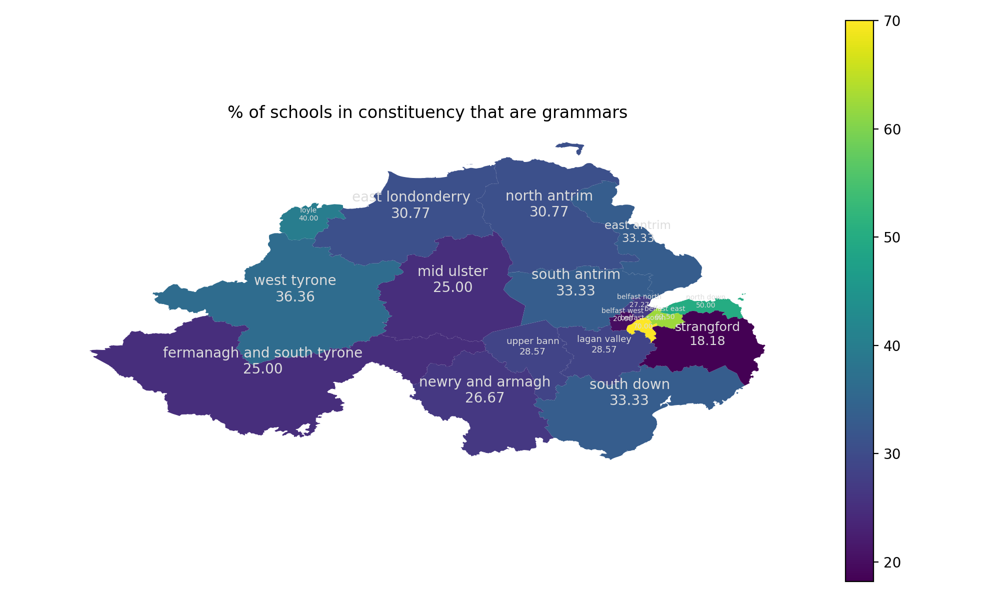

In [197]:
plotmap(cons_gdf, 'grampct', title="% of schools in constituency that are grammars")

<IPython.core.display.Javascript object>


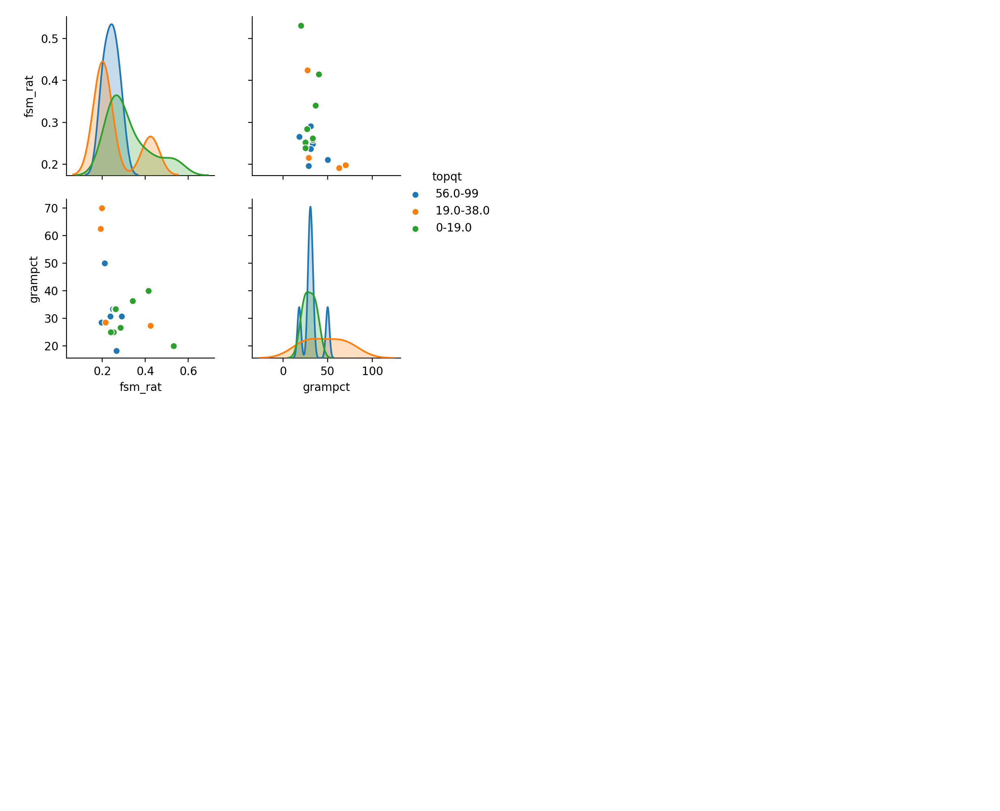

In [198]:
allowed_list = ['grampct']
cons_gdf_2016 = cons_gdf[[c for c in cons_gdf.columns if '2016' in c or c in allowed_list ]].rename(columns=unyearify)

sns.pairplot(data=cons_gdf_2016, hue='topqt',
             vars=['fsm_rat','grampct'])

<IPython.core.display.Javascript object>


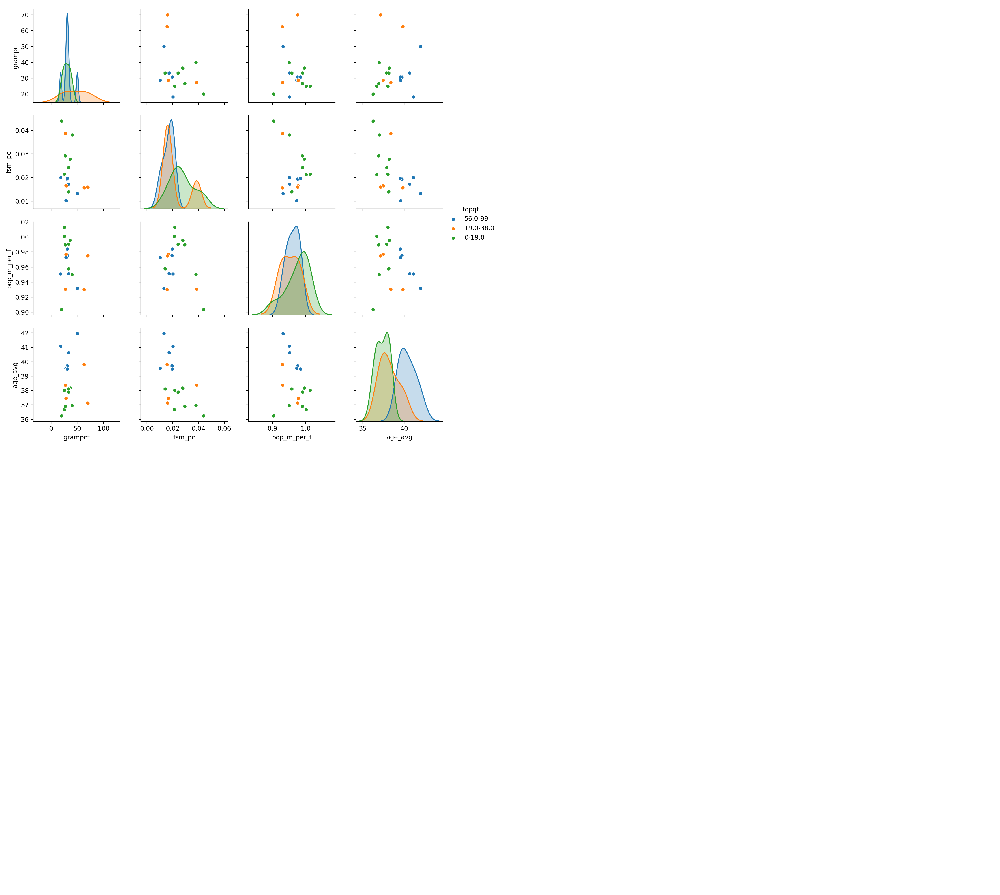

In [199]:
sns.pairplot(data=cons_gdf_2016, hue='topqt',
             vars=['grampct','fsm_pc','pop_m_per_f','age_avg'])

# Conclusions
## Hypotheses / conjectures
* East Antrim Constituency is literally 'little britain'
* None wants to go to school in West Belfast for some reason
* Everyone wants to go to school in North Down
* The 'places' scandal is either over blown, or more related to 'preference'
* There is a demographic wave of <11's that is gonna hit education system in 2 years. Good luck.
* South Belfast steals all-the-18-year-olds, keeps em for a decade or so and then the go home
* Foyle has been experiencing a sustained brain drain of < 35's that is now impacting services
* Grammar School percentage doesn't really have any interesting correlations, but generally, negative inversion with FSM

## Final Comments
* Data is hard
* Open Data is hard without a budget or angry/pedantic consumers
* 80/20 rule is more like 90/10

# Idiots Guide to (Open) Data Science - Thank you

Andrew Bolster 
* [bolster.online](https://bolster.online)
* Tweets [@bolster](https://twitter.bolster.online)
* GitHubs at [andrewbolster](https://github.com/andrewbolster)
* Works at [AlertLogic](https://alertlogic.com) **We're hiring Threat/Exploit Researchers** (Placements also available)
* Plays at [Farset Labs](https://www.farsetlabs.org.uk)
* **[THIS NOTEBOOK IS AT present.bolster.online](http://present.bolster.online)**
* [Also available in source at presentgh.bolster.online](http://presentgh.bolster.online)